In [ ]:
import tensorflow as tf
if tf.config.list_physical_devices('GPU'):
    print("GPU is available.")
else:
    print("GPU is NOT available.")

GPU is available.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import torch
import torchvision.transforms as transforms
from torchvision import datasets
from torch.utils.data import DataLoader
from transformers import ViTForImageClassification, ViTFeatureExtractor
import torch.nn as nn
import torch.optim as optim
from transformers import ViTForImageClassification, ViTFeatureExtractor
from transformers import AutoFeatureExtractor, AutoModelForImageClassification, TrainingArguments, Trainer


In [ ]:
# Define paths
train_dir = '/content/drive/MyDrive/kidney/dataset/train/'

# Define transformations
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Swin model expects 224x224 images
    transforms.ToTensor(),
    transforms.Normalize((0.6, 0.5, 0.6), (0.5, 0.6, 0.5))
])

# Load dataset
train_dataset = datasets.ImageFolder(root=train_dir, transform=transform)


# Define data loaders
train_dataloader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=4)



/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


In [ ]:
total_images = len(train_dataset)
print(f"Total number of images in test dataset: {total_images}")

Total number of images in test dataset: 4390


In [ ]:
(train_dataset.classes)

['Cyst', 'Normal', 'Stone', 'Tumor']

In [ ]:
model_name = "facebook/deit-base-patch16-224"
model = AutoModelForImageClassification.from_pretrained(
    model_name,
    num_labels=len(train_dataset.classes),
    ignore_mismatched_sizes=True  # Ignore size mismatches in the model
)
feature_extractor = AutoFeatureExtractor.from_pretrained(model_name)


Some weights of ViTForImageClassification were not initialized from the model checkpoint at facebook/deit-base-patch16-224 and are newly initialized because the shapes did not match:
- classifier.weight: found shape torch.Size([1000, 768]) in the checkpoint and torch.Size([4, 768]) in the model instantiated
- classifier.bias: found shape torch.Size([1000]) in the checkpoint and torch.Size([4]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [ ]:
feature_extractor

ViTFeatureExtractor {
  "do_normalize": true,
  "do_rescale": true,
  "do_resize": true,
  "image_mean": [
    0.5,
    0.5,
    0.5
  ],
  "image_processor_type": "ViTFeatureExtractor",
  "image_std": [
    0.5,
    0.5,
    0.5
  ],
  "resample": 2,
  "rescale_factor": 0.00392156862745098,
  "size": {
    "height": 224,
    "width": 224
  }
}

In [ ]:
num_classes = len(train_dataset.classes)
model.classifier = nn.Linear(model.config.hidden_size, num_classes)



In [ ]:
num_classes

4

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Define loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-4)

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim

# Hyperparameters
learning_rate = 1e-4          # Learning rate
num_epochs = 5                # Number of training epochs
batch_size = 32               # Batch size
momentum = 0.9                # Momentum for optimizer
weight_decay = 1e-5           # Weight decay for regularization
num_classes = len(train_dataset.classes)  # Number of classes
loss_function = 'CrossEntropy'  # Use CrossEntropy for classification

# Initialize lists to store loss and accuracy
los = []
train_accuracy = []

# Set up the loss function and optimizer
if loss_function == 'MSE':  # If MSE is needed for regression
    criterion = nn.MSELoss()
else:  # Default to CrossEntropyLoss for classification
    criterion = nn.CrossEntropyLoss()

optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=weight_decay)

# Training loop
model.train()  # Set model to training mode
for epoch in range(num_epochs):
    running_loss = 0.0
    correct_predictions = 0
    total_samples = 0

    for inputs, labels in train_dataloader:
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)  # Model outputs logits
        loss = criterion(outputs.logits, labels)  # Use CrossEntropyLoss which expects logits and class indices
        loss.backward()
        optimizer.step()

        running_loss += loss.item() * inputs.size(0)

        # Calculate accuracy
        _, preds = torch.max(outputs.logits, 1)
        correct_predictions += torch.sum(preds == labels).item()
        total_samples += labels.size(0)

    epoch_loss = running_loss / len(train_dataloader.dataset)
    epoch_accuracy = correct_predictions / total_samples

    # Print loss and accuracy for the current epoch
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {epoch_loss:.4f}, Accuracy: {epoch_accuracy:.4f}")

    # Append loss and accuracy to the lists
    los.append(epoch_loss)
    train_accuracy.append(epoch_accuracy)


Epoch 1/5, Loss: 0.1088, Accuracy: 0.9588
Epoch 2/5, Loss: 0.0004, Accuracy: 1.0000
Epoch 3/5, Loss: 0.0001, Accuracy: 1.0000
Epoch 4/5, Loss: 0.0001, Accuracy: 1.0000
Epoch 5/5, Loss: 0.0001, Accuracy: 1.0000


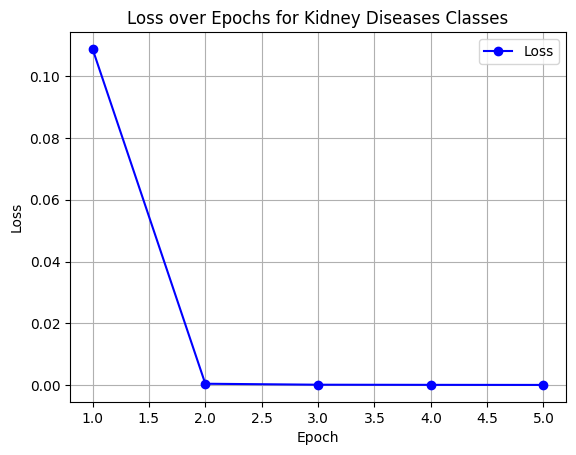

In [ ]:
import matplotlib.pyplot as plt


# Number of epochs
epochs = list(range(1, len(los) + 1))

# Plot the loss values
plt.plot(epochs, los, marker='o', linestyle='-', color='b', label='Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss over Epochs for Kidney Diseases Classes')
plt.legend()
plt.grid(True)
plt.show()

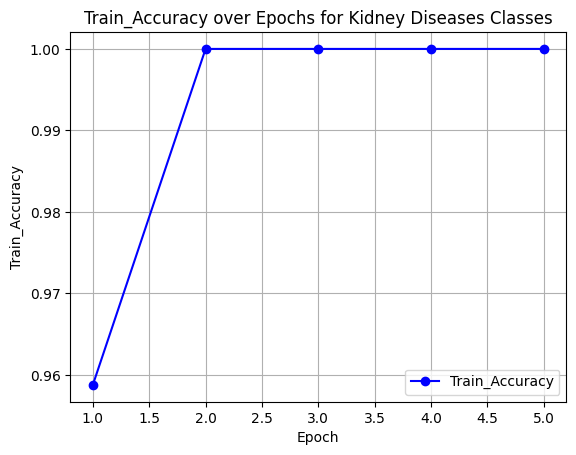

In [ ]:
import matplotlib.pyplot as plt


# Number of epochs
epochs = list(range(1, len(train_accuracy) + 1))

# Plot the loss values
plt.plot(epochs, train_accuracy, marker='o', linestyle='-', color='b', label='Train_Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Train_Accuracy')
plt.title('Train_Accuracy over Epochs for Kidney Diseases Classes')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
test_dir = '/content/drive/MyDrive/kidney/dataset/test/'
test_dataset = datasets.ImageFolder(root=test_dir, transform=transform)
test_dataloader = DataLoader(test_dataset, batch_size=32, shuffle=False, num_workers=4)


In [ ]:
total_images = len(test_dataset)
print(f"Total number of images in test dataset: {total_images}")

Total number of images in test dataset: 2463


1
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9998970031738281
True Prediction
2
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9998633861541748
True Prediction
3
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9998829364776611
True Prediction
4
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9998847246170044
True Prediction
5
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9998925924301147
True Prediction
6
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9998577833175659
True Prediction
7
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9998133778572083
True Prediction
8
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9997919201850891
True Prediction
9
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9998456239700317
True Prediction
10
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9999082088470459
True Prediction
11
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.999922513961792
True Prediction
12
Actual

33
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9998670816421509
True Prediction
34
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9066904187202454


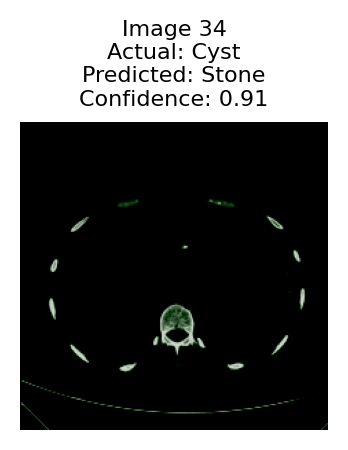

35
Actual label: Cyst
Predicted label: Stone
Confidence: 0.8443267345428467


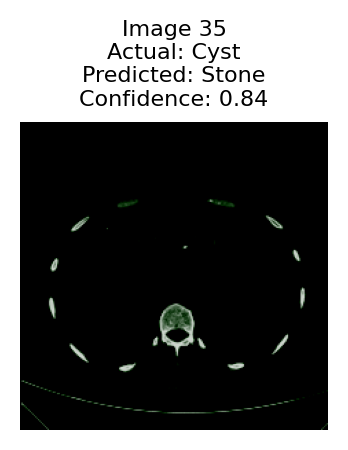

36
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9213656783103943


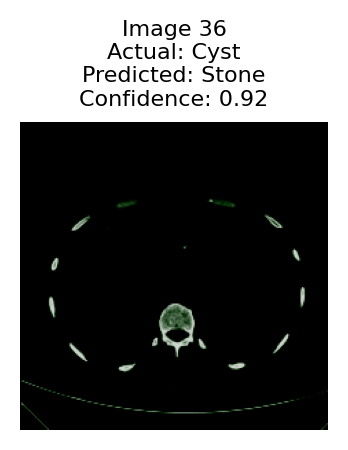

37
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9492872953414917


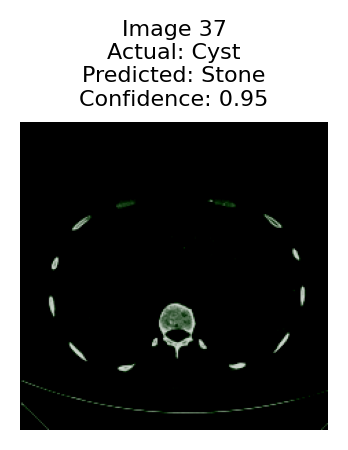

38
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9510619640350342


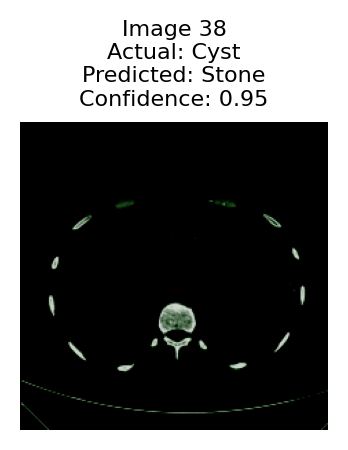

39
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9390936493873596


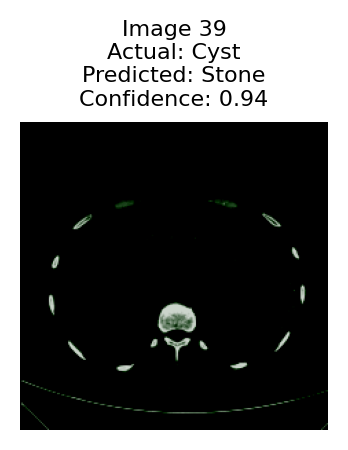

40
Actual label: Cyst
Predicted label: Stone
Confidence: 0.957994282245636


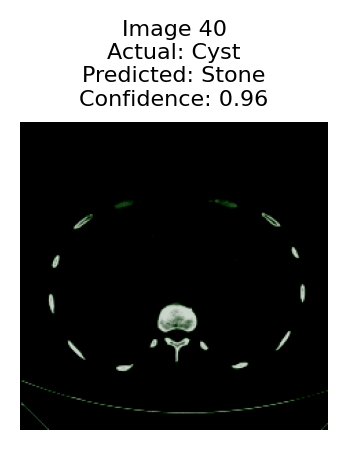

41
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9636350870132446


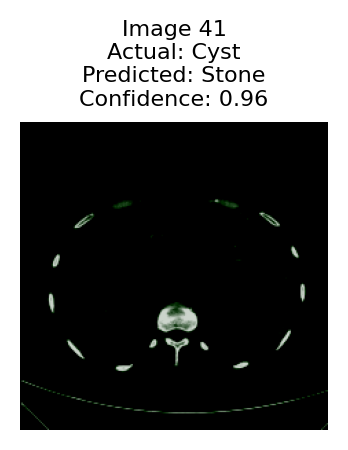

42
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9836925268173218


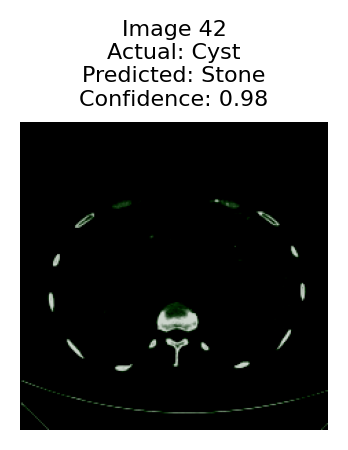

43
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9906927943229675


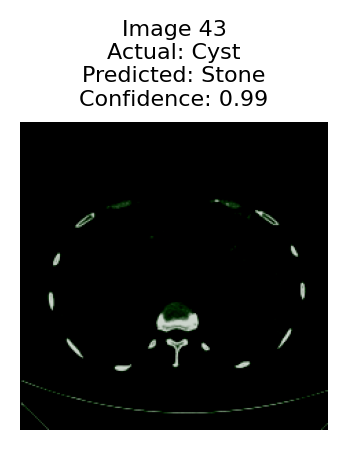

44
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9628454446792603


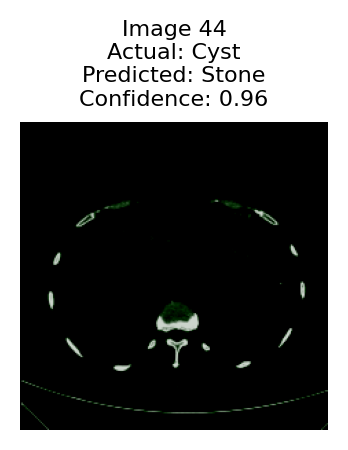

45
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9193023443222046


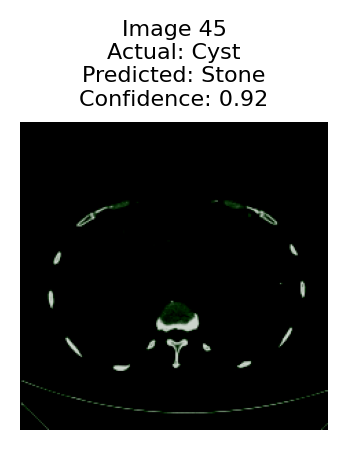

46
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9300953149795532


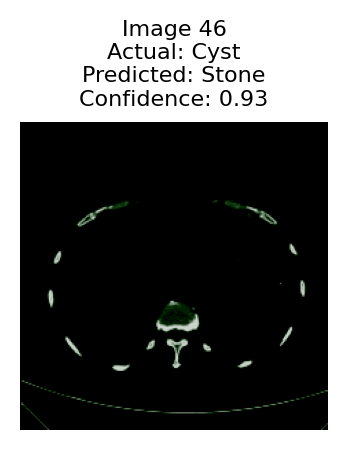

47
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9728345274925232


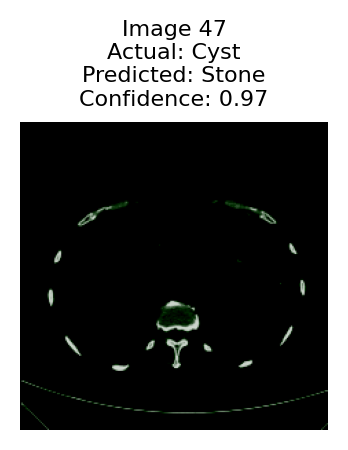

48
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.999823272228241
True Prediction
49
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9996815919876099
True Prediction
50
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.999606192111969
True Prediction
51
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9996403455734253
True Prediction
52
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9996405839920044
True Prediction
53
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9996223449707031
True Prediction
54
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9997524619102478
True Prediction
55
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9998329877853394
True Prediction
56
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9998561143875122
True Prediction
57
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9998192191123962
True Prediction
58
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9996613264083862
True Prediction
5

97
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.931357741355896
True Prediction
98
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9758557081222534
True Prediction
99
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9795976281166077
True Prediction
100
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9213932156562805
True Prediction
101
Actual label: Cyst
Predicted label: Stone
Confidence: 0.5708668231964111


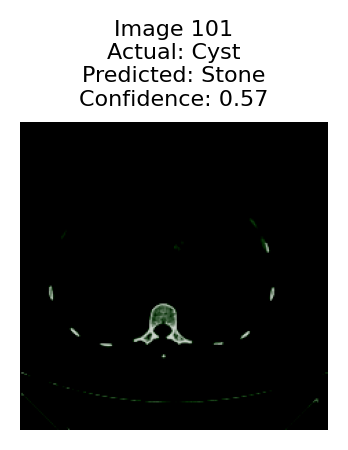

102
Actual label: Cyst
Predicted label: Stone
Confidence: 0.6334902048110962


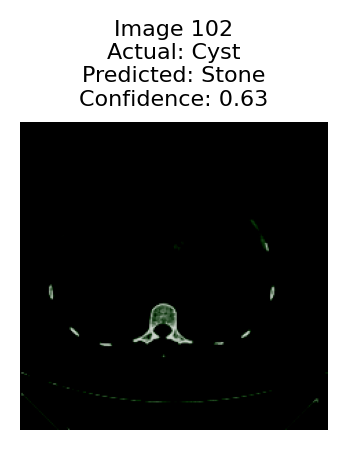

103
Actual label: Cyst
Predicted label: Stone
Confidence: 0.5809763073921204


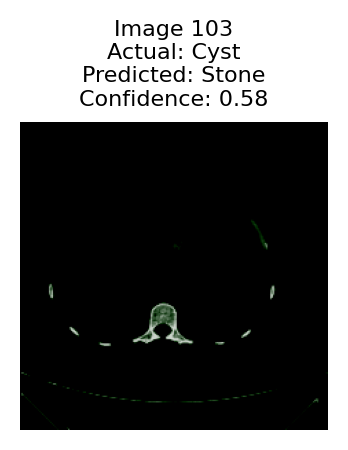

104
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.6988654732704163
True Prediction
105
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.5687124729156494
True Prediction
106
Actual label: Cyst
Predicted label: Stone
Confidence: 0.6644702553749084


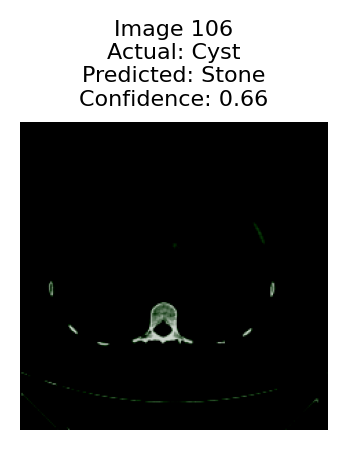

107
Actual label: Cyst
Predicted label: Stone
Confidence: 0.8867929577827454


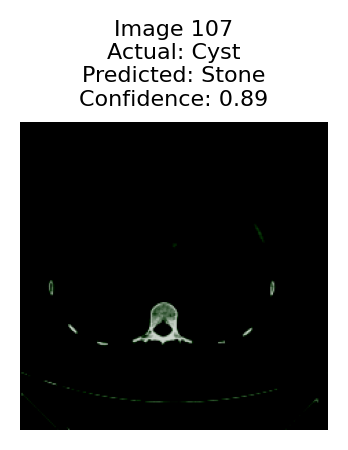

108
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9892338514328003


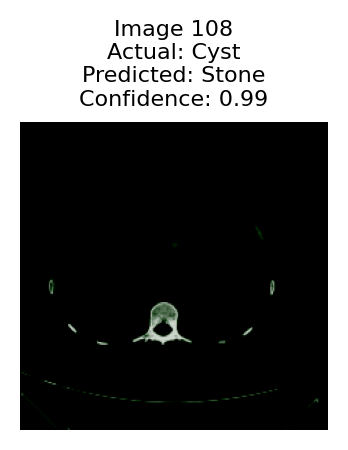

109
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9942494630813599


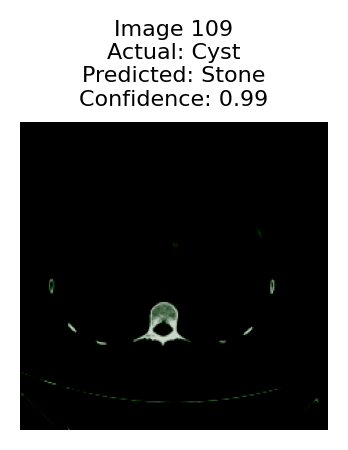

110
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9963212013244629


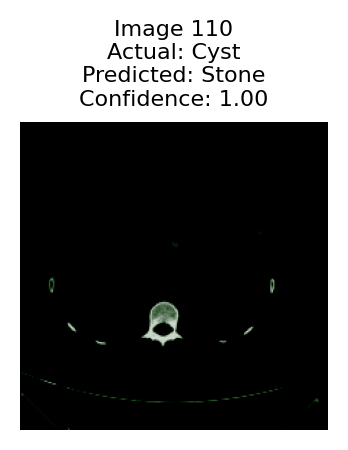

111
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9955713152885437


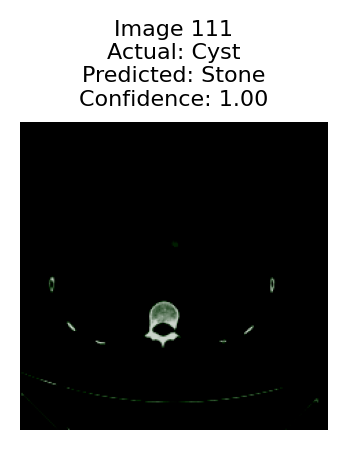

112
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9974362254142761


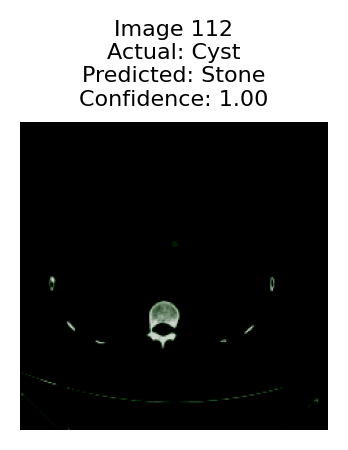

113


Actual label: Cyst
Predicted label: Stone
Confidence: 0.9977577328681946


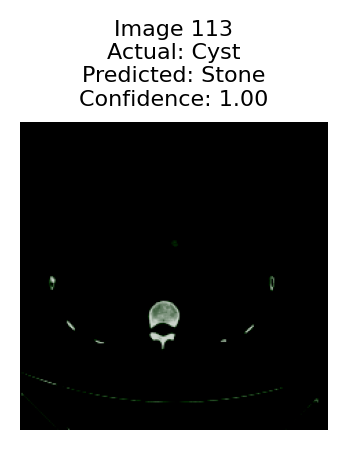

114
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9956809282302856


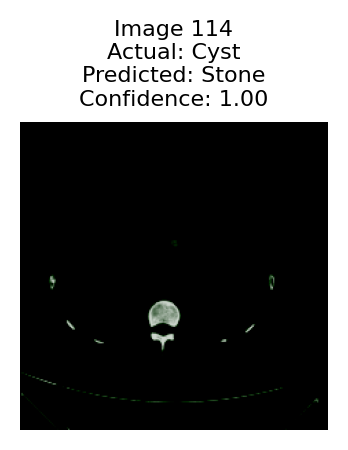

115
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9872536063194275


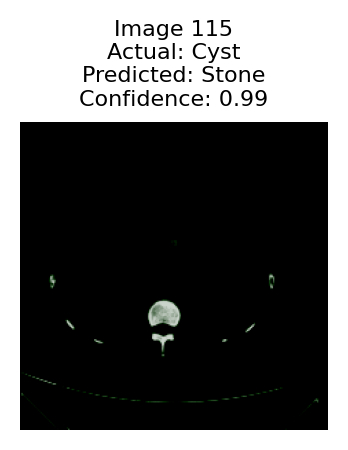

116
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9538577795028687


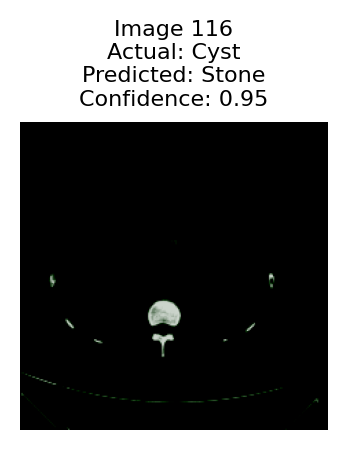

117
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9045130610466003


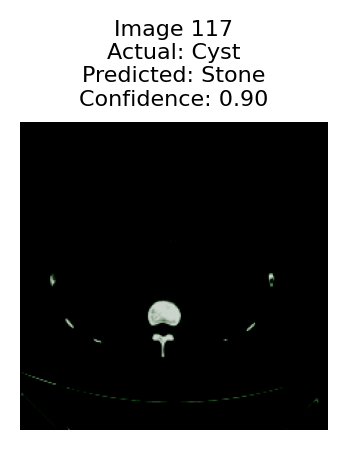

118
Actual label: Cyst
Predicted label: Stone
Confidence: 0.6948193907737732


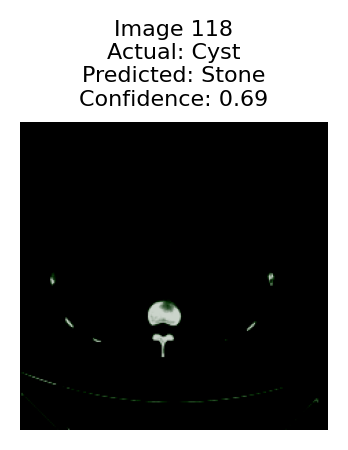

119
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.7342283129692078
True Prediction
120
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9313039779663086
True Prediction
121
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9650155305862427
True Prediction
122
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.8859573006629944
True Prediction
123
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9735918045043945
True Prediction
124
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.97945237159729
True Prediction
125
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9968364238739014
True Prediction
126
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.993700385093689
True Prediction
127
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9893665909767151
True Prediction
128
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9888900518417358
True Prediction


129
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9976713061332703
True Prediction
130
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9984476566314697
True Prediction
131
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9906908273696899
True Prediction
132
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9877482652664185
True Prediction
133
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9972028732299805
True Prediction
134
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9983572363853455
True Prediction
135
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9989525079727173
True Prediction
136
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.998502254486084
True Prediction
137
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9988062381744385
True Prediction
138
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9991198182106018
True Prediction
139
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9988313317298889
True 

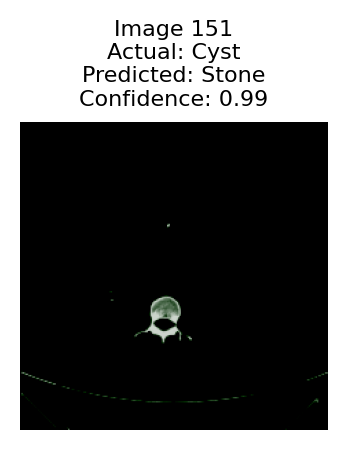

152
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9960381984710693


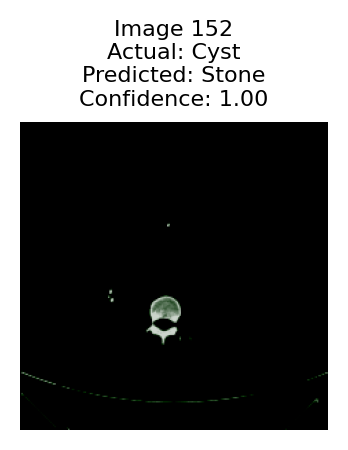

153
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9831113815307617


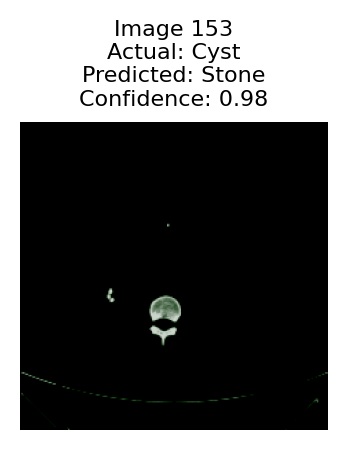

154
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9614579081535339


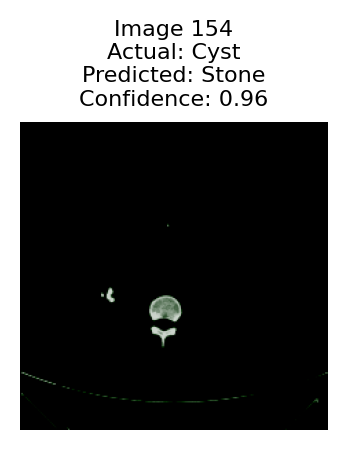

155
Actual label: Cyst
Predicted label: Stone
Confidence: 0.985626757144928


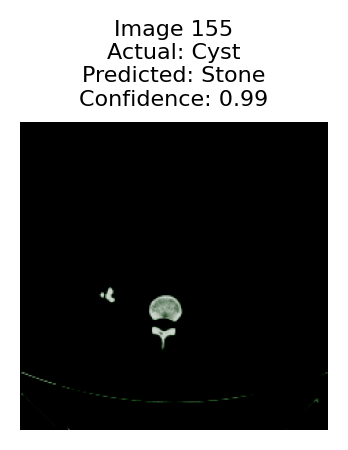

156
Actual label: Cyst


Predicted label: Stone
Confidence: 0.9838594198226929


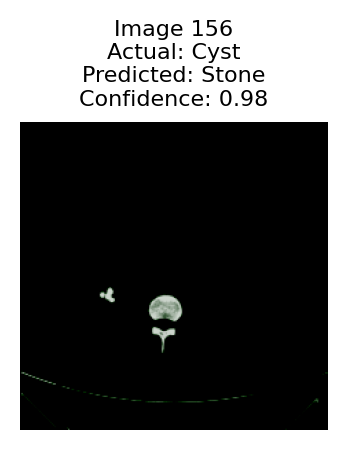

157
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9720758199691772


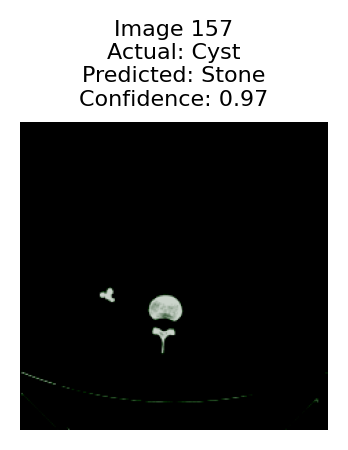

158
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9597169756889343


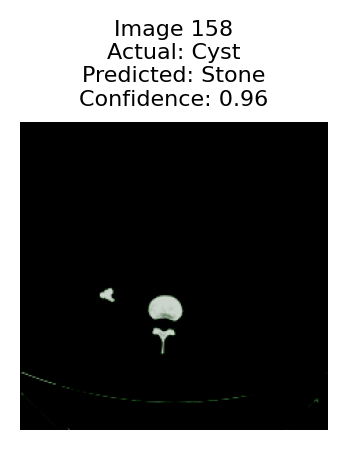

159
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9737893342971802


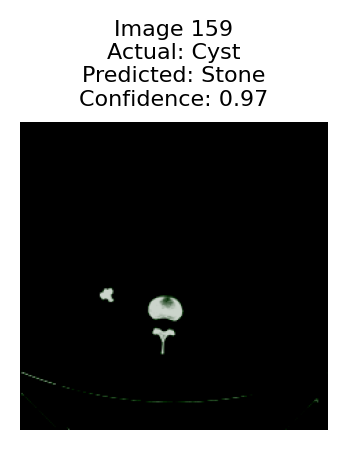

160
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9781144857406616


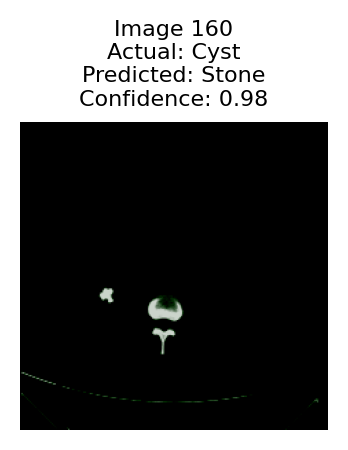

161
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9910598397254944


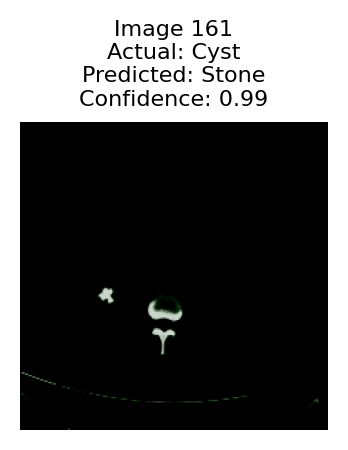

162
Actual label: Cyst
Predicted label: Stone
Confidence: 0.995241641998291


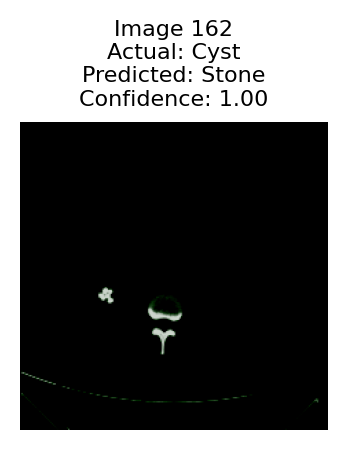

163
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9952329993247986


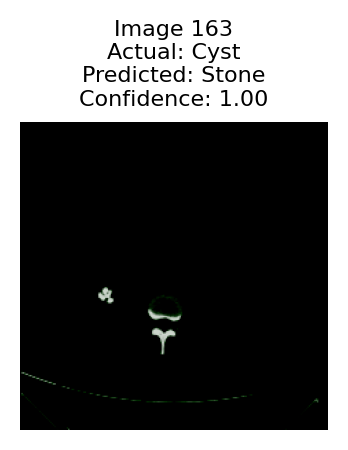

164
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9904218912124634


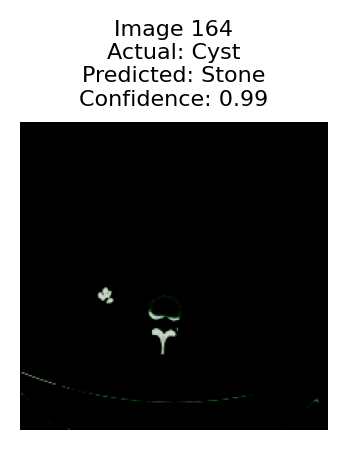

165
Actual label: Cyst
Predicted label: Stone
Confidence: 0.915492057800293


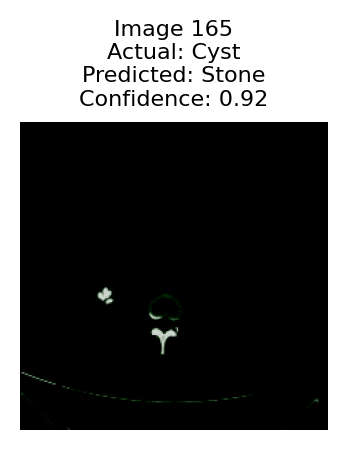

166
Actual label: Cyst
Predicted label: Stone
Confidence: 0.5145238637924194


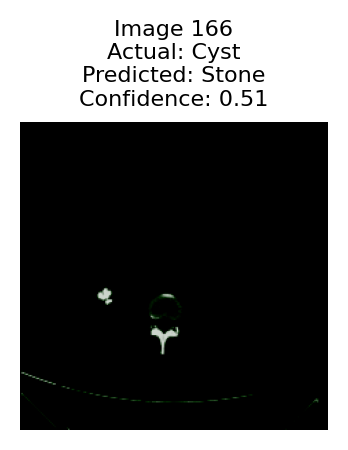

167
Actual label: Cyst
Predicted label: Stone
Confidence: 0.5870678424835205


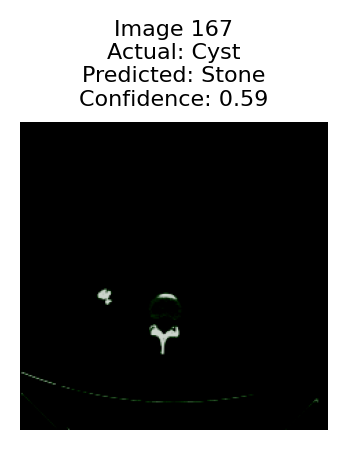

168
Actual label: Cyst
Predicted label: Stone
Confidence: 0.6950564384460449


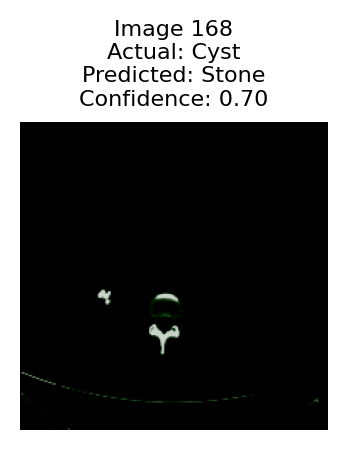

169
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.667107880115509
True Prediction
170
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9000170230865479
True Prediction
171
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9742364287376404
True Prediction
172
Actual label: Cyst
Predicted label: Stone
Confidence: 0.5244040489196777


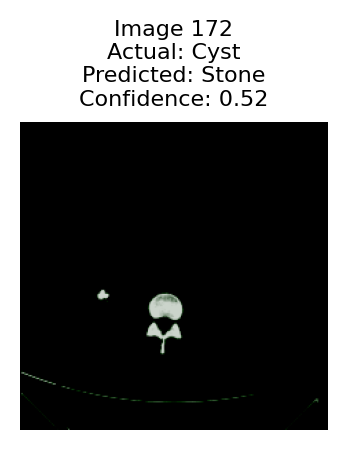

173
Actual label: Cyst
Predicted label: Stone
Confidence: 0.5165911912918091


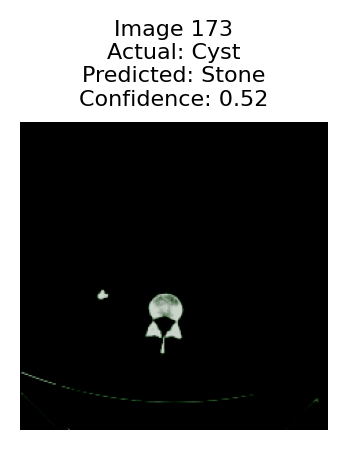

174
Actual label: Cyst
Predicted label: Stone
Confidence: 0.8812760710716248


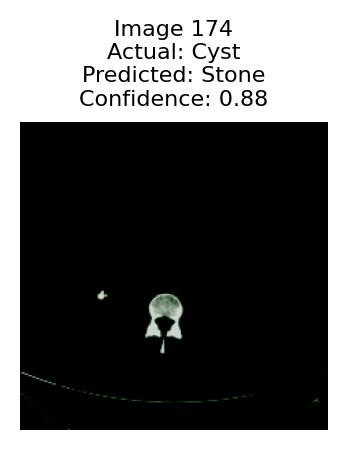

175
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9896358847618103


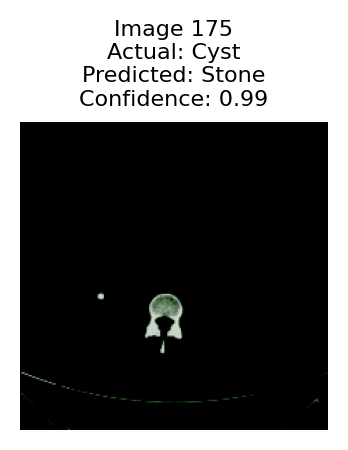

176
Actual label: Cyst
Predicted label: Stone
Confidence: 0.971318781375885


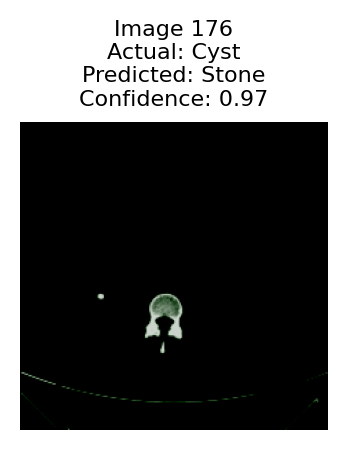

177
Actual label: Cyst
Predicted label: Stone
Confidence: 0.8652290105819702


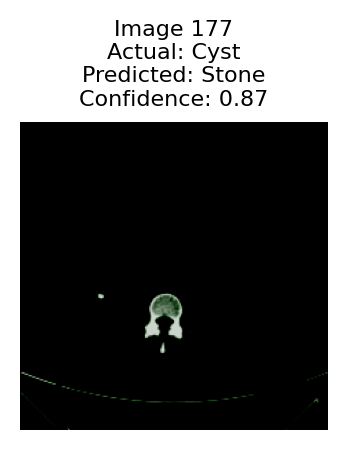

178
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.5792722105979919
True Prediction
179
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9956839084625244
True Prediction
180
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9996084570884705
True Prediction
181
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9992793202400208
True Prediction
182
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.996656060218811
True Prediction
183
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9826048016548157
True Prediction
184
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9816862344741821
True Prediction
185
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9953653812408447
True Prediction
186
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9901881814002991
True Prediction
187
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9854551553726196
True Prediction
188
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9914553761482239
True 

225
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9997281432151794
True Prediction
226
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9997401833534241
True Prediction
227
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9996346235275269
True Prediction
228
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9995228052139282
True Prediction
229
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9994509816169739
True Prediction
230
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.999488353729248
True Prediction
231
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9993506073951721
True Prediction
232
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9993941783905029
True Prediction
233
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9991298317909241
True Prediction
234
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9978944659233093
True Prediction
235
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9863787889480591
True 

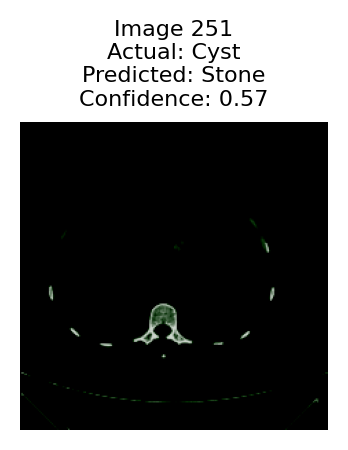

252
Actual label: Cyst
Predicted label: Stone
Confidence: 0.6334902048110962


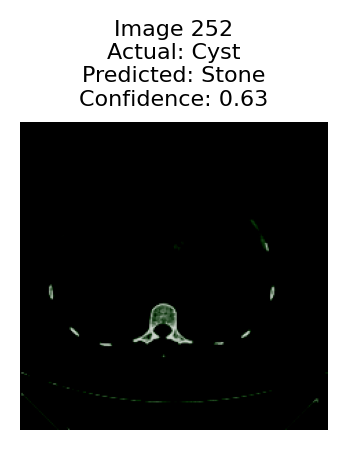

253
Actual label: Cyst
Predicted label: Stone
Confidence: 0.5809763073921204


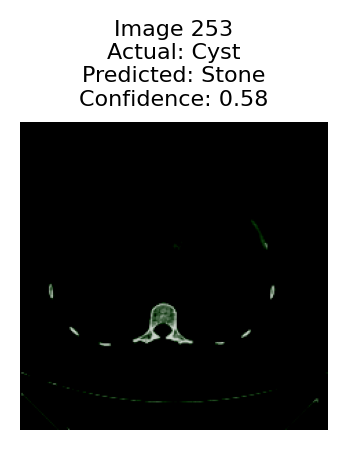

254
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.6988654732704163
True Prediction
255
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.5687124729156494
True Prediction
256
Actual label: Cyst
Predicted label: Stone
Confidence: 0.6644702553749084


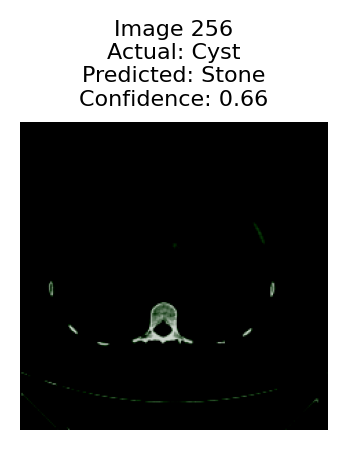

257
Actual label: Cyst
Predicted label: Stone
Confidence: 0.8867929577827454


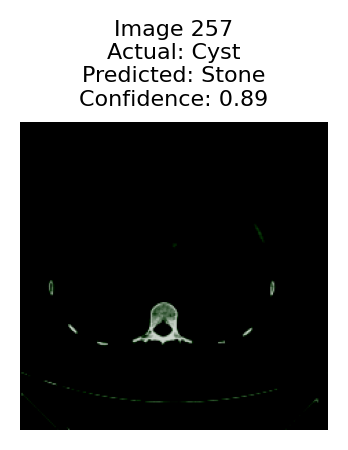

258
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9892338514328003


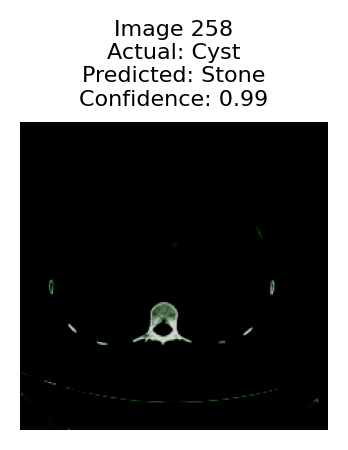

259
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9942494630813599


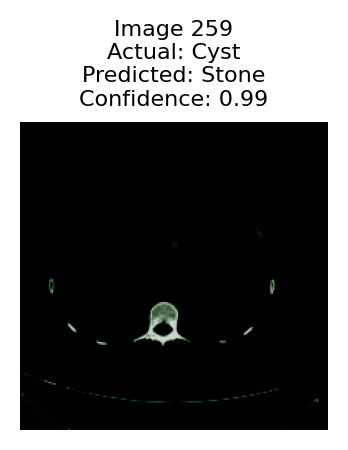

260
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9963212013244629


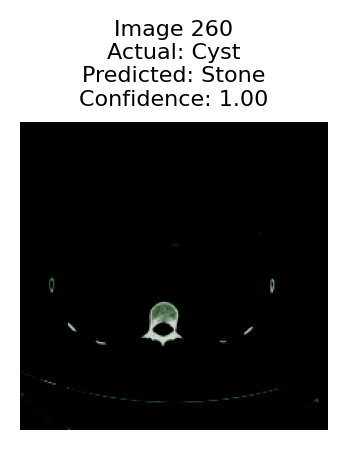

261
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9955713152885437


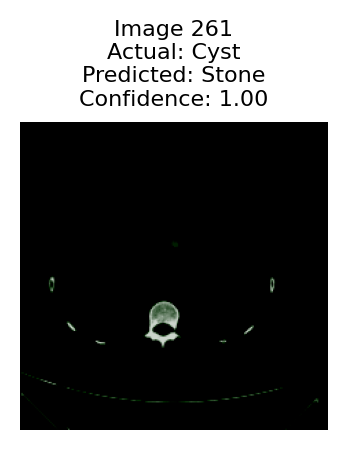

262
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9974362254142761


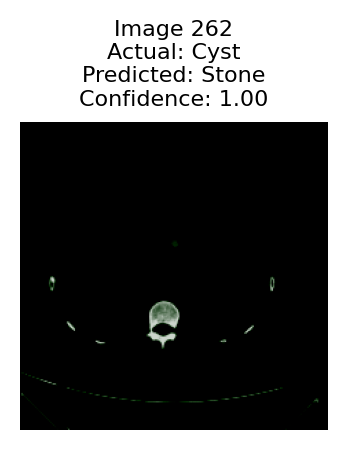

263
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9977577328681946


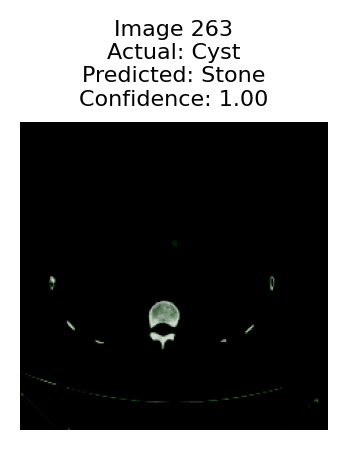

264
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9956809282302856


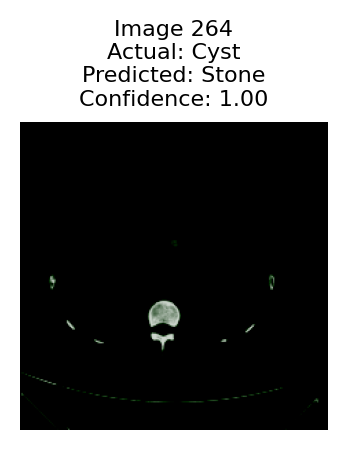

265
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9872536063194275


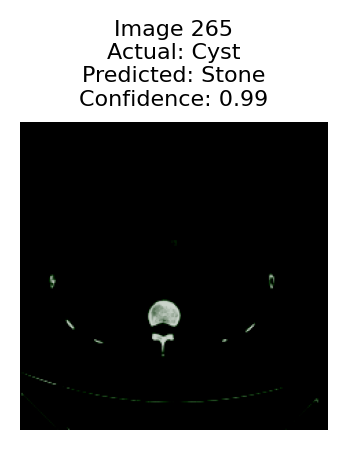

266
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9538577795028687


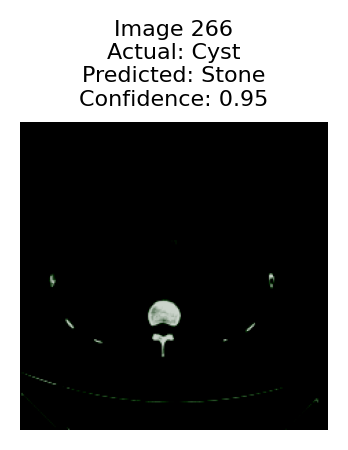

267
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9045130610466003


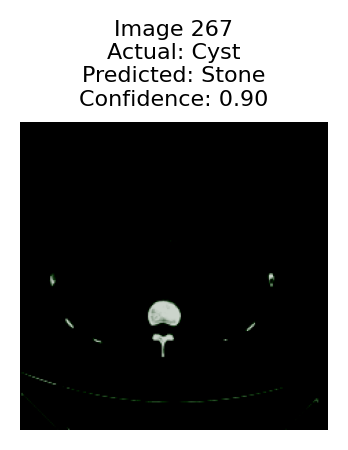

268
Actual label: Cyst
Predicted label: Stone
Confidence: 0.6948193907737732


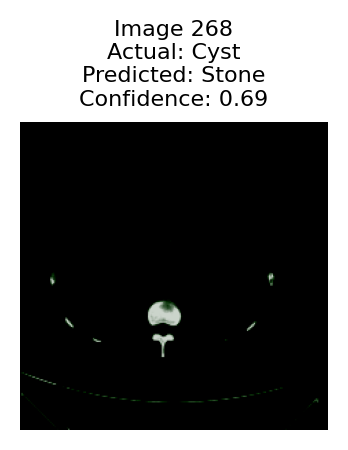

269
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.7342283129692078
True Prediction
270
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9313039779663086
True Prediction
271
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9650155305862427
True Prediction
272
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.8859573006629944
True Prediction
273
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9735918045043945
True Prediction
274
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.97945237159729
True Prediction
275
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9968364238739014
True Prediction
276
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.993700385093689
True Prediction
277
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9893665909767151
True Prediction
278
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9888900518417358
True Prediction
279
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9976713061332703
True Pr

289
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9988313317298889
True Prediction
290
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.998475968837738
True Prediction
291
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9985827207565308
True Prediction
292
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.996408998966217
True Prediction
293
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9976414442062378
True Prediction
294
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9955880641937256
True Prediction
295
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9971240162849426
True Prediction
296
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9973932504653931
True Prediction
297
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9978033900260925
True Prediction
298
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9907407760620117
True Prediction
299
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.7399624586105347
True P

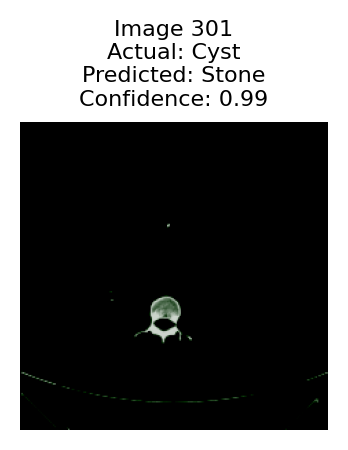

302
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9960381984710693


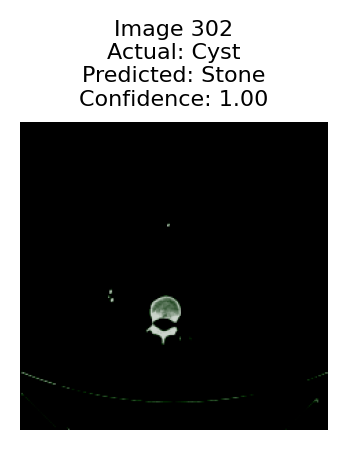

303
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9831113815307617


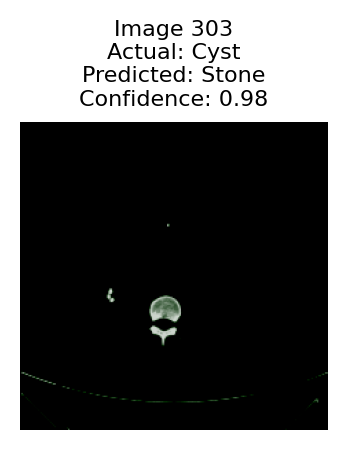

304
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9614579081535339


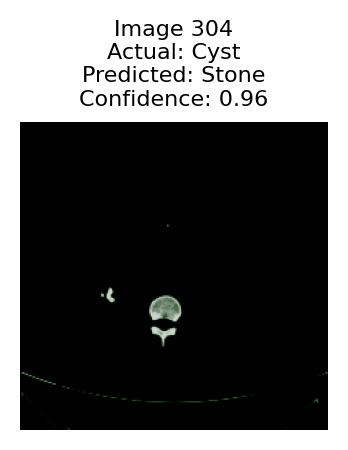

305
Actual label: Cyst
Predicted label: Stone
Confidence: 0.985626757144928


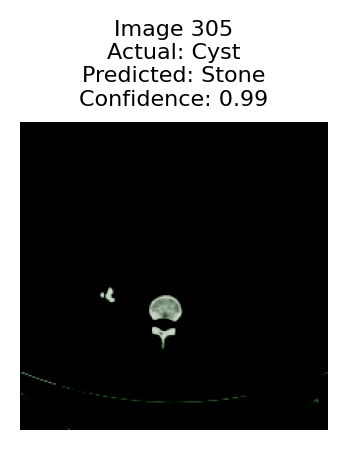

306
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9838594198226929


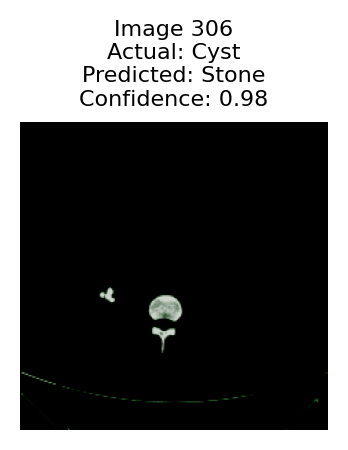

307
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9720758199691772


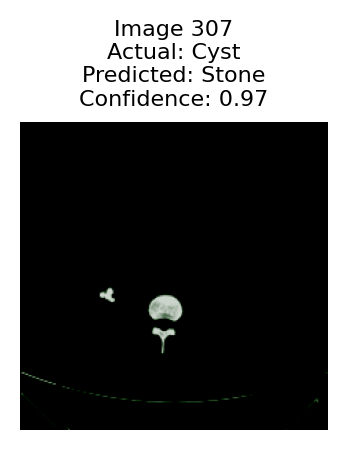

308
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9597169756889343


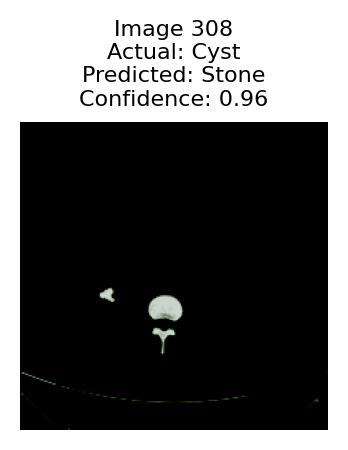

309
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9737893342971802


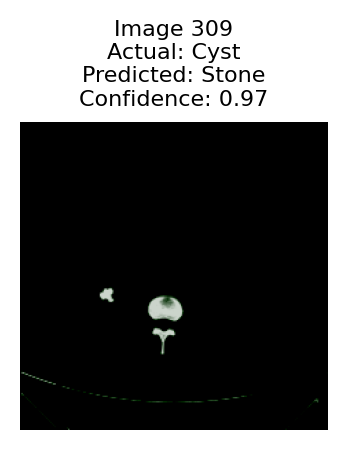

310
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9781144857406616


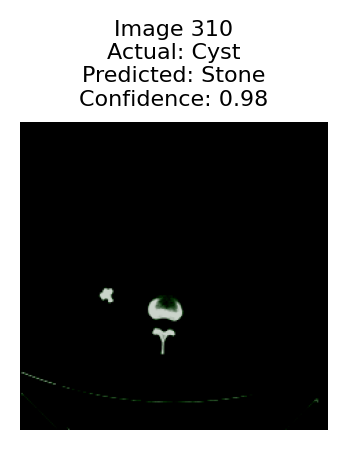

311
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9910598397254944


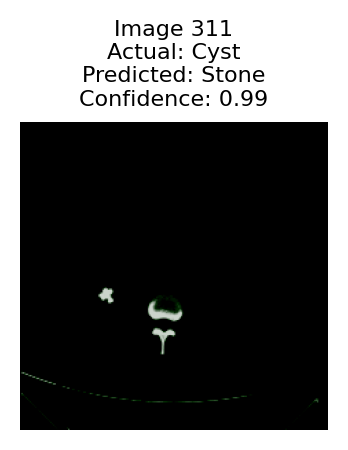

312
Actual label: Cyst
Predicted label: Stone
Confidence: 0.995241641998291


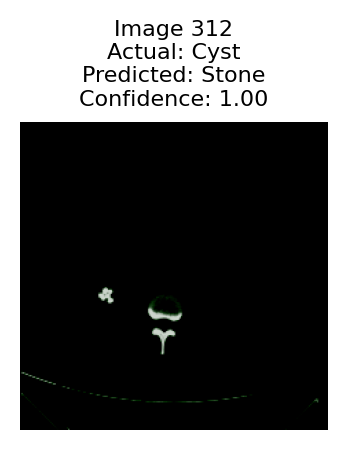

313
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9952329993247986


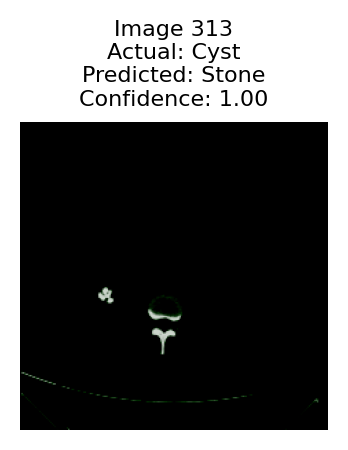

314
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9904218912124634


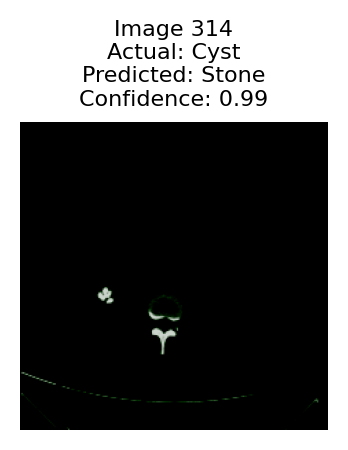

315
Actual label: Cyst
Predicted label: Stone
Confidence: 0.915492057800293


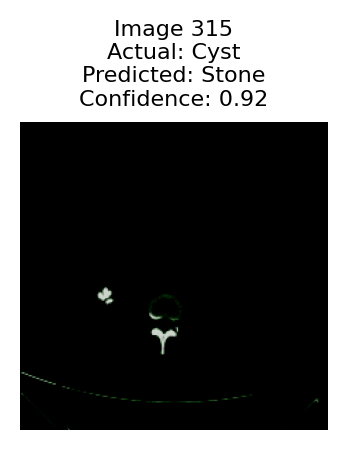

316
Actual label: Cyst
Predicted label: Stone
Confidence: 0.5145238637924194


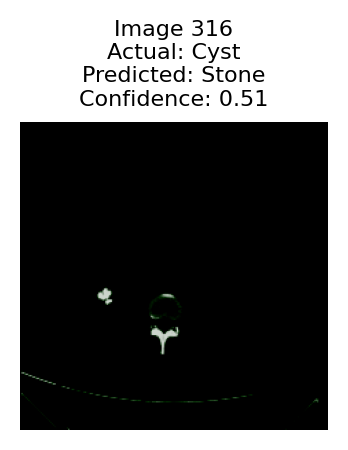

317
Actual label: Cyst
Predicted label: Stone
Confidence: 0.5870678424835205


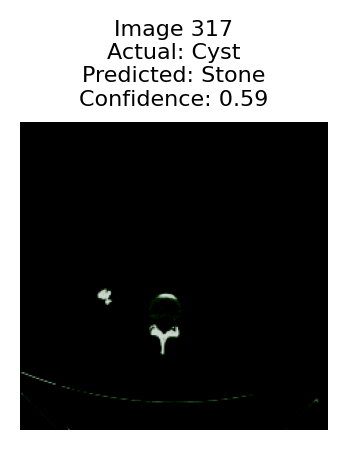

318
Actual label: Cyst
Predicted label: Stone
Confidence: 0.6950564384460449


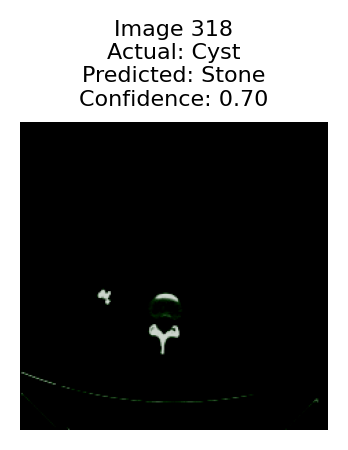

319
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.667107880115509
True Prediction
320
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9000170230865479
True Prediction


321
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9742364287376404
True Prediction
322
Actual label: Cyst
Predicted label: Stone
Confidence: 0.5244040489196777


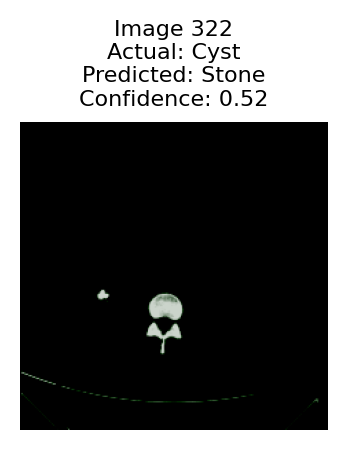

323
Actual label: Cyst
Predicted label: Stone
Confidence: 0.5165911912918091


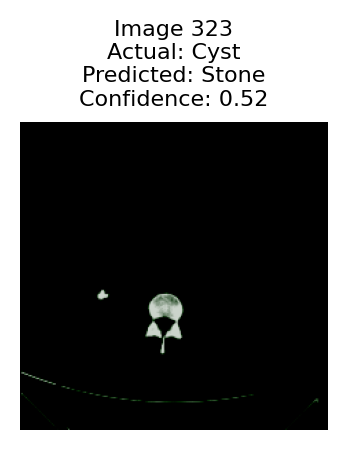

324
Actual label: Cyst
Predicted label: Stone
Confidence: 0.8812760710716248


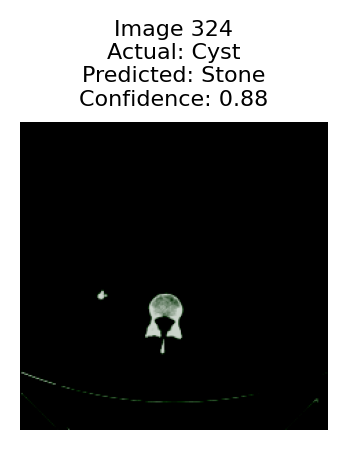

325
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9896358847618103


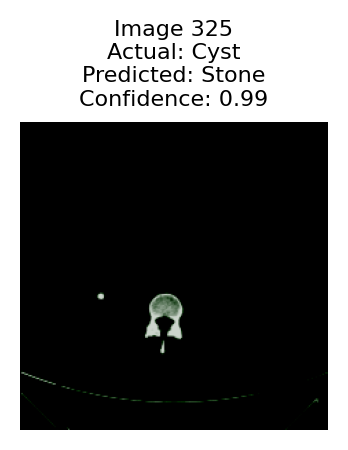

326
Actual label: Cyst
Predicted label: Stone
Confidence: 0.971318781375885


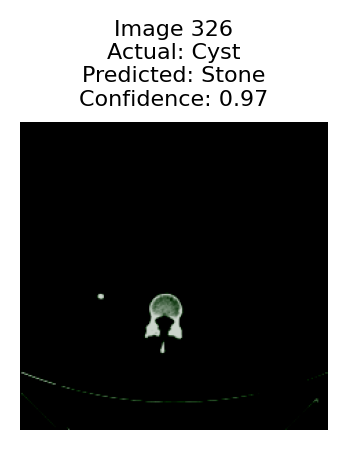

327
Actual label: Cyst
Predicted label: Stone
Confidence: 0.8652290105819702


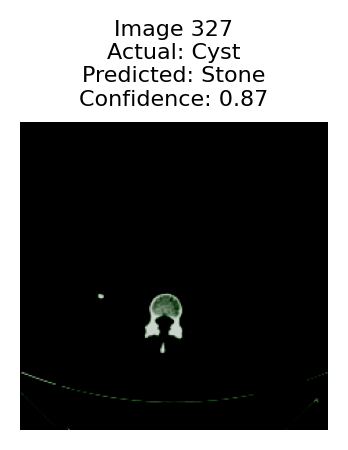

328
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.5792722105979919
True Prediction
329
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9956839084625244
True Prediction
330
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9996084570884705
True Prediction
331
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9992793202400208
True Prediction
332
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.996656060218811
True Prediction
333
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9826048016548157
True Prediction
334
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9816862344741821
True Prediction
335
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9953653812408447
True Prediction
336
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9901881814002991
True Prediction
337
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9854551553726196
True Prediction
338
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9914553761482239
True 

353
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9942368268966675
True Prediction
354
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9952300786972046
True Prediction
355
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.974187970161438
True Prediction
356
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.8438310623168945
True Prediction
357
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9559827446937561
True Prediction
358
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9917786717414856
True Prediction
359
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9956433773040771
True Prediction
360
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.8982338905334473
True Prediction
361
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9114459753036499
True Prediction
362
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9182328581809998
True Prediction
363
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9657667875289917
True 

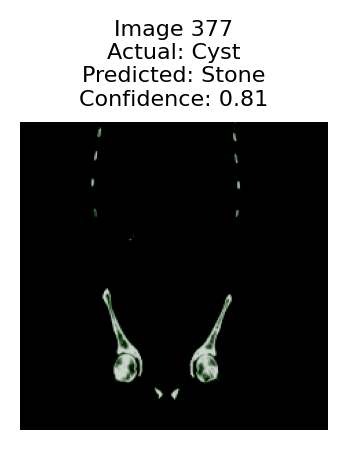

378
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9990604519844055


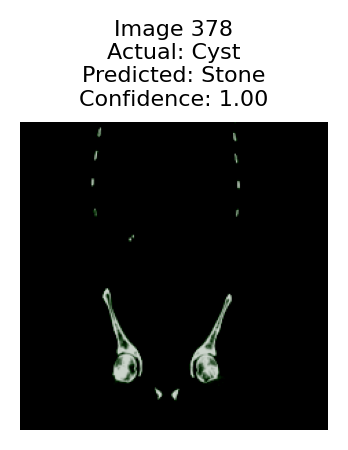

379
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9987013339996338


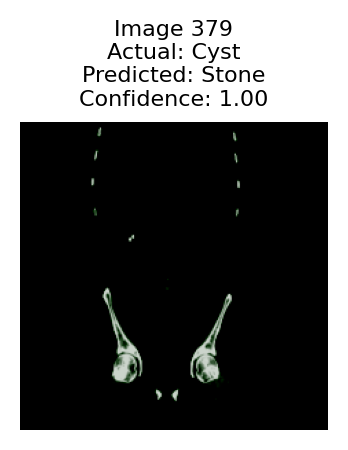

380
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9970550537109375


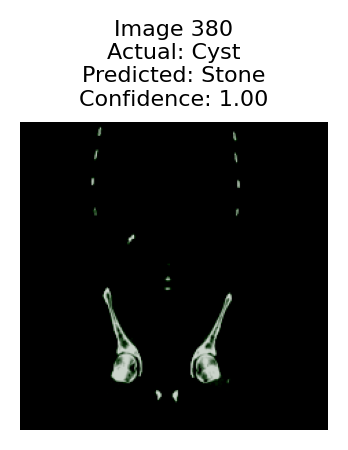

381
Actual label: Cyst
Predicted label: Stone
Confidence: 0.99436354637146


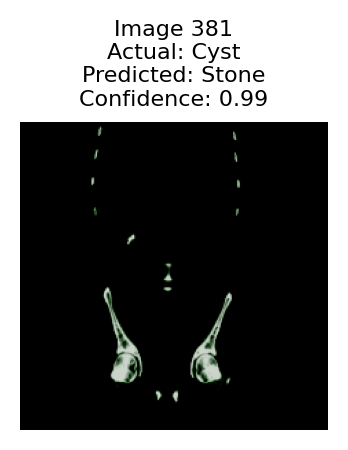

382
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9975771307945251


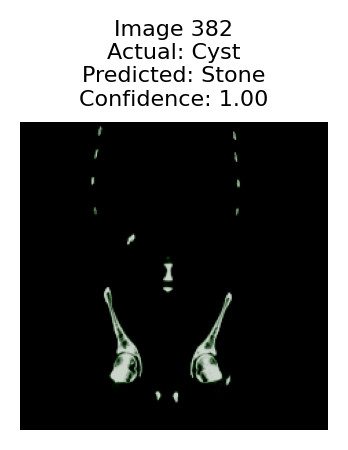

383
Actual label: Cyst
Predicted label: Stone
Confidence: 0.99882572889328


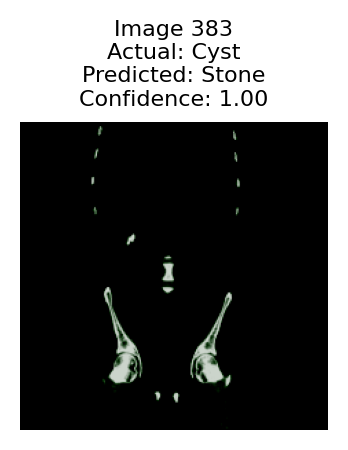

384
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9993441700935364


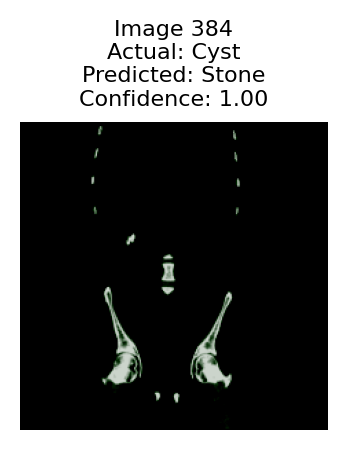

385
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9986640214920044


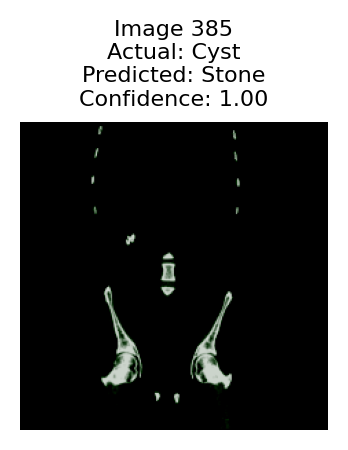

386
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9994239807128906


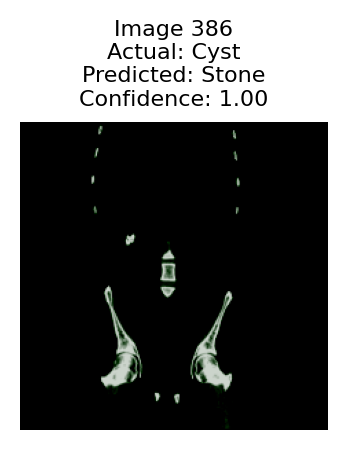

387
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9992163181304932


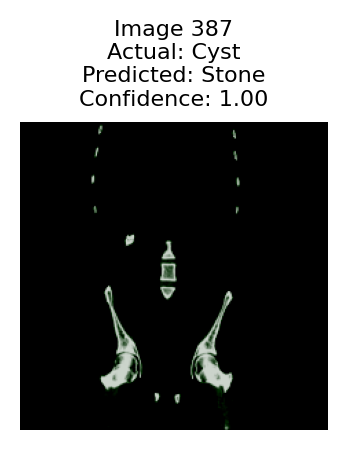

388
Actual label: Cyst
Predicted label: Stone
Confidence: 0.999319314956665


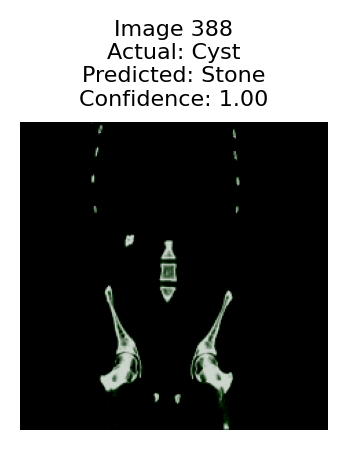

389
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9996132254600525


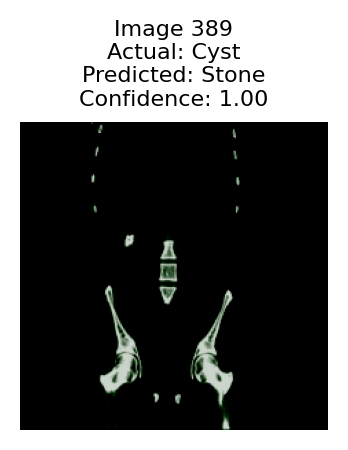

390
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9997096657752991


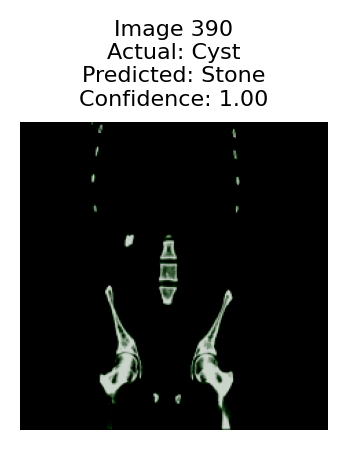

391
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9997928738594055


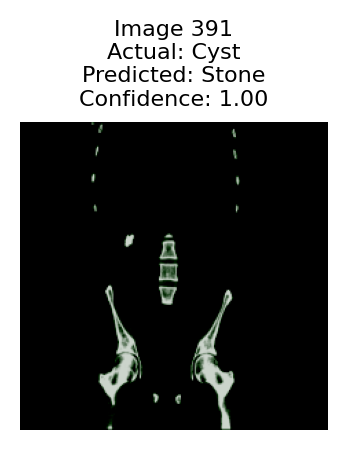

392
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9998692274093628


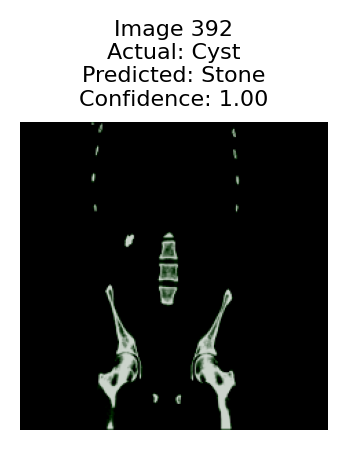

393
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9998218417167664


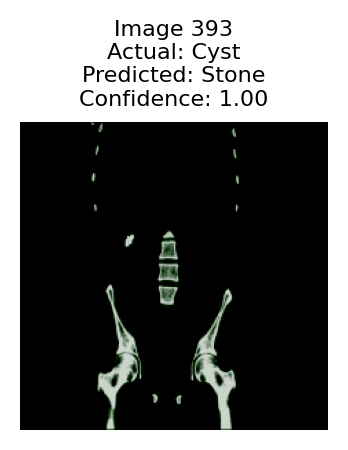

394
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9998273253440857


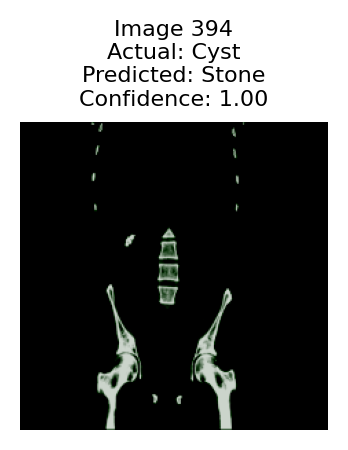

395
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9998447895050049


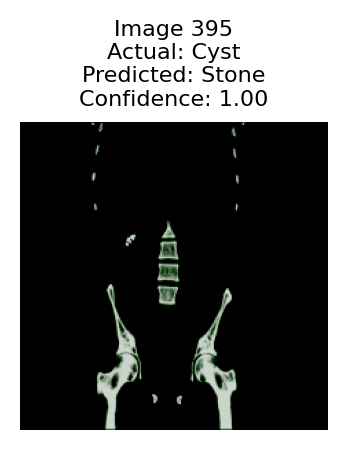

396
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9998652935028076


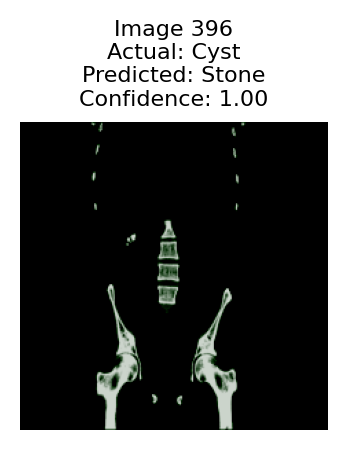

397
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9998997449874878


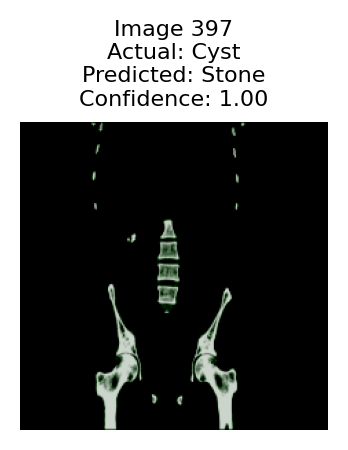

398
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9997844099998474


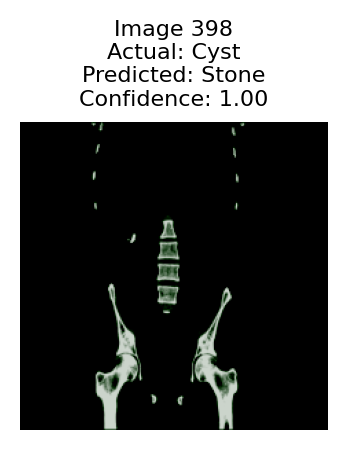

399
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9997401833534241


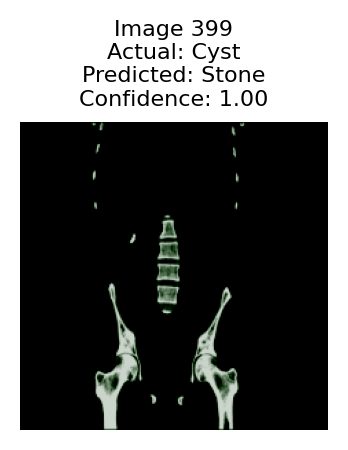

400
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9998379945755005


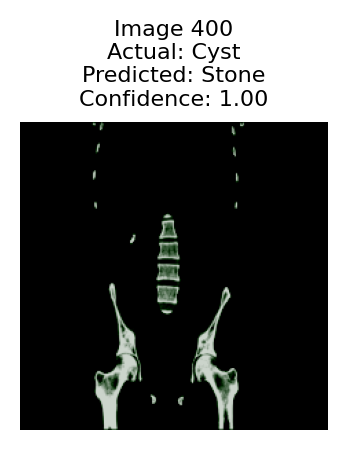

401
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9998809099197388


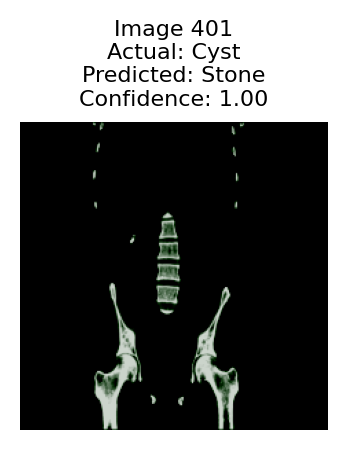

402
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9998792409896851
True Prediction
403
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9998338222503662
True Prediction
404
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9997542500495911
True Prediction
405
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9997259974479675
True Prediction
406
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9997448325157166
True Prediction
407
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9997941851615906
True Prediction
408
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9998125433921814
True Prediction
409
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9996669292449951
True Prediction
410
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9998676776885986
True Prediction
411
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9998843669891357
True Prediction
412
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.99991774559021
True P

481
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.993305504322052
True Prediction
482
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9935569167137146
True Prediction
483
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9945995807647705
True Prediction
484
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.997047483921051
True Prediction
485
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9965961575508118
True Prediction
486
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9980365633964539
True Prediction
487
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9984927177429199
True Prediction
488
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9981817007064819
True Prediction
489
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9847685098648071
True Prediction
490
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9179071187973022
True Prediction
491
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.8766643404960632
True P

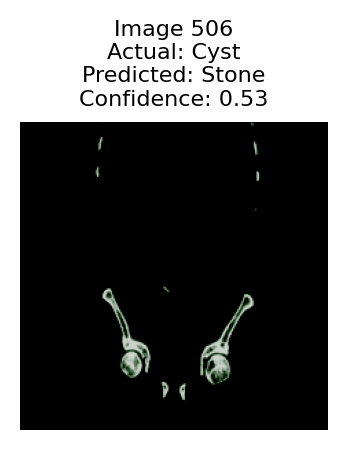

507
Actual label: Cyst
Predicted label: Stone
Confidence: 0.5876356959342957


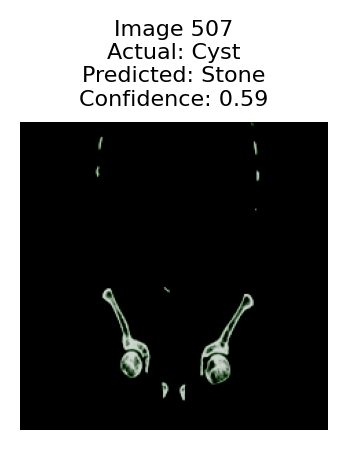

508
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.7840627431869507
True Prediction
509
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9043961763381958
True Prediction
510
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.920126736164093
True Prediction
511
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9670405983924866
True Prediction
512
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9842984676361084
True Prediction


513
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9830740094184875
True Prediction
514
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9565790295600891
True Prediction
515
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9540212750434875
True Prediction
516
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9421825408935547
True Prediction
517
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9503419995307922
True Prediction
518
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.8973397016525269
True Prediction
519
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.8497321605682373
True Prediction
520
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.7664221525192261
True Prediction
521
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.8730162382125854
True Prediction
522
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9098212122917175
True Prediction
523
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9107955098152161
True

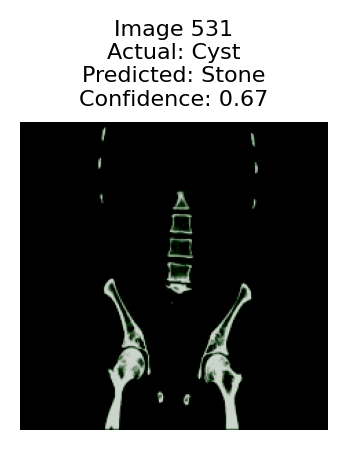

532
Actual label: Cyst
Predicted label: Stone
Confidence: 0.8093743920326233


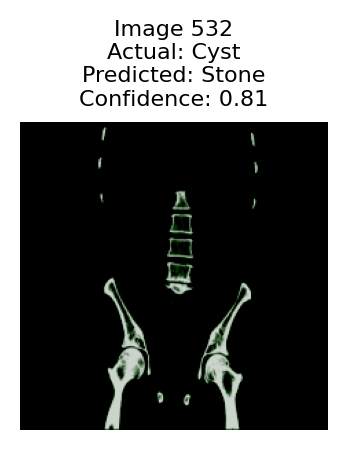

533
Actual label: Cyst
Predicted label: Stone
Confidence: 0.8520620465278625


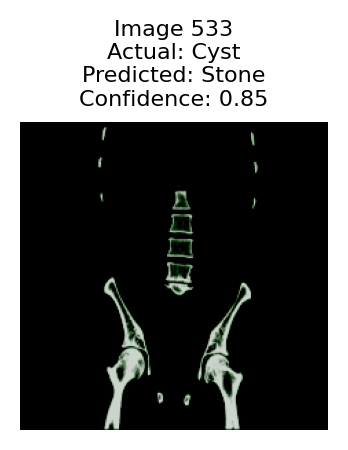

534
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.5331501960754395
True Prediction
535
Actual label: Cyst
Predicted label: Stone
Confidence: 0.5431056022644043


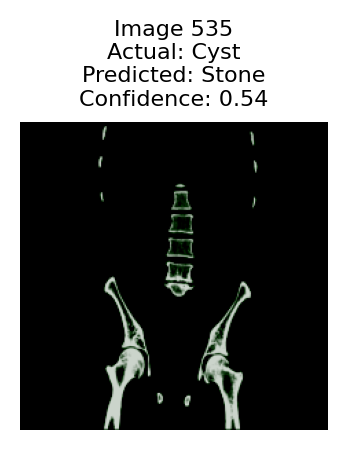

536
Actual label: Cyst
Predicted label: Stone
Confidence: 0.5232417583465576


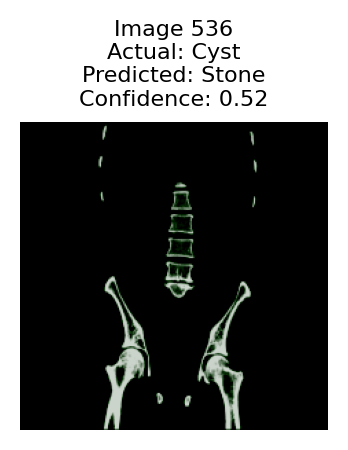

537
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.6479625105857849
True Prediction
538
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.5672286152839661
True Prediction
539
Actual label: Cyst
Predicted label: Stone
Confidence: 0.6552655696868896


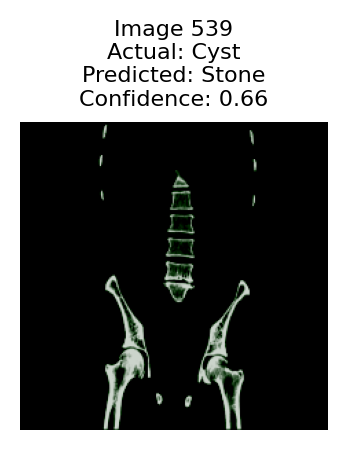

540
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9433811902999878


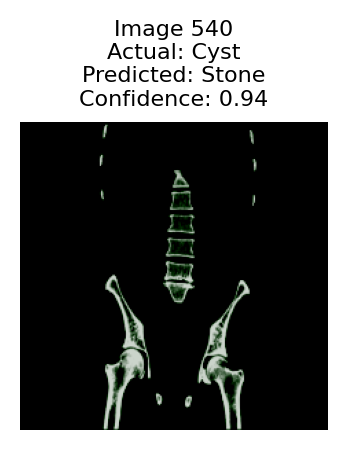

541
Actual label: Cyst
Predicted label: Stone


Confidence: 0.9692062735557556


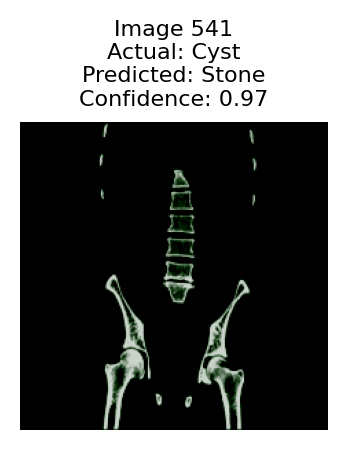

542
Actual label: Cyst
Predicted label: Stone
Confidence: 0.7827337980270386


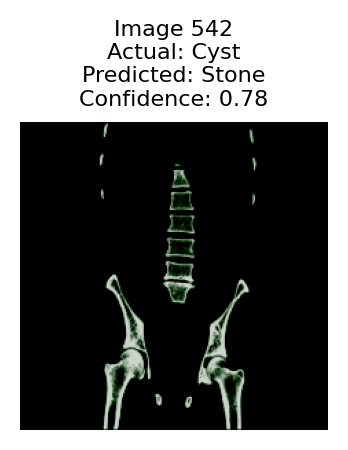

543
Actual label: Cyst
Predicted label: Stone
Confidence: 0.7200422286987305


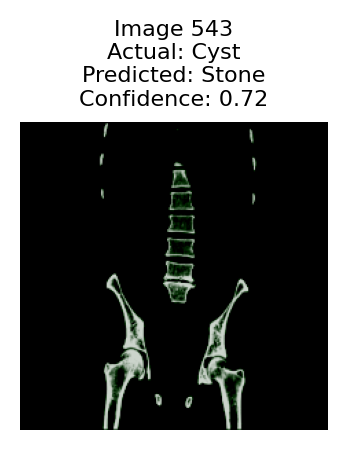

544
Actual label: Cyst
Predicted label: Stone
Confidence: 0.6038665175437927


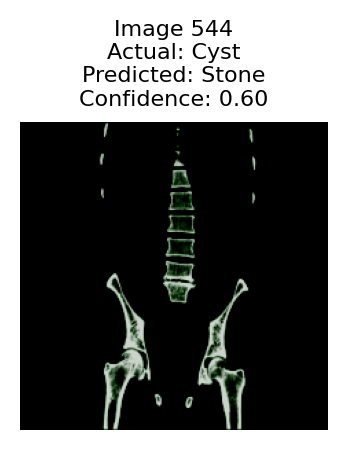

545
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.5044902563095093
True Prediction
546
Actual label: Cyst
Predicted label: Stone
Confidence: 0.6361103653907776


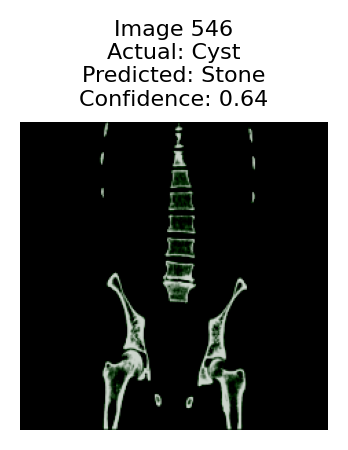

547
Actual label: Cyst
Predicted label: Stone
Confidence: 0.700724720954895


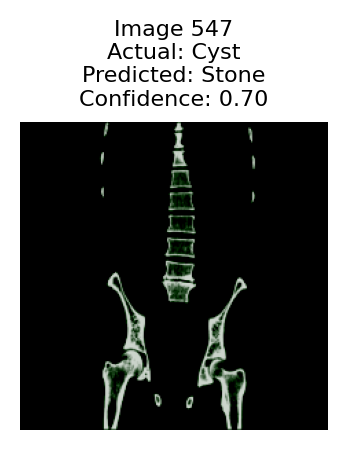

548
Actual label: Cyst
Predicted label: Stone
Confidence: 0.8379173874855042


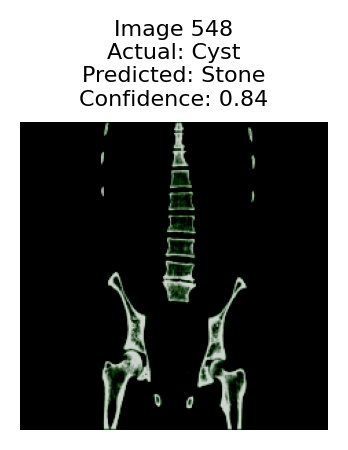

549
Actual label: Cyst
Predicted label: Stone
Confidence: 0.7279258370399475


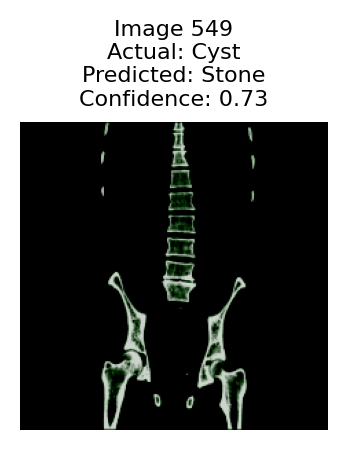

550
Actual label: Cyst
Predicted label: Stone
Confidence: 0.6828558444976807


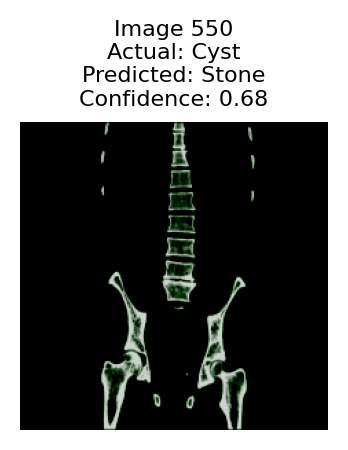

551
Actual label: Cyst
Predicted label: Stone
Confidence: 0.6470260620117188


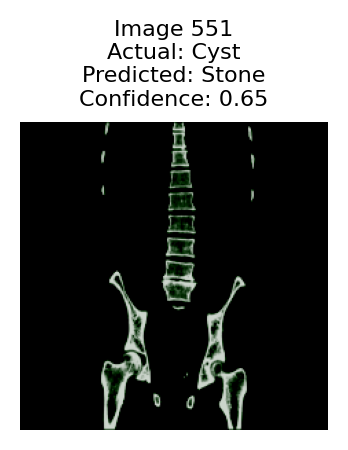

552
Actual label: Cyst
Predicted label: Stone
Confidence: 0.7464141845703125


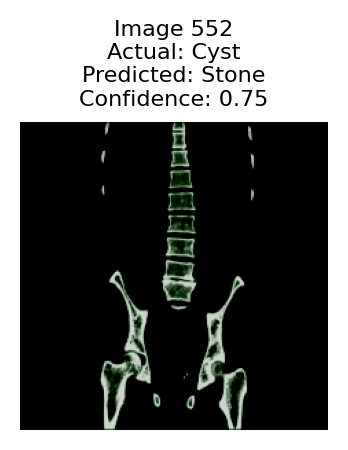

553
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9299079179763794


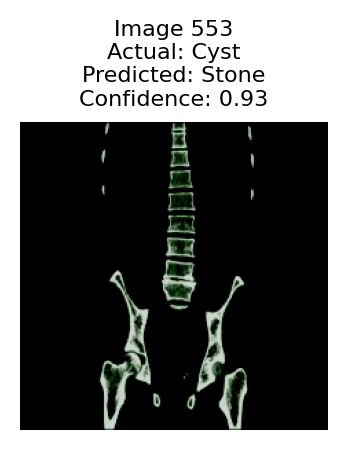

554
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9833691716194153


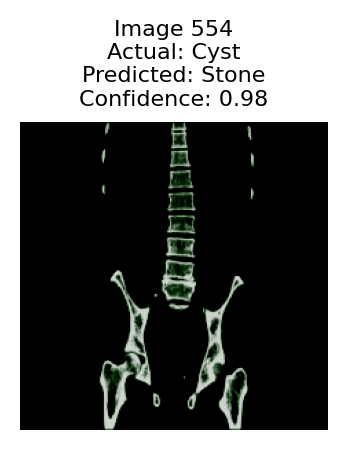

555
Actual label: Cyst
Predicted label: Stone
Confidence: 0.9634997844696045


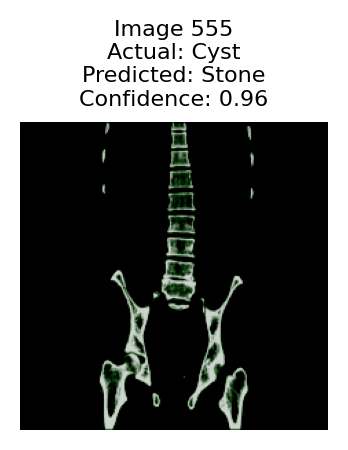

556
Actual label: Cyst
Predicted label: Stone
Confidence: 0.8722438216209412


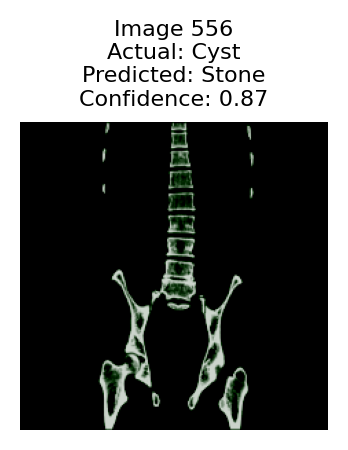

557
Actual label: Cyst
Predicted label: Stone
Confidence: 0.8683702945709229

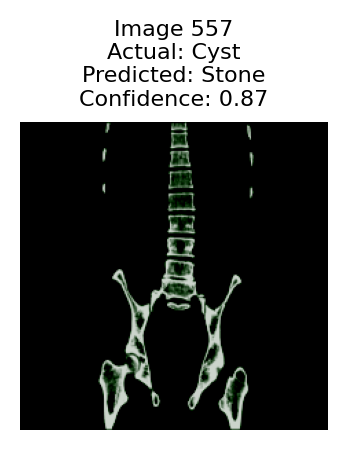

558
Actual label: Cyst
Predicted label: Stone
Confidence: 0.7410767674446106


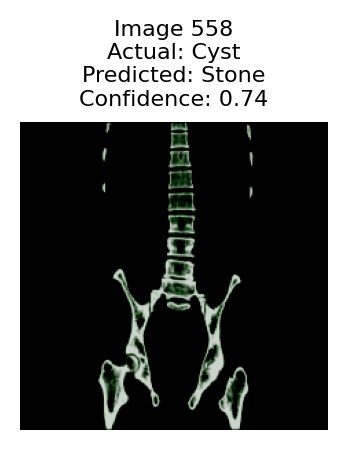

559
Actual label: Cyst
Predicted label: Stone
Confidence: 0.527035653591156


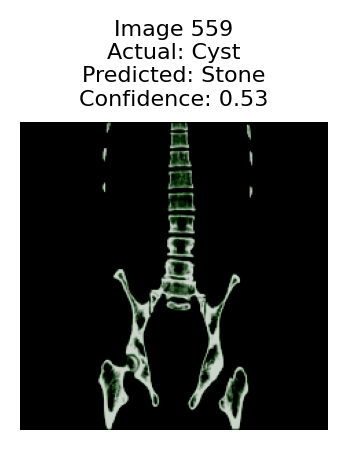

560
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.8123075366020203
True Prediction
561
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.7608177065849304
True Prediction
562
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.7934608459472656
True Prediction
563
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.8777733445167542
True Prediction
564
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9356881380081177
True Prediction
565
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9701418280601501
True Prediction
566
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9843997955322266
True Prediction
567
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9934296011924744
True Prediction
568
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9948855042457581
True Prediction
569
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9928358197212219
True Prediction
570
Actual label: Cyst
Predicted label: Cyst
Confidence: 0.9800928831100464
True

673
Actual label: Normal
Predicted label: Normal
Confidence: 0.9987732768058777
True Prediction
674
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9214286208152771


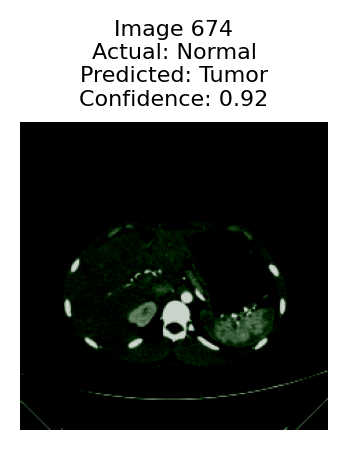

675
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9567466378211975


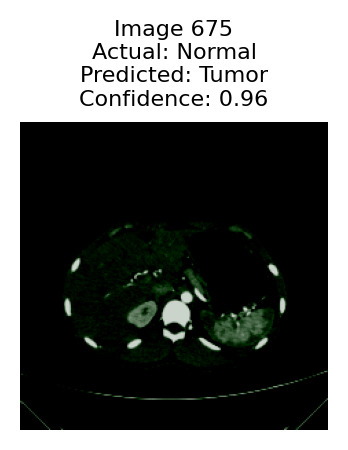

676
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9926382303237915


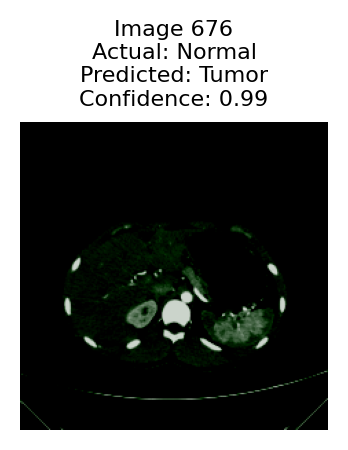

677
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9853473901748657


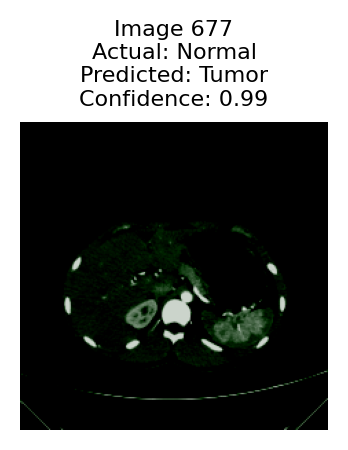

678
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9659639596939087


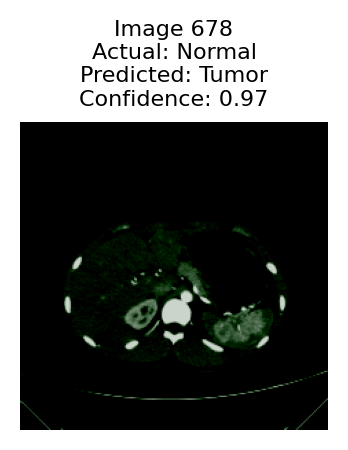

679
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9703477621078491


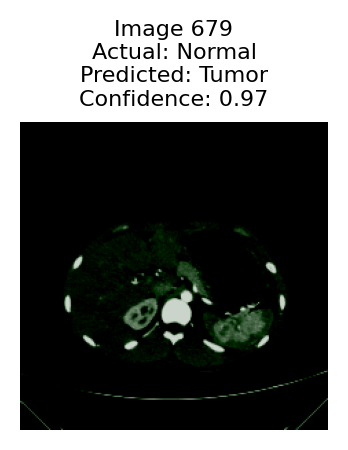

680
Actual label: Normal
Predicted label: Tumor
Confidence: 0.910184919834137


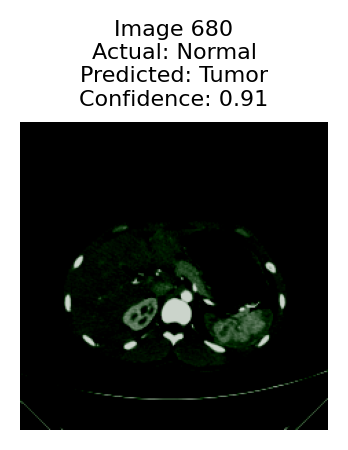

681
Actual label: Normal
Predicted label: Tumor
Confidence: 0.7597049474716187


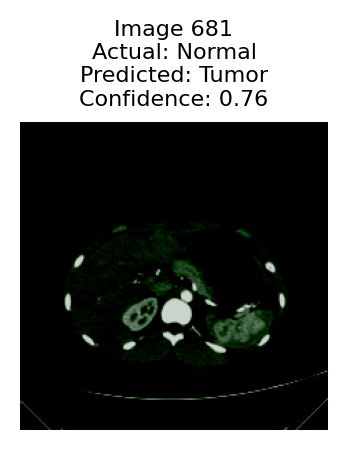

682
Actual label: Normal
Predicted label: Tumor
Confidence: 0.6522186994552612


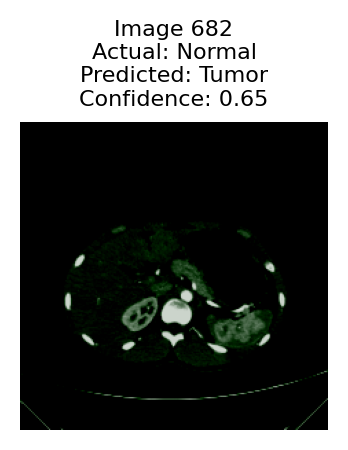

683
Actual label: Normal
Predicted label: Normal
Confidence: 0.7165759801864624
True Prediction
684
Actual label: Normal
Predicted label: Normal
Confidence: 0.9711631536483765
True Prediction
685
Actual label: Normal
Predicted label: Normal
Confidence: 0.9871891140937805
True Prediction
686
Actual label: Normal
Predicted label: Normal
Confidence: 0.8938156962394714
True Prediction
687
Actual label: Normal
Predicted label: Normal
Confidence: 0.9998001456260681
True Prediction
688
Actual label: Normal
Predicted label: Normal
Confidence: 0.9997771382331848
True Prediction
689
Actual label: Normal
Predicted label: Normal
Confidence: 0.9997169375419617
True Prediction
690
Actual label: Normal
Predicted label: Normal
Confidence: 0.9998189806938171
True Prediction
691
Actual label: Normal
Predicted label: Normal
Confidence: 0.9998263716697693
True Prediction
692
Actual label: Normal
Predicted label: Normal
Confidence: 0.9998284578323364
True Prediction
693
Actual label: Normal
Predicted label

705
Actual label: Normal
Predicted label: Normal
Confidence: 0.98614501953125
True Prediction
706
Actual label: Normal
Predicted label: Normal
Confidence: 0.9504681825637817
True Prediction
707
Actual label: Normal
Predicted label: Normal
Confidence: 0.9840313196182251
True Prediction
708
Actual label: Normal
Predicted label: Normal
Confidence: 0.9896323680877686
True Prediction
709
Actual label: Normal
Predicted label: Normal
Confidence: 0.9512202739715576
True Prediction
710
Actual label: Normal
Predicted label: Tumor
Confidence: 0.7481605410575867


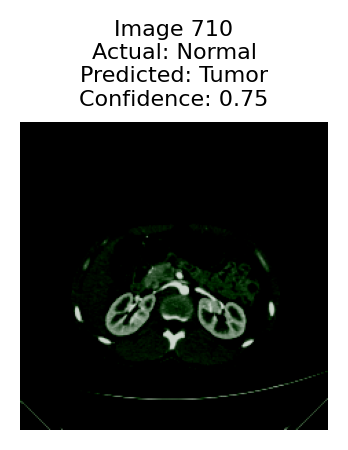

711
Actual label: Normal
Predicted label: Tumor
Confidence: 0.8843030333518982


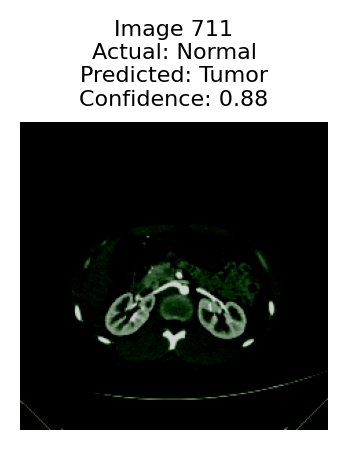

712
Actual label: Normal
Predicted label: Tumor
Confidence: 0.8489354848861694


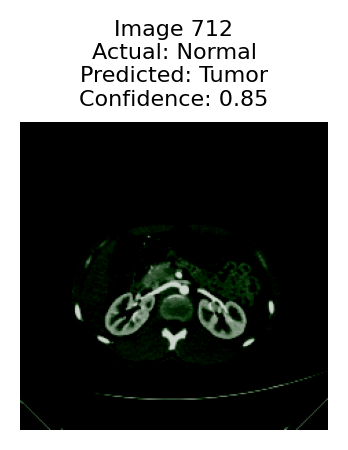

713
Actual label: Normal
Predicted label: Tumor


Confidence: 0.9244794249534607


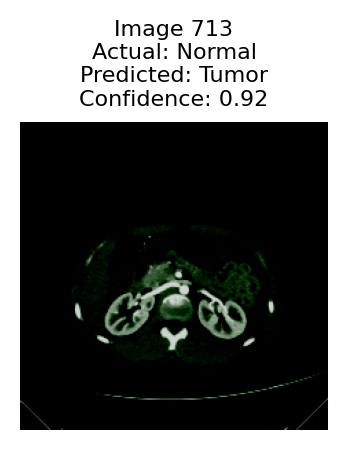

714
Actual label: Normal
Predicted label: Tumor
Confidence: 0.6611964106559753


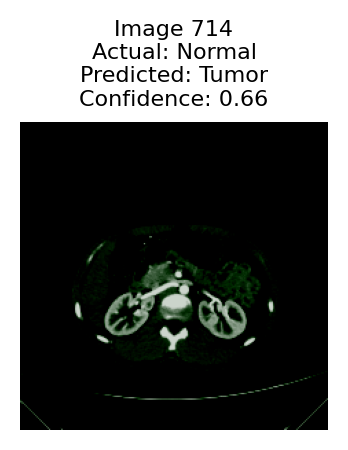

715
Actual label: Normal
Predicted label: Normal
Confidence: 0.8444428443908691
True Prediction
716
Actual label: Normal
Predicted label: Normal
Confidence: 0.7705755829811096
True Prediction
717
Actual label: Normal
Predicted label: Normal
Confidence: 0.8400604128837585
True Prediction
718
Actual label: Normal
Predicted label: Normal
Confidence: 0.949479877948761
True Prediction
719
Actual label: Normal
Predicted label: Normal
Confidence: 0.8251072764396667
True Prediction
720
Actual label: Normal
Predicted label: Tumor
Confidence: 0.5106425881385803


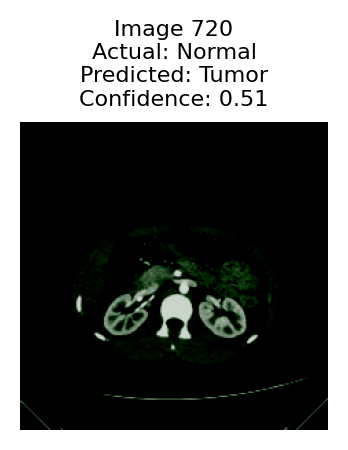

721
Actual label: Normal
Predicted label: Tumor
Confidence: 0.6156142950057983


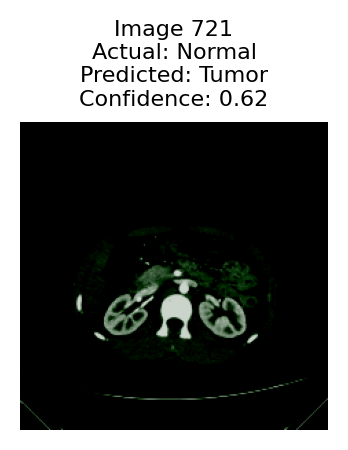

722
Actual label: Normal
Predicted label: Normal
Confidence: 0.5406897664070129
True Prediction
723
Actual label: Normal
Predicted label: Normal
Confidence: 0.951199471950531
True Prediction
724
Actual label: Normal
Predicted label: Normal
Confidence: 0.9890672564506531
True Prediction
725
Actual label: Normal
Predicted label: Normal
Confidence: 0.9925957322120667
True Prediction
726
Actual label: Normal
Predicted label: Normal
Confidence: 0.9863837361335754
True Prediction
727
Actual label: Normal
Predicted label: Normal
Confidence: 0.9864257574081421
True Prediction
728
Actual label: Normal
Predicted label: Normal
Confidence: 0.9829661846160889
True Prediction
729
Actual label: Normal
Predicted label: Normal
Confidence: 0.9918117523193359
True Prediction
730
Actual label: Normal
Predicted label: Normal
Confidence: 0.990971565246582
True Prediction
731
Actual label: Normal
Predicted label: Normal
Confidence: 0.9707747101783752
True Prediction
732
Actual label: Normal
Predicted label: 

769
Actual label: Normal
Predicted label: Normal
Confidence: 0.9129481911659241
True Prediction
770
Actual label: Normal
Predicted label: Normal
Confidence: 0.6350521445274353
True Prediction
771
Actual label: Normal
Predicted label: Normal
Confidence: 0.6269417405128479
True Prediction
772
Actual label: Normal
Predicted label: Normal
Confidence: 0.7351586222648621
True Prediction
773
Actual label: Normal
Predicted label: Normal
Confidence: 0.7752763032913208
True Prediction
774
Actual label: Normal
Predicted label: Normal
Confidence: 0.677358865737915
True Prediction
775
Actual label: Normal
Predicted label: Normal
Confidence: 0.7996639609336853
True Prediction
776
Actual label: Normal
Predicted label: Normal
Confidence: 0.8410249352455139
True Prediction
777
Actual label: Normal
Predicted label: Normal
Confidence: 0.6576570272445679
True Prediction
778
Actual label: Normal
Predicted label: Tumor
Confidence: 0.6493699550628662


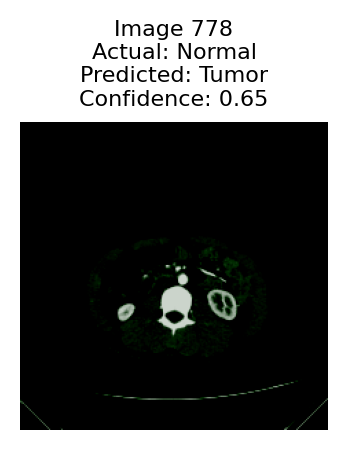

779
Actual label: Normal
Predicted label: Tumor
Confidence: 0.6825439929962158


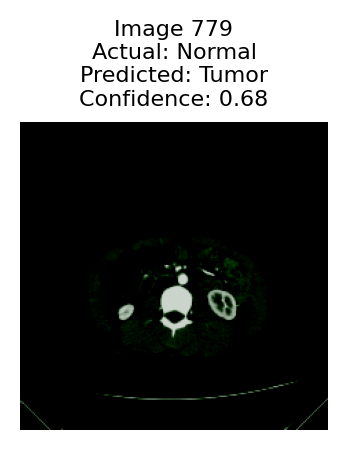

780
Actual label: Normal
Predicted label: Normal
Confidence: 0.6719728708267212
True Prediction
781
Actual label: Normal
Predicted label: Normal
Confidence: 0.9395103454589844
True Prediction
782
Actual label: Normal
Predicted label: Normal
Confidence: 0.9693231582641602
True Prediction
783
Actual label: Normal
Predicted label: Normal
Confidence: 0.9371238350868225
True Prediction
784
Actual label: Normal
Predicted label: Normal
Confidence: 0.9534850716590881
True Prediction
785
Actual label: Normal
Predicted label: Normal
Confidence: 0.9658284187316895
True Prediction
786
Actual label: Normal
Predicted label: Normal
Confidence: 0.9788771271705627
True Prediction
787
Actual label: Normal
Predicted label: Normal
Confidence: 0.9756568670272827
True Prediction
788
Actual label: Normal
Predicted label: Normal
Confidence: 0.8250354528427124
True Prediction
789
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9912574291229248


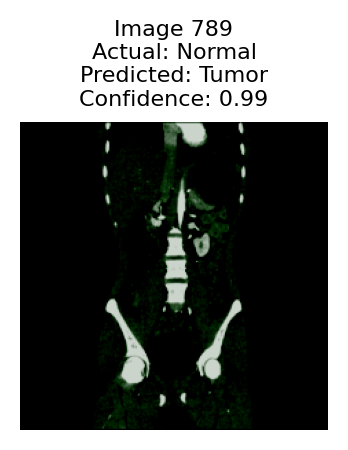

790
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9955997467041016


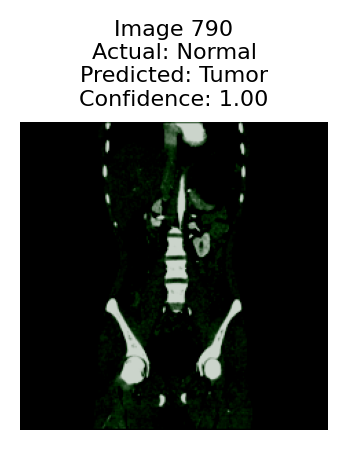

791
Actual label: Normal
Predicted label: Tumor
Confidence: 0.997674286365509


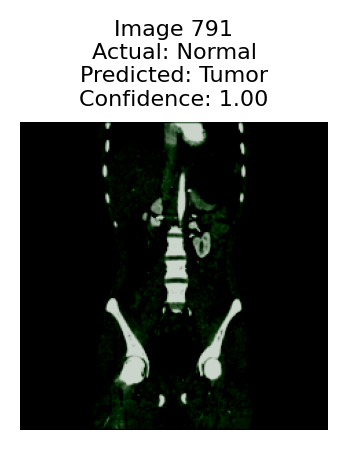

792
Actual label: Normal
Predicted label: Tumor
Confidence: 0.992536187171936


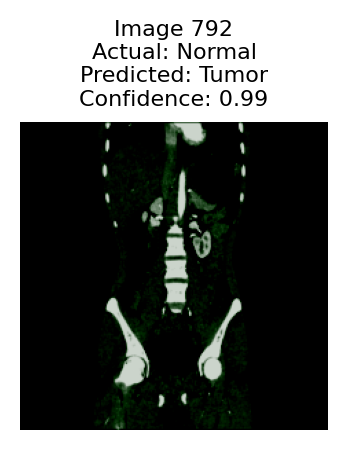

793
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9891106486320496


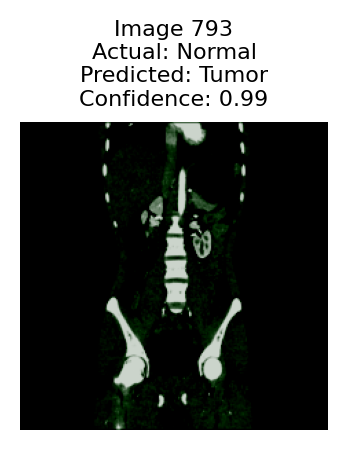

794
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9971924424171448


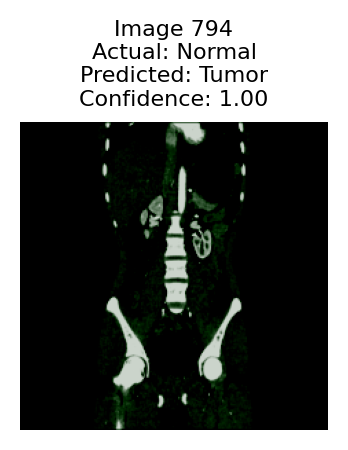

795
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9964775443077087


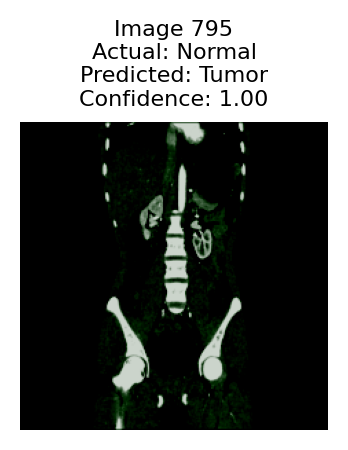

796
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9779279232025146


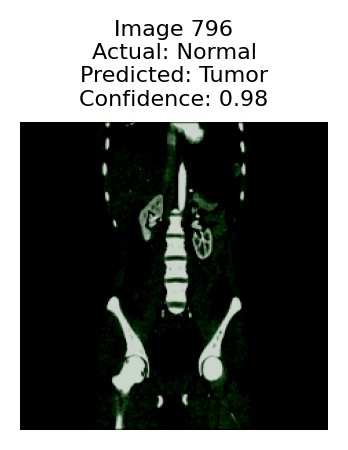

797
Actual label: Normal
Predicted label: Tumor


Confidence: 0.8497690558433533


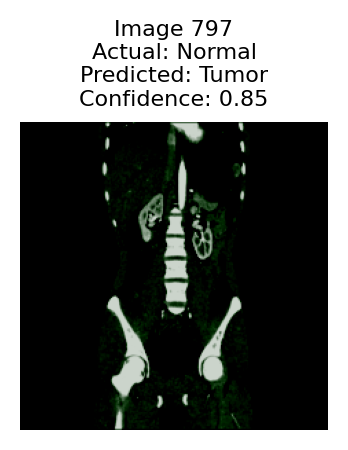

798
Actual label: Normal
Predicted label: Tumor
Confidence: 0.8156764507293701


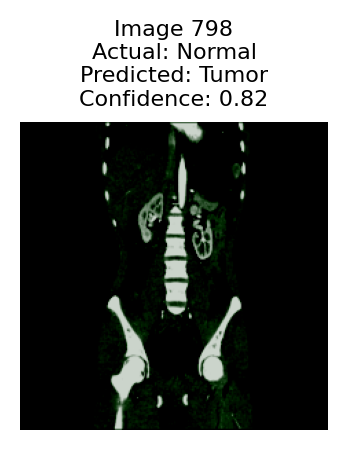

799
Actual label: Normal
Predicted label: Tumor
Confidence: 0.854492723941803


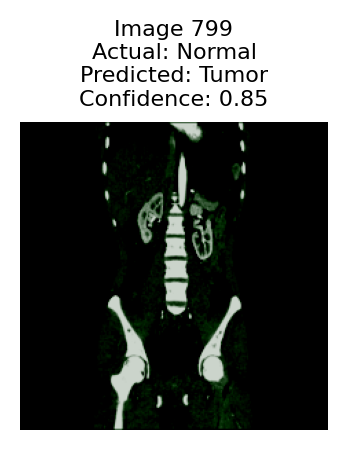

800
Actual label: Normal
Predicted label: Tumor
Confidence: 0.932346522808075


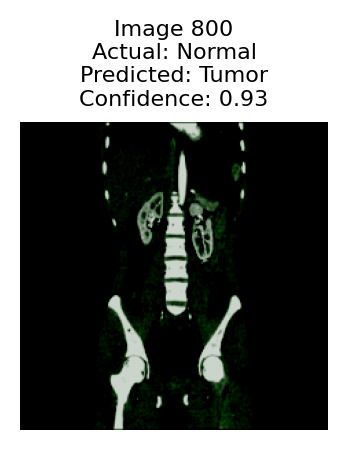

801
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9094589948654175


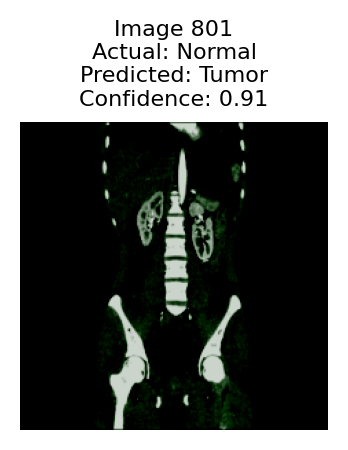

802
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9259620904922485


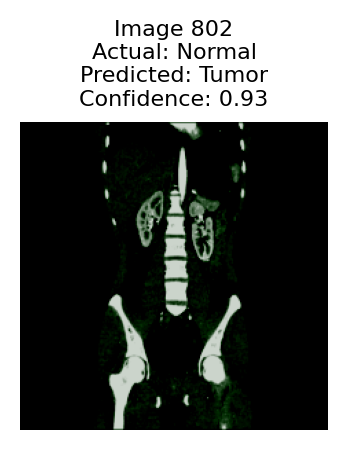

803
Actual label: Normal
Predicted label: Tumor
Confidence: 0.951553463935852


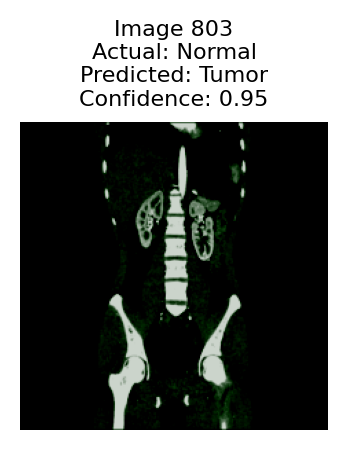

804
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9120364785194397


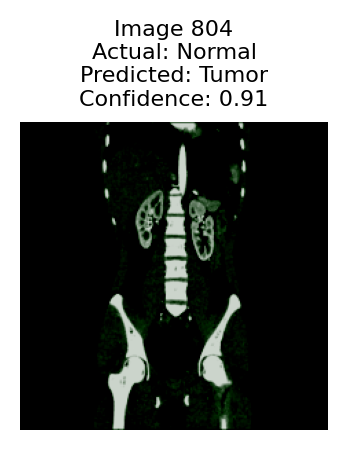

805
Actual label: Normal
Predicted label: Tumor
Confidence: 0.8722676634788513


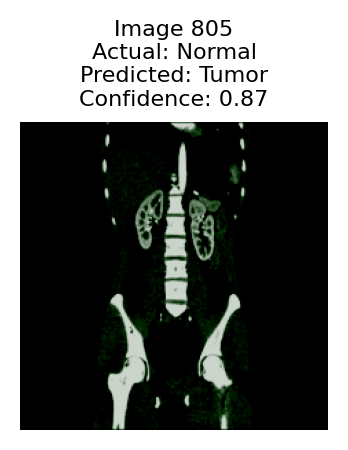

806
Actual label: Normal
Predicted label: Tumor
Confidence: 0.8806712627410889


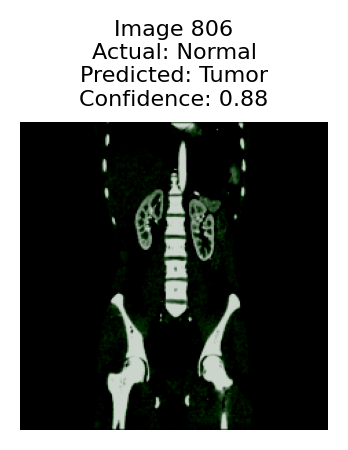

807
Actual label: Normal
Predicted label: Tumor
Confidence: 0.7825133204460144


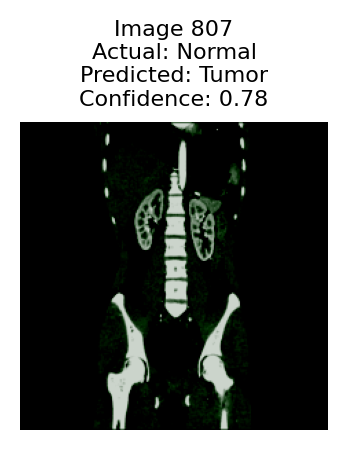

808
Actual label: Normal
Predicted label: Tumor
Confidence: 0.5134741067886353


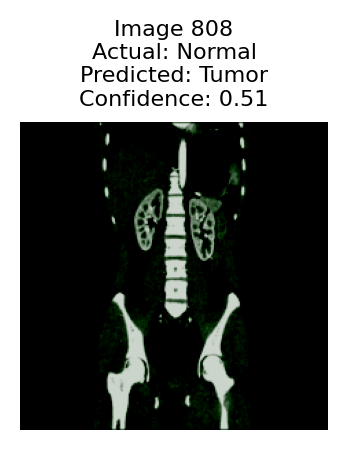

809
Actual label: Normal
Predicted label: Tumor
Confidence: 0.6132350564002991


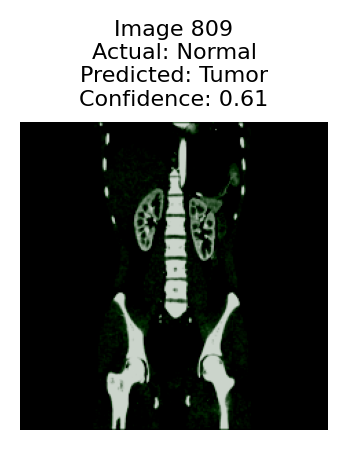

810
Actual label: Normal
Predicted label: Tumor
Confidence: 0.7316683530807495


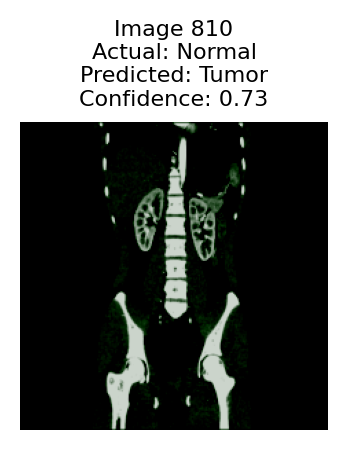

811
Actual label: Normal
Predicted label: Tumor
Confidence: 0.8867993950843811


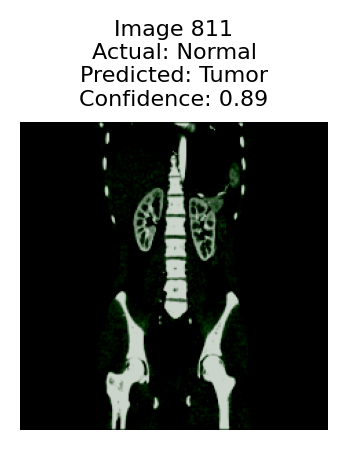

812
Actual label: Normal
Predicted label: Tumor
Confidence: 0.8375073671340942


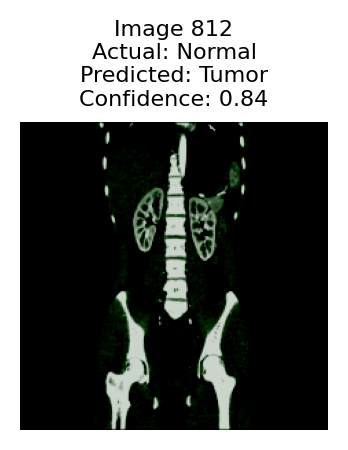

813
Actual label: Normal
Predicted label: Tumor
Confidence: 0.8875501155853271


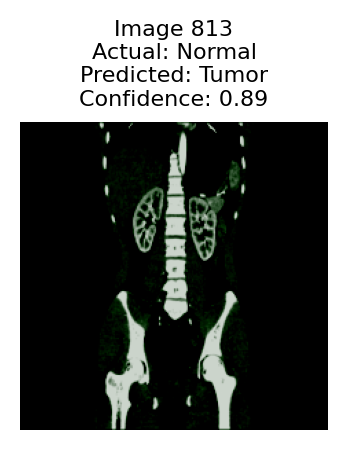

814
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9546117782592773


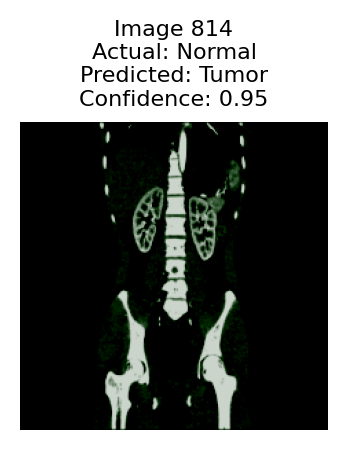

815
Actual label: Normal
Predicted label: Tumor
Confidence: 0.954179048538208


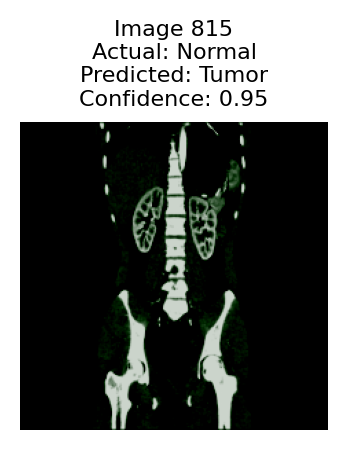

816
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9810154438018799


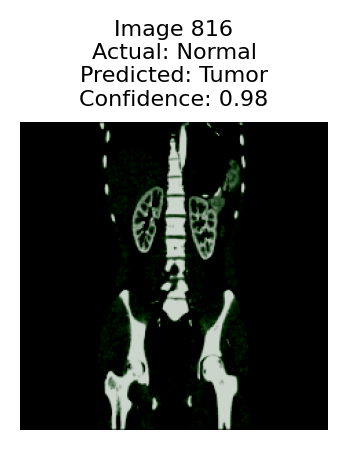

817
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9909532070159912


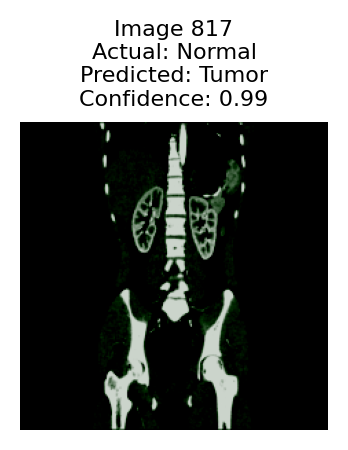

818
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9420957565307617


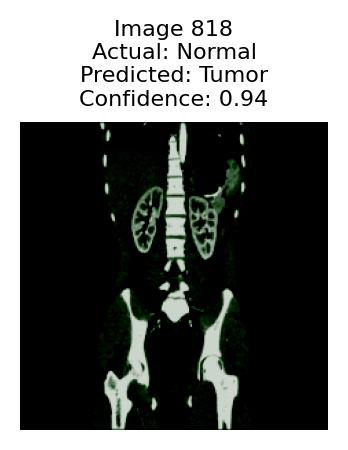

819
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9550706148147583


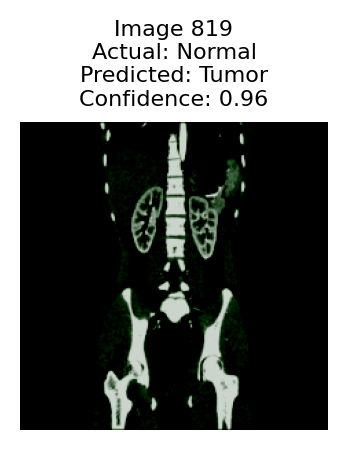

820
Actual label: Normal
Predicted label: Tumor
Confidence: 0.7746649980545044


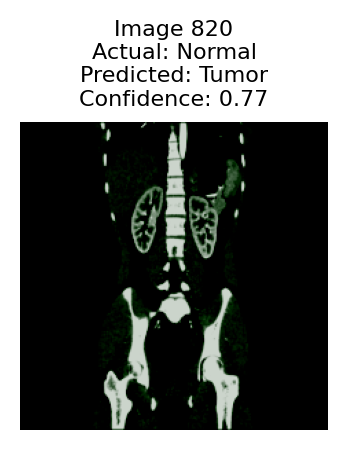

821
Actual label: Normal
Predicted label: Tumor
Confidence: 0.7109751105308533


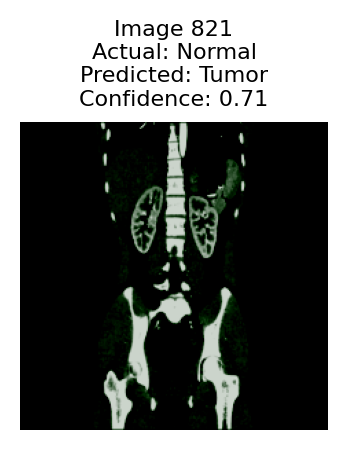

822
Actual label: Normal
Predicted label: Tumor
Confidence: 0.5526673197746277


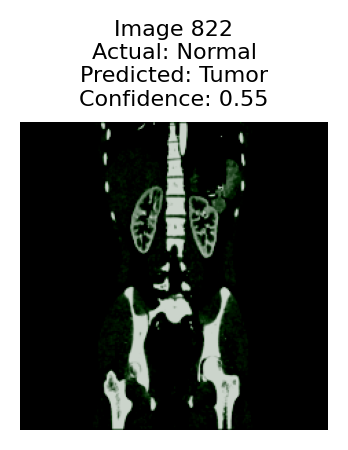

823
Actual label: Normal
Predicted label: Tumor
Confidence: 0.6837639808654785


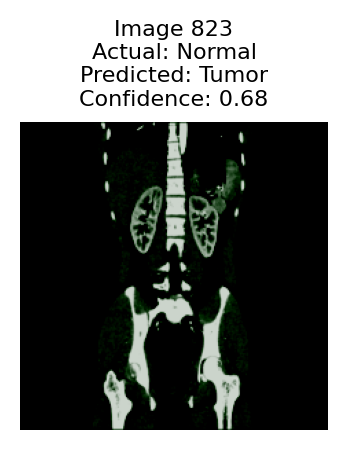

824
Actual label: Normal
Predicted label: Tumor
Confidence: 0.7404856085777283


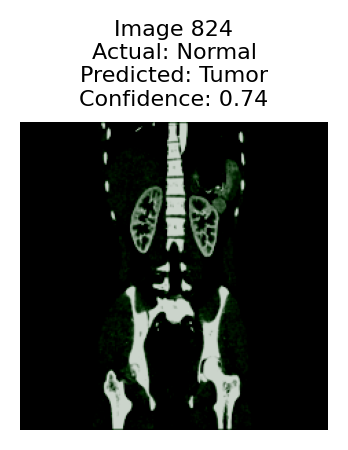

825
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9041129946708679


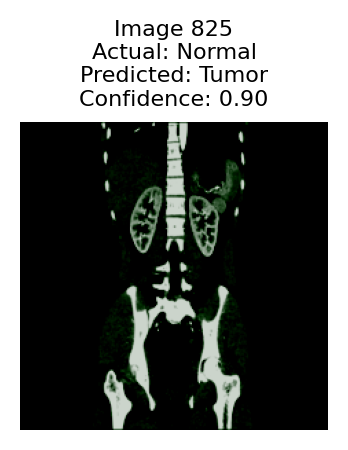

826
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9653139114379883


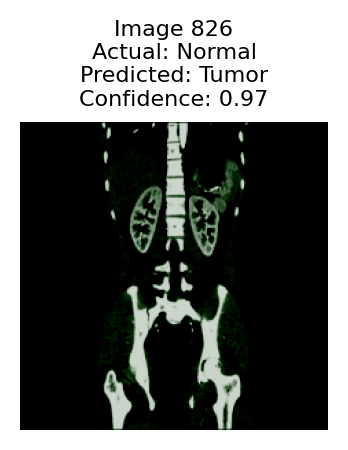

827
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9066861867904663


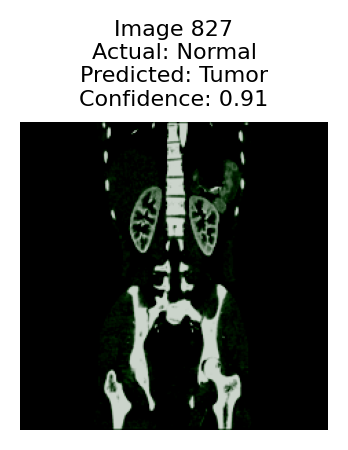

828
Actual label: Normal
Predicted label: Tumor
Confidence: 0.8920512199401855


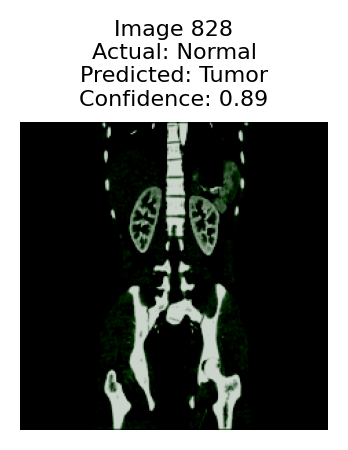

829
Actual label: Normal
Predicted label: Tumor
Confidence: 0.7393141984939575


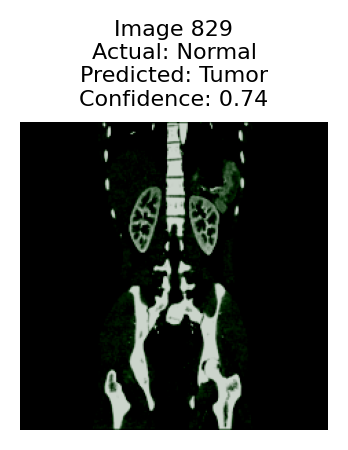

830
Actual label: Normal
Predicted label: Tumor
Confidence: 0.693781316280365


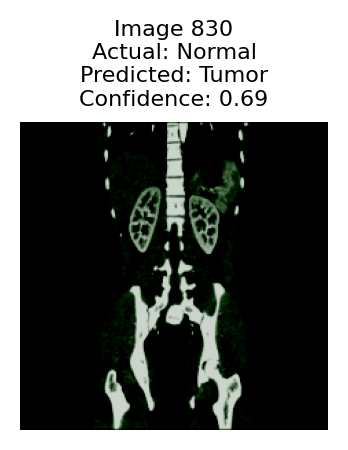

831
Actual label: Normal
Predicted label: Normal
Confidence: 0.7091110944747925
True Prediction
832
Actual label: Normal
Predicted label: Normal
Confidence: 0.5027732849121094
True Prediction


833
Actual label: Normal
Predicted label: Normal
Confidence: 0.7795379757881165
True Prediction
834
Actual label: Normal
Predicted label: Normal
Confidence: 0.6080440282821655
True Prediction
835
Actual label: Normal
Predicted label: Normal
Confidence: 0.5987405776977539
True Prediction
836
Actual label: Normal
Predicted label: Tumor
Confidence: 0.6885825991630554


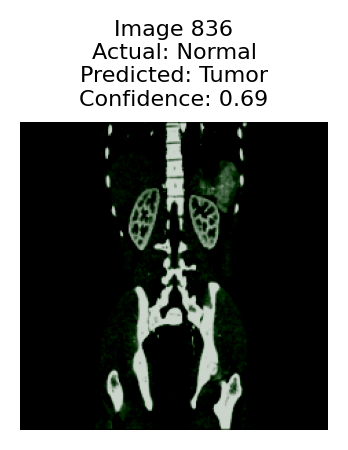

837
Actual label: Normal
Predicted label: Tumor
Confidence: 0.8990405201911926


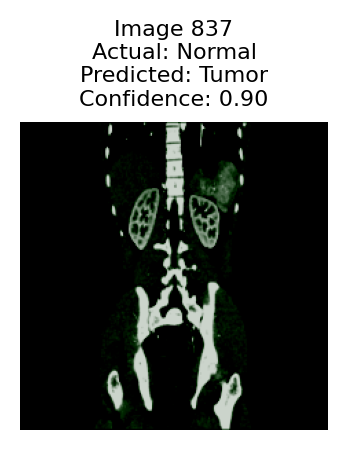

838
Actual label: Normal
Predicted label: Tumor
Confidence: 0.8395827412605286


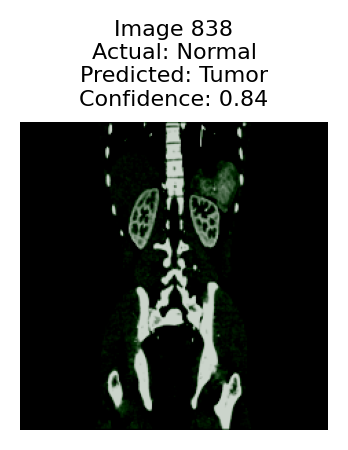

839
Actual label: Normal
Predicted label: Tumor
Confidence: 0.951227605342865


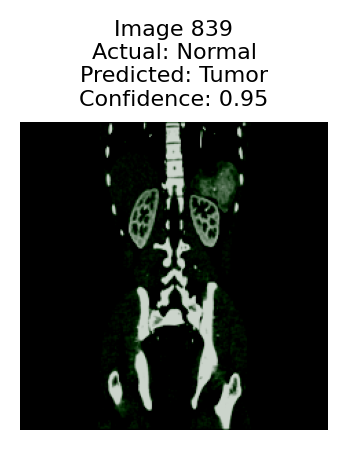

840
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9619536399841309


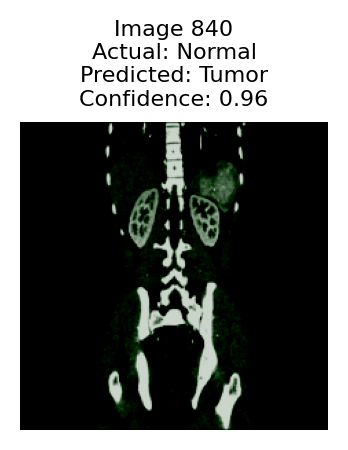

841
Actual label: Normal
Predicted label: Tumor
Confidence: 0.8490540981292725


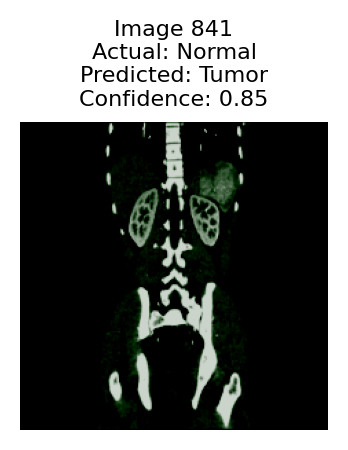

842
Actual label: Normal
Predicted label: Normal
Confidence: 0.7605254650115967
True Prediction
843
Actual label: Normal
Predicted label: Normal
Confidence: 0.9665982127189636
True Prediction
844
Actual label: Normal
Predicted label: Normal
Confidence: 0.9729631543159485
True Prediction
845
Actual label: Normal
Predicted label: Normal
Confidence: 0.8518200516700745
True Prediction
846
Actual label: Normal
Predicted label: Normal
Confidence: 0.9620156288146973
True Prediction
847
Actual label: Normal
Predicted label: Normal
Confidence: 0.9692580699920654
True Prediction
848
Actual label: Normal
Predicted label: Normal
Confidence: 0.9672412872314453
True Prediction
849
Actual label: Normal
Predicted label: Normal
Confidence: 0.9696780443191528
True Prediction
850
Actual label: Normal
Predicted label: Normal
Confidence: 0.9905267953872681
True Prediction
851
Actual label: Normal
Predicted label: Normal
Confidence: 0.9942341446876526
True Prediction
852
Actual label: Normal
Predicted label

897
Actual label: Normal
Predicted label: Normal
Confidence: 0.9961985945701599
True Prediction
898
Actual label: Normal
Predicted label: Normal
Confidence: 0.9941503405570984
True Prediction
899
Actual label: Normal
Predicted label: Normal
Confidence: 0.9931150078773499
True Prediction
900
Actual label: Normal
Predicted label: Normal
Confidence: 0.9671374559402466
True Prediction
901
Actual label: Normal
Predicted label: Normal
Confidence: 0.9788801074028015
True Prediction
902
Actual label: Normal
Predicted label: Normal
Confidence: 0.9721941947937012
True Prediction
903
Actual label: Normal
Predicted label: Normal
Confidence: 0.8909083008766174
True Prediction
904
Actual label: Normal
Predicted label: Normal
Confidence: 0.7945342063903809
True Prediction
905
Actual label: Normal
Predicted label: Tumor
Confidence: 0.606640636920929


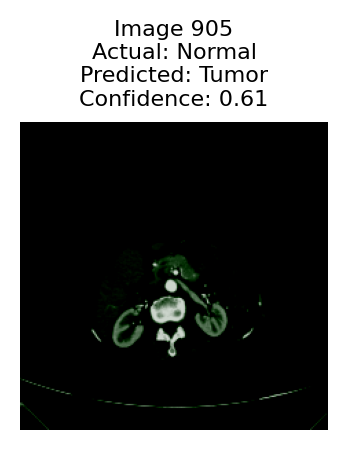

906
Actual label: Normal
Predicted label: Tumor
Confidence: 0.5254992842674255


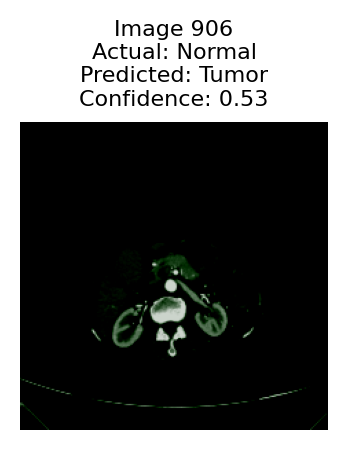

907
Actual label: Normal
Predicted label: Tumor
Confidence: 0.6373076438903809


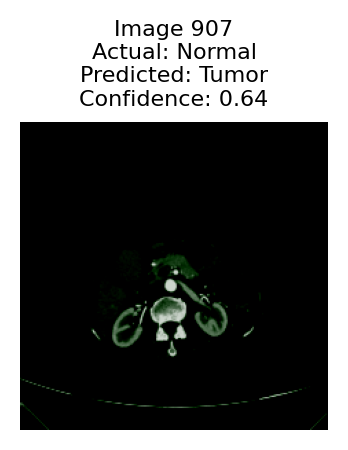

908
Actual label: Normal
Predicted label: Normal
Confidence: 0.6341471076011658
True Prediction
909
Actual label: Normal
Predicted label: Normal
Confidence: 0.6037346720695496
True Prediction
910
Actual label: Normal
Predicted label: Normal
Confidence: 0.8508936166763306
True Prediction
911
Actual label: Normal
Predicted label: Normal
Confidence: 0.9379072785377502
True Prediction
912
Actual label: Normal
Predicted label: Normal
Confidence: 0.8426902294158936
True Prediction
913
Actual label: Normal
Predicted label: Normal
Confidence: 0.7447510361671448
True Prediction
914
Actual label: Normal
Predicted label: Normal
Confidence: 0.745057225227356
True Prediction
915
Actual label: Normal
Predicted label: Normal
Confidence: 0.8861449360847473
True Prediction
916
Actual label: Normal
Predicted label: Normal
Confidence: 0.9056905508041382
True Prediction
917
Actual label: Normal
Predicted label: Normal
Confidence: 0.8650832772254944
True Prediction
918
Actual label: Normal
Predicted label:

929
Actual label: Normal
Predicted label: Normal
Confidence: 0.9111098051071167
True Prediction
930
Actual label: Normal
Predicted label: Normal
Confidence: 0.88257896900177
True Prediction
931
Actual label: Normal
Predicted label: Normal
Confidence: 0.76462721824646
True Prediction
932
Actual label: Normal
Predicted label: Normal
Confidence: 0.9637848734855652
True Prediction
933
Actual label: Normal
Predicted label: Normal
Confidence: 0.9749187231063843
True Prediction
934
Actual label: Normal
Predicted label: Normal
Confidence: 0.9799261689186096
True Prediction
935
Actual label: Normal
Predicted label: Normal
Confidence: 0.9971821308135986
True Prediction
936
Actual label: Normal
Predicted label: Normal
Confidence: 0.9942216277122498
True Prediction
937
Actual label: Normal
Predicted label: Normal
Confidence: 0.9939153790473938
True Prediction
938
Actual label: Normal
Predicted label: Normal
Confidence: 0.9980865716934204
True Prediction
939
Actual label: Normal
Predicted label: No

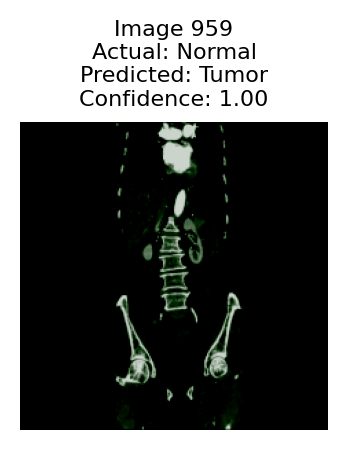

960
Actual label: Normal
Predicted label: Tumor
Confidence: 0.996688187122345


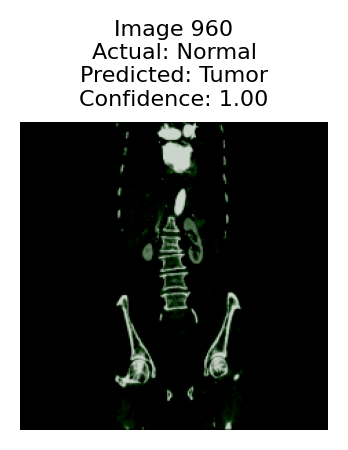

961
Actual label: Normal
Predicted label: Tumor
Confidence: 0.990278422832489


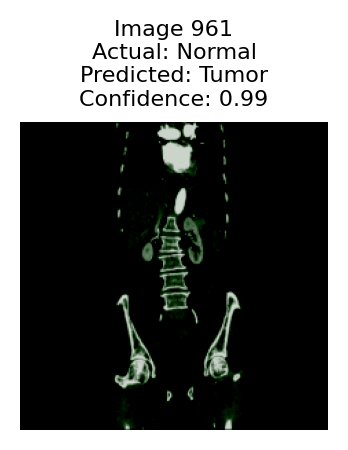

962
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9686555862426758


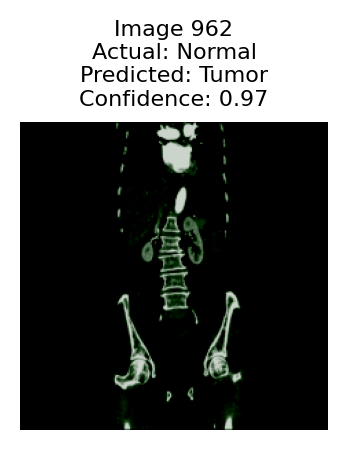

963
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9670284390449524


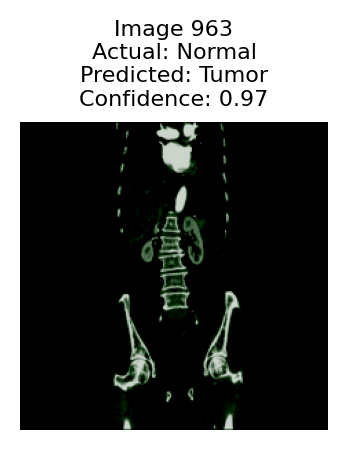

964
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9621592164039612


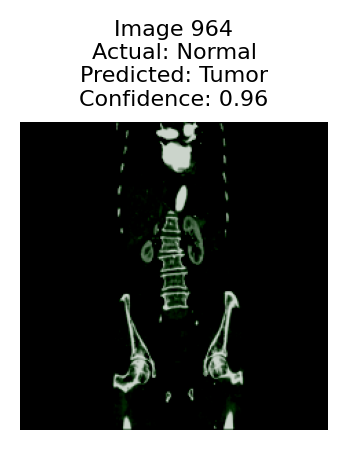

965
Actual label: Normal
Predicted label: Tumor
Confidence: 0.973334550857544


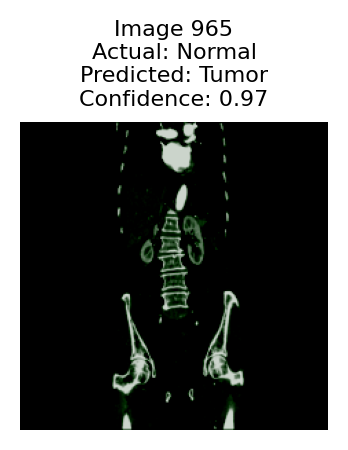

966
Actual label: Normal
Predicted label: Tumor
Confidence: 0.9042446613311768


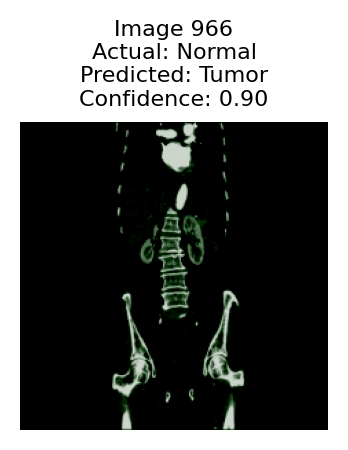

967
Actual label: Normal
Predicted label: Tumor
Confidence: 0.6723117232322693


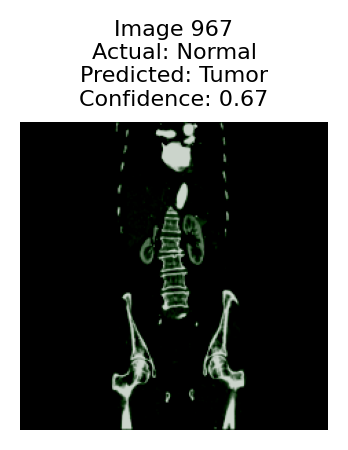

968
Actual label: Normal
Predicted label: Tumor
Confidence: 0.7263920307159424


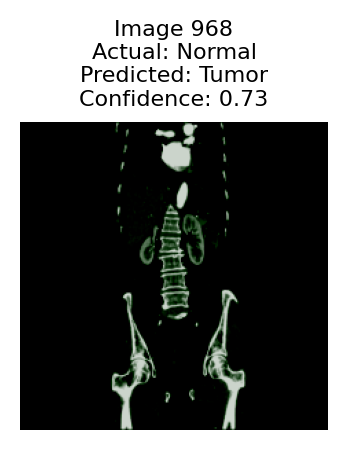

969
Actual label: Normal
Predicted label: Normal
Confidence: 0.5927218794822693
True Prediction
970
Actual label: Normal
Predicted label: Normal
Confidence: 0.5502262711524963
True Prediction
971
Actual label: Normal
Predicted label: Normal
Confidence: 0.7492899298667908
True Prediction
972
Actual label: Normal
Predicted label: Normal
Confidence: 0.974217414855957
True Prediction
973
Actual label: Normal
Predicted label: Normal
Confidence: 0.9933370351791382
True Prediction
974
Actual label: Normal
Predicted label: Normal
Confidence: 0.9851245284080505
True Prediction
975
Actual label: Normal
Predicted label: Normal
Confidence: 0.9834896326065063
True Prediction
976
Actual label: Normal
Predicted label: Normal
Confidence: 0.986856997013092
True Prediction
977
Actual label: Normal
Predicted label: Normal
Confidence: 0.954829752445221
True Prediction
978
Actual label: Normal
Predicted label: Normal
Confidence: 0.8637629747390747
True Prediction
979
Actual label: Normal
Predicted label: N

1249
Actual label: Normal
Predicted label: Normal
Confidence: 0.9997859597206116
True Prediction
1250
Actual label: Normal
Predicted label: Normal
Confidence: 0.9997751116752625
True Prediction
1251
Actual label: Normal
Predicted label: Normal
Confidence: 0.9997721314430237
True Prediction
1252
Actual label: Normal
Predicted label: Normal
Confidence: 0.9997319579124451
True Prediction
1253
Actual label: Normal
Predicted label: Normal
Confidence: 0.999622106552124
True Prediction
1254
Actual label: Normal
Predicted label: Normal
Confidence: 0.999580442905426
True Prediction
1255
Actual label: Normal
Predicted label: Normal
Confidence: 0.9995204210281372
True Prediction
1256
Actual label: Normal
Predicted label: Normal
Confidence: 0.9990851879119873
True Prediction
1257
Actual label: Normal
Predicted label: Normal
Confidence: 0.9978365302085876
True Prediction
1258
Actual label: Normal
Predicted label: Normal
Confidence: 0.9936630725860596
True Prediction
1259
Actual label: Normal
Predic

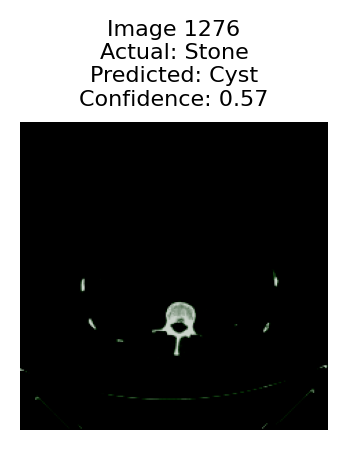

1277
Actual label: Stone
Predicted label: Stone
Confidence: 0.7519446611404419
True Prediction
1278
Actual label: Stone
Predicted label: Stone
Confidence: 0.7842792272567749
True Prediction
1279
Actual label: Stone
Predicted label: Stone
Confidence: 0.5010029673576355
True Prediction
1280
Actual label: Stone
Predicted label: Stone
Confidence: 0.9512491822242737
True Prediction


1281
Actual label: Stone
Predicted label: Stone
Confidence: 0.9785075187683105
True Prediction
1282
Actual label: Stone
Predicted label: Stone
Confidence: 0.9812854528427124
True Prediction
1283
Actual label: Stone
Predicted label: Stone
Confidence: 0.9569892287254333
True Prediction
1284
Actual label: Stone
Predicted label: Stone
Confidence: 0.969092607498169
True Prediction
1285
Actual label: Stone
Predicted label: Stone
Confidence: 0.985446572303772
True Prediction
1286
Actual label: Stone
Predicted label: Stone
Confidence: 0.9903202652931213
True Prediction
1287
Actual label: Stone
Predicted label: Stone
Confidence: 0.9939853549003601
True Prediction
1288
Actual label: Stone
Predicted label: Stone
Confidence: 0.9974256157875061
True Prediction
1289
Actual label: Stone
Predicted label: Stone
Confidence: 0.9955924153327942
True Prediction
1290
Actual label: Stone
Predicted label: Stone
Confidence: 0.9944918155670166
True Prediction
1291
Actual label: Stone
Predicted label: Stone
Conf

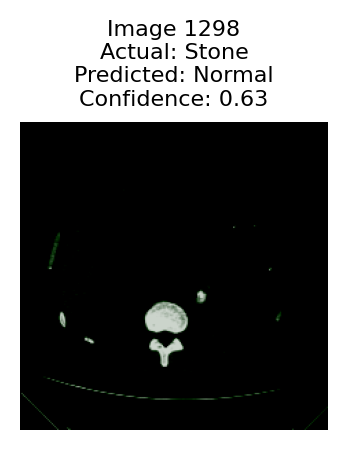

1299
Actual label: Stone
Predicted label: Normal
Confidence: 0.7552952170372009


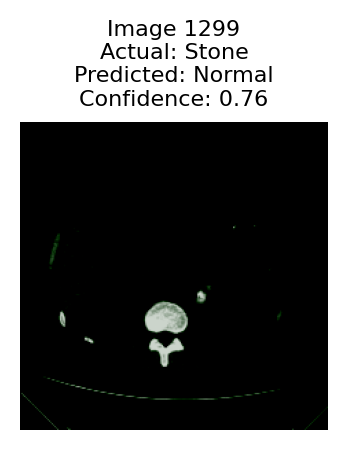

1300
Actual label: Stone
Predicted label: Normal
Confidence: 0.8020306825637817


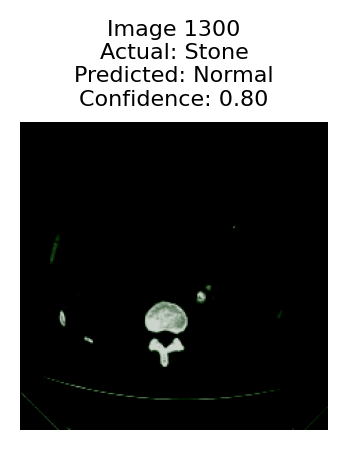

1301
Actual label: Stone
Predicted label: Normal
Confidence: 0.6241171360015869


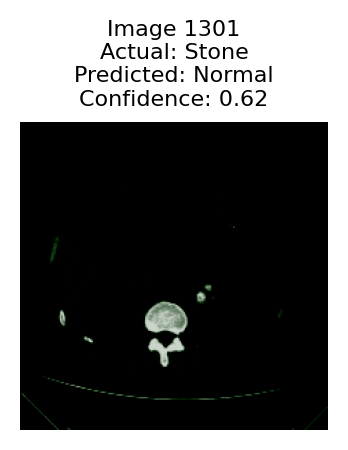

1302
Actual label: Stone
Predicted label: Stone
Confidence: 0.5735768675804138
True Prediction
1303
Actual label: Stone
Predicted label: Stone
Confidence: 0.6306439638137817
True Prediction
1304
Actual label: Stone
Predicted label: Stone
Confidence: 0.7598414421081543
True Prediction
1305
Actual label: Stone
Predicted label: Stone
Confidence: 0.7593385577201843
True Prediction
1306
Actual label: Stone
Predicted label: Stone
Confidence: 0.924553632736206
True Prediction
1307
Actual label: Stone
Predicted label: Stone
Confidence: 0.9622038006782532
True Prediction
1308
Actual label: Stone
Predicted label: Stone
Confidence: 0.9645165801048279
True Prediction
1309
Actual label: Stone
Predicted label: Stone
Confidence: 0.9701456427574158
True Prediction
1310
Actual label: Stone
Predicted label: Stone
Confidence: 0.9826170802116394
True Prediction
1311
Actual label: Stone
Predicted label: Stone
Confidence: 0.9734665155410767
True Prediction
1312
Actual label: Stone
Predicted label: Stone
Con

1345
Actual label: Stone
Predicted label: Stone
Confidence: 0.9122070074081421
True Prediction
1346
Actual label: Stone
Predicted label: Stone
Confidence: 0.9412720203399658
True Prediction
1347
Actual label: Stone
Predicted label: Stone
Confidence: 0.9390860795974731
True Prediction
1348
Actual label: Stone
Predicted label: Stone
Confidence: 0.9529120922088623
True Prediction
1349
Actual label: Stone
Predicted label: Stone
Confidence: 0.9715753793716431
True Prediction
1350
Actual label: Stone
Predicted label: Stone
Confidence: 0.9865830540657043
True Prediction
1351
Actual label: Stone
Predicted label: Stone
Confidence: 0.9819823503494263
True Prediction
1352
Actual label: Stone
Predicted label: Stone
Confidence: 0.9766616225242615
True Prediction
1353
Actual label: Stone
Predicted label: Stone
Confidence: 0.9876037836074829
True Prediction
1354
Actual label: Stone
Predicted label: Tumor
Confidence: 0.8520373106002808


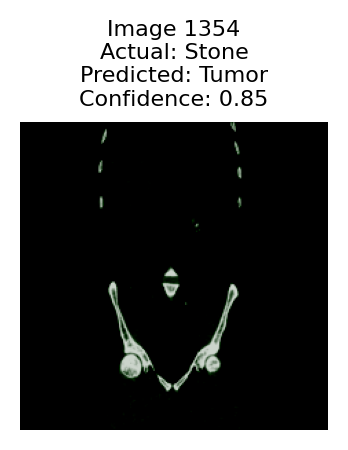

1355
Actual label: Stone
Predicted label: Tumor
Confidence: 0.9074255228042603


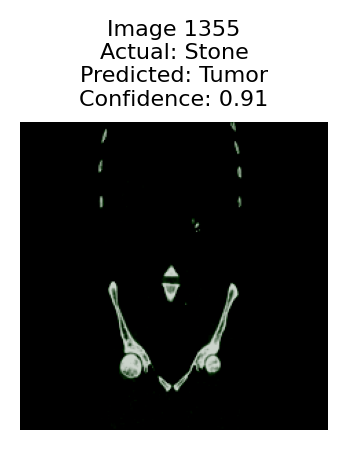

1356
Actual label: Stone
Predicted label: Tumor
Confidence: 0.7060551047325134


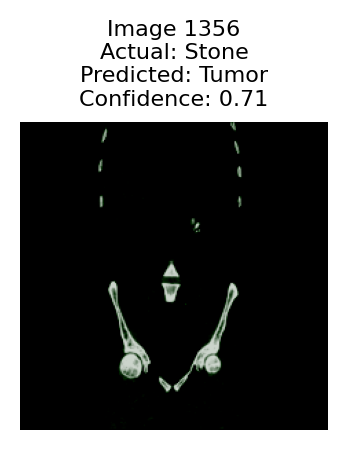

1357
Actual label: Stone
Predicted label: Stone
Confidence: 0.7239637970924377
True Prediction
1358
Actual label: Stone
Predicted label: Stone
Confidence: 0.8063853979110718
True Prediction
1359
Actual label: Stone
Predicted label: Stone
Confidence: 0.7371809482574463
True Prediction
1360
Actual label: Stone
Predicted label: Stone
Confidence: 0.9005882143974304
True Prediction
1361
Actual label: Stone
Predicted label: Stone
Confidence: 0.9475154280662537
True Prediction
1362
Actual label: Stone
Predicted label: Stone
Confidence: 0.966793954372406
True Prediction
1363
Actual label: Stone
Predicted label: Stone
Confidence: 0.9549869298934937
True Prediction
1364
Actual label: Stone
Predicted label: Stone
Confidence: 0.8731354475021362
True Prediction
1365
Actual label: Stone
Predicted label: Stone
Confidence: 0.7245297431945801
True Prediction
1366
Actual label: Stone
Predicted label: Stone
Confidence: 0.8622003197669983
True Prediction
1367
Actual label: Stone
Predicted label: Stone
Con

1377
Actual label: Stone
Predicted label: Stone
Confidence: 0.9814528226852417
True Prediction
1378
Actual label: Stone
Predicted label: Stone
Confidence: 0.9747841358184814
True Prediction
1379
Actual label: Stone
Predicted label: Stone
Confidence: 0.970805287361145
True Prediction
1380
Actual label: Stone
Predicted label: Stone
Confidence: 0.9826444983482361
True Prediction
1381
Actual label: Stone
Predicted label: Stone
Confidence: 0.9896320104598999
True Prediction
1382
Actual label: Stone
Predicted label: Stone
Confidence: 0.9927171468734741
True Prediction
1383
Actual label: Stone
Predicted label: Stone
Confidence: 0.9909891486167908
True Prediction
1384
Actual label: Stone
Predicted label: Stone
Confidence: 0.9677330255508423
True Prediction
1385
Actual label: Stone
Predicted label: Stone
Confidence: 0.9388145208358765
True Prediction
1386
Actual label: Stone
Predicted label: Cyst
Confidence: 0.8161965608596802


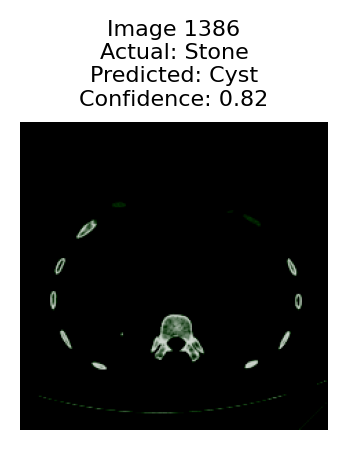

1387
Actual label: Stone
Predicted label: Cyst
Confidence: 0.6639054417610168


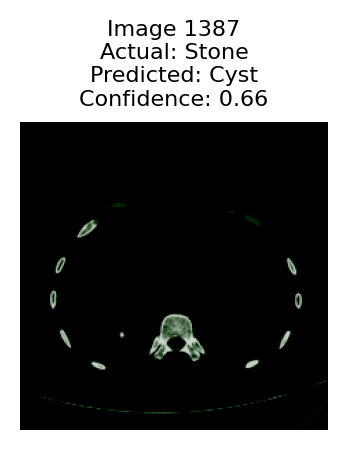

1388
Actual label: Stone
Predicted label: Cyst
Confidence: 0.5918488502502441


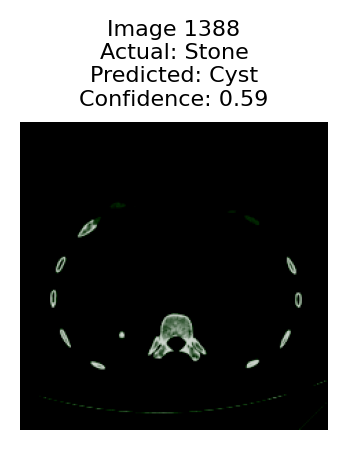

1389
Actual label: Stone
Predicted label: Stone
Confidence: 0.8215203285217285
True Prediction
1390
Actual label: Stone
Predicted label: Stone
Confidence: 0.9489014744758606
True Prediction
1391
Actual label: Stone
Predicted label: Stone
Confidence: 0.9888417720794678
True Prediction
1392
Actual label: Stone
Predicted label: Stone
Confidence: 0.99427729845047
True Prediction
1393
Actual label: Stone
Predicted label: Stone
Confidence: 0.9966711401939392
True Prediction
1394
Actual label: Stone
Predicted label: Stone
Confidence: 0.9968308806419373
True Prediction
1395
Actual label: Stone
Predicted label: Stone
Confidence: 0.997162401676178
True Prediction
1396
Actual label: Stone
Predicted label: Stone
Confidence: 0.9961238503456116
True Prediction
1397
Actual label: Stone
Predicted label: Stone
Confidence: 0.9968344569206238
True Prediction
1398
Actual label: Stone
Predicted label: Stone
Confidence: 0.9981689453125
True Prediction
1399
Actual label: Stone
Predicted label: Stone
Confiden

1409
Actual label: Stone
Predicted label: Stone
Confidence: 0.9859100580215454
True Prediction
1410
Actual label: Stone
Predicted label: Stone
Confidence: 0.9893128275871277
True Prediction
1411
Actual label: Stone
Predicted label: Stone
Confidence: 0.9951682090759277
True Prediction
1412
Actual label: Stone
Predicted label: Stone
Confidence: 0.9933579564094543
True Prediction
1413
Actual label: Stone
Predicted label: Stone
Confidence: 0.9914824962615967
True Prediction
1414
Actual label: Stone
Predicted label: Stone
Confidence: 0.9872123599052429
True Prediction
1415
Actual label: Stone
Predicted label: Stone
Confidence: 0.9891080856323242
True Prediction
1416
Actual label: Stone
Predicted label: Stone
Confidence: 0.9678096175193787
True Prediction
1417
Actual label: Stone
Predicted label: Stone
Confidence: 0.9123590588569641
True Prediction
1418
Actual label: Stone
Predicted label: Stone
Confidence: 0.8142096400260925
True Prediction
1419
Actual label: Stone
Predicted label: Stone
Co

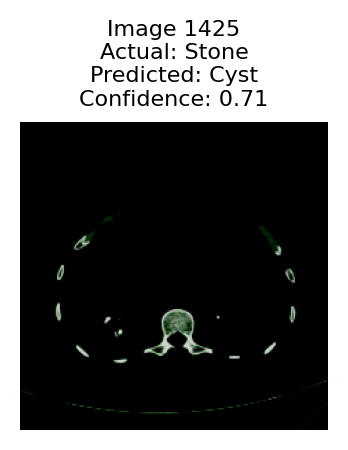

1426
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9767115116119385


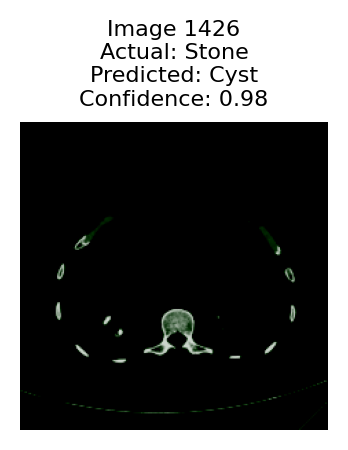

1427
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9884605407714844


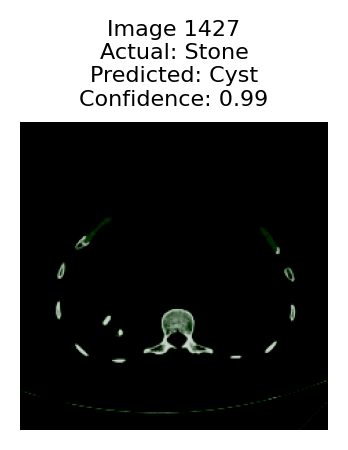

1428
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9795658588409424


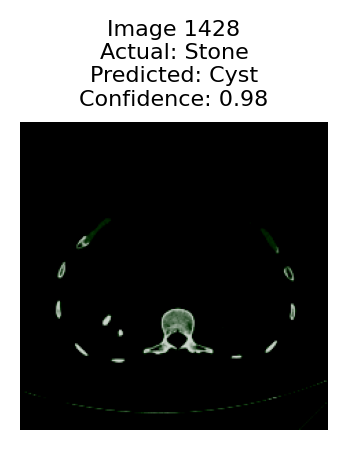

1429
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9817962050437927


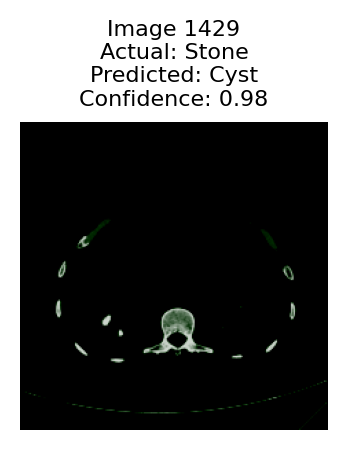

1430
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9233596324920654


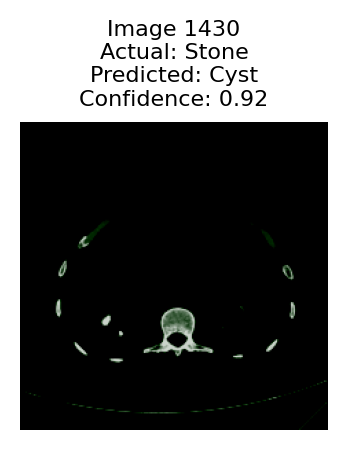

1431
Actual label: Stone
Predicted label: Stone
Confidence: 0.9063397645950317
True Prediction
1432
Actual label: Stone
Predicted label: Stone
Confidence: 0.8411309123039246
True Prediction
1433
Actual label: Stone
Predicted label: Cyst
Confidence: 0.8950572609901428


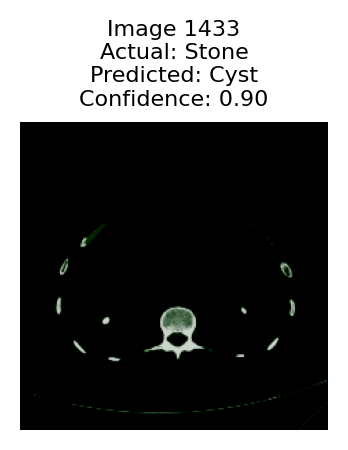

1434
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9358928799629211


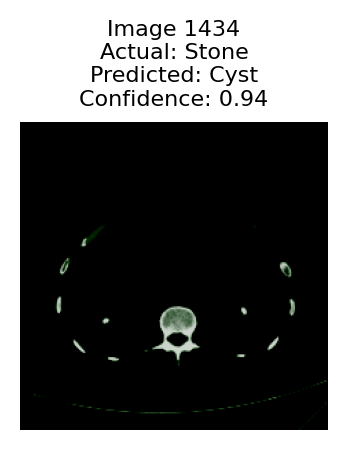

1435
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9505559802055359


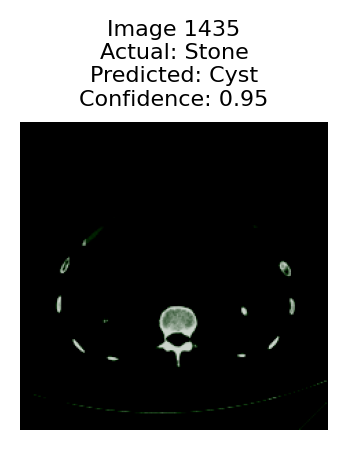

1436
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9631880521774292


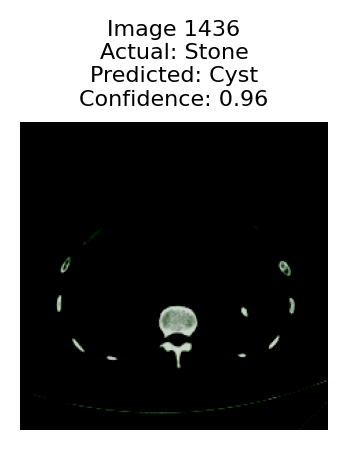

1437
Actual label: Stone
Predicted label: Stone
Confidence: 0.7727601528167725
True Prediction
1438
Actual label: Stone
Predicted label: Stone
Confidence: 0.953887939453125
True Prediction
1439
Actual label: Stone
Predicted label: Stone
Confidence: 0.9880592226982117
True Prediction
1440
Actual label: Stone
Predicted label: Stone
Confidence: 0.9932709336280823
True Prediction


1441
Actual label: Stone
Predicted label: Stone
Confidence: 0.9659065008163452
True Prediction
1442
Actual label: Stone
Predicted label: Stone
Confidence: 0.9674930572509766
True Prediction
1443
Actual label: Stone
Predicted label: Stone
Confidence: 0.9954361319541931
True Prediction
1444
Actual label: Stone
Predicted label: Stone
Confidence: 0.9922184944152832
True Prediction
1445
Actual label: Stone
Predicted label: Stone
Confidence: 0.963206946849823
True Prediction
1446
Actual label: Stone
Predicted label: Stone
Confidence: 0.9871379137039185
True Prediction
1447
Actual label: Stone
Predicted label: Stone
Confidence: 0.9874998927116394
True Prediction
1448
Actual label: Stone
Predicted label: Stone
Confidence: 0.982441246509552
True Prediction
1449
Actual label: Stone
Predicted label: Cyst
Confidence: 0.7750015258789062


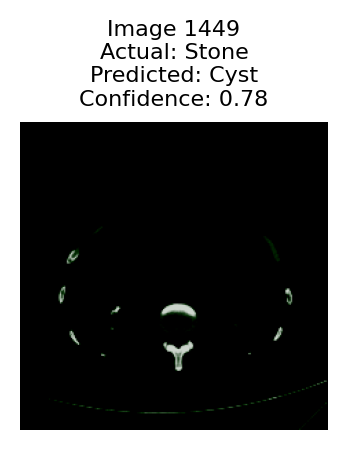

1450
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9797011613845825


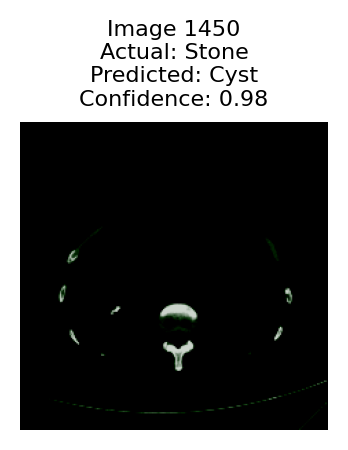

1451
Actual label: Stone
Predicted label: Cyst
Confidence: 0.7782493233680725


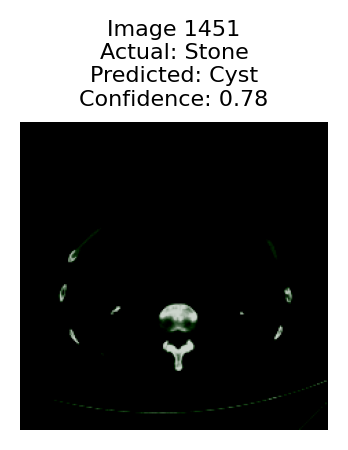

1452
Actual label: Stone
Predicted label: Stone
Confidence: 0.6137123107910156
True Prediction
1453
Actual label: Stone
Predicted label: Stone
Confidence: 0.9519790410995483
True Prediction
1454
Actual label: Stone
Predicted label: Stone
Confidence: 0.665879487991333
True Prediction
1455
Actual label: Stone
Predicted label: Stone
Confidence: 0.5510730743408203
True Prediction
1456
Actual label: Stone
Predicted label: Stone
Confidence: 0.709915816783905
True Prediction
1457
Actual label: Stone
Predicted label: Stone
Confidence: 0.9800980091094971
True Prediction
1458
Actual label: Stone
Predicted label: Stone
Confidence: 0.9912774562835693
True Prediction
1459
Actual label: Stone
Predicted label: Stone
Confidence: 0.9780274629592896
True Prediction
1460
Actual label: Stone
Predicted label: Stone
Confidence: 0.9512550830841064
True Prediction
1461
Actual label: Stone
Predicted label: Stone
Confidence: 0.9715334177017212
True Prediction
1462
Actual label: Stone
Predicted label: Stone
Conf

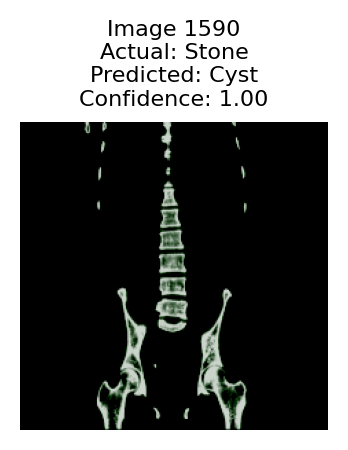

1591
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9969717264175415


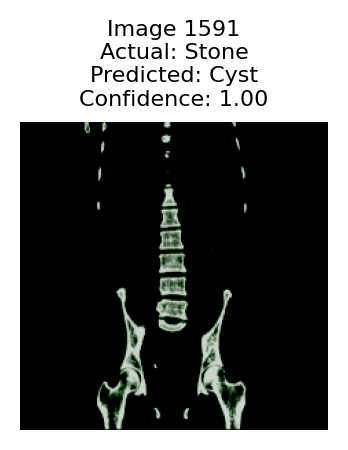

1592
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9979566335678101


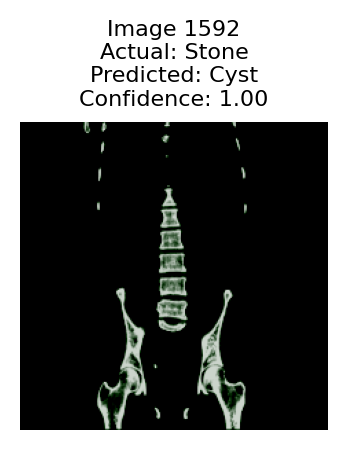

1593
Actual label: Stone
Predicted label: Stone
Confidence: 0.9795715808868408
True Prediction
1594
Actual label: Stone
Predicted label: Stone
Confidence: 0.9753400087356567
True Prediction
1595
Actual label: Stone
Predicted label: Stone
Confidence: 0.9826846718788147
True Prediction
1596
Actual label: Stone
Predicted label: Stone
Confidence: 0.9935905933380127
True Prediction
1597
Actual label: Stone
Predicted label: Stone
Confidence: 0.910942792892456
True Prediction
1598
Actual label: Stone
Predicted label: Cyst
Confidence: 0.6367760896682739


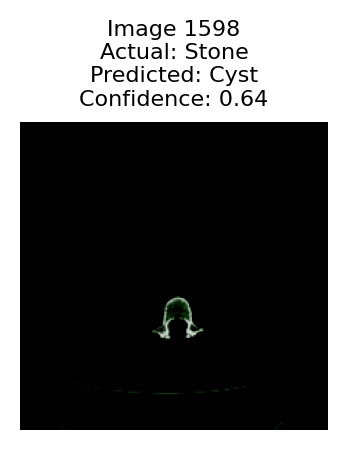

1599
Actual label: Stone
Predicted label: Stone
Confidence: 0.9795715808868408
True Prediction
1600
Actual label: Stone
Predicted label: Stone
Confidence: 0.9753400087356567
True Prediction


1601
Actual label: Stone
Predicted label: Stone
Confidence: 0.9826846718788147
True Prediction
1602
Actual label: Stone
Predicted label: Stone
Confidence: 0.9935905933380127
True Prediction
1603
Actual label: Stone
Predicted label: Stone
Confidence: 0.910942792892456
True Prediction
1604
Actual label: Stone
Predicted label: Cyst
Confidence: 0.6367760896682739


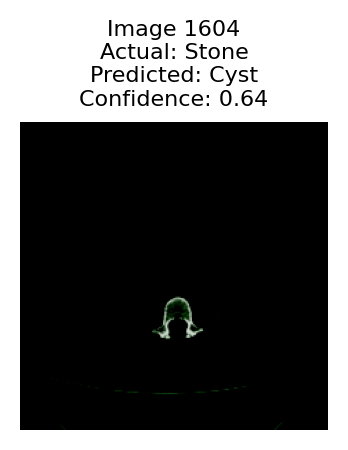

1605
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9590242505073547


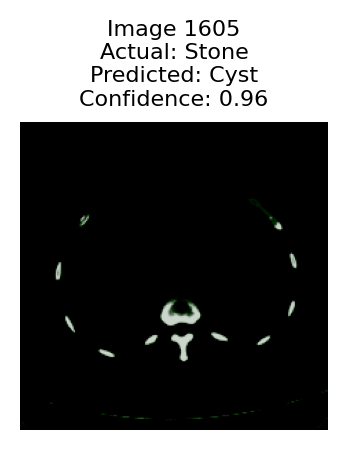

1606
Actual label: Stone
Predicted label: Stone
Confidence: 0.9874140024185181
True Prediction
1607
Actual label: Stone
Predicted label: Stone
Confidence: 0.9888520836830139
True Prediction
1608
Actual label: Stone
Predicted label: Stone
Confidence: 0.97797691822052
True Prediction
1609
Actual label: Stone
Predicted label: Stone
Confidence: 0.9797975420951843
True Prediction
1610
Actual label: Stone
Predicted label: Stone
Confidence: 0.972118616104126
True Prediction
1611
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9997592568397522


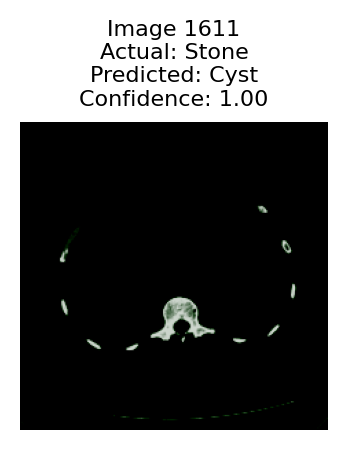

1612
Actual label: Stone
Predicted label: Stone
Confidence: 0.5732516646385193
True Prediction
1613
Actual label: Stone
Predicted label: Stone
Confidence: 0.5428227782249451
True Prediction
1614
Actual label: Stone
Predicted label: Stone
Confidence: 0.5314617156982422
True Prediction
1615
Actual label: Stone
Predicted label: Cyst
Confidence: 0.5798640847206116


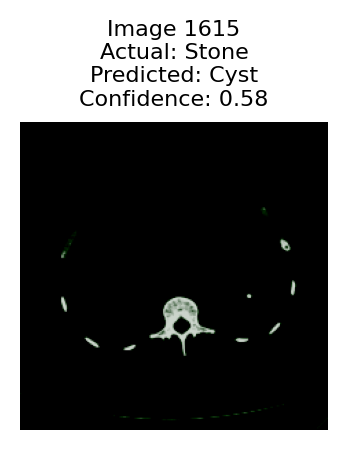

1616
Actual label: Stone
Predicted label: Stone
Confidence: 0.6574493646621704
True Prediction
1617
Actual label: Stone
Predicted label: Cyst
Confidence: 0.5515257120132446


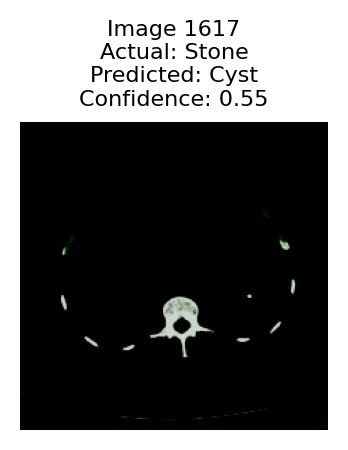

1618
Actual label: Stone
Predicted label: Cyst
Confidence: 0.7916324734687805


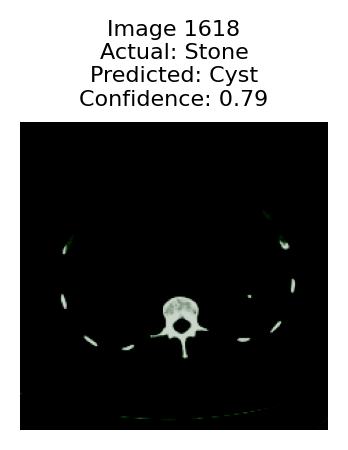

1619
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9527350068092346


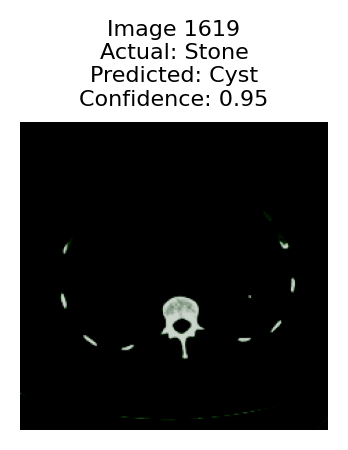

1620
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9998558759689331


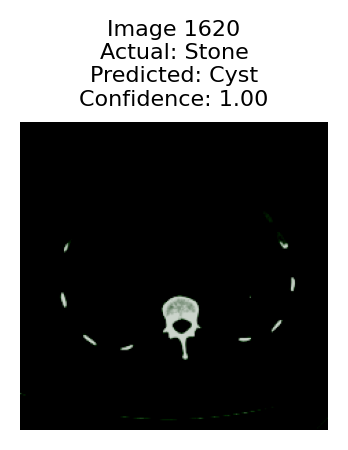

1621
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9195804595947266


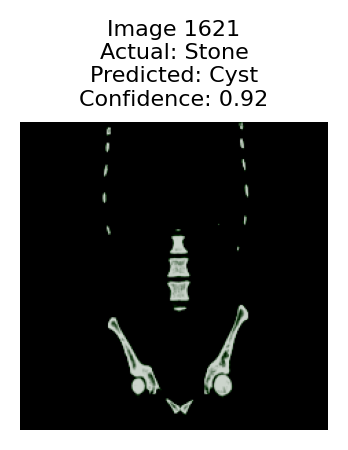

1622
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9469552636146545


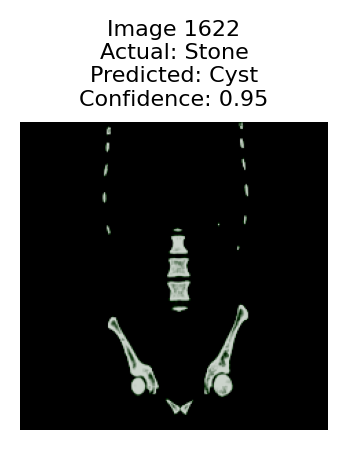

1623
Actual label: Stone
Predicted label: Cyst
Confidence: 0.8183097839355469


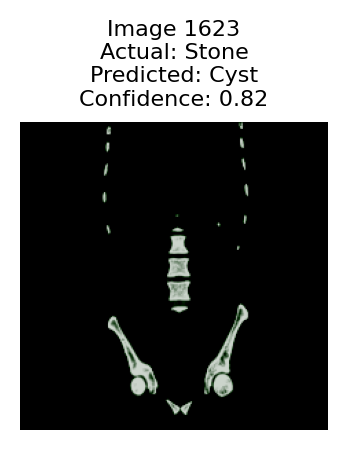

1624
Actual label: Stone
Predicted label: Cyst
Confidence: 0.848074197769165


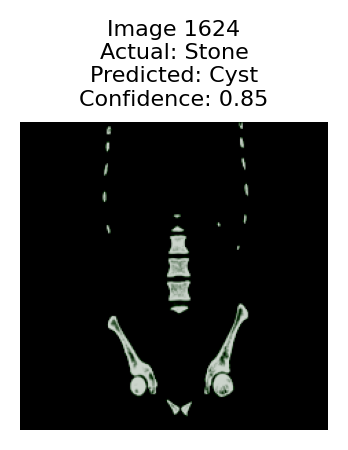

1625
Actual label: Stone
Predicted label: Cyst
Confidence: 0.744805097579956


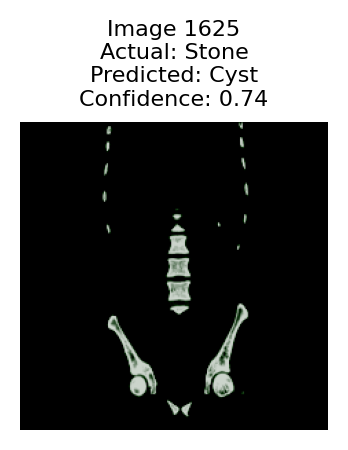

1626
Actual label: Stone
Predicted label: Stone
Confidence: 0.5043210983276367
True Prediction
1627
Actual label: Stone
Predicted label: Stone
Confidence: 0.5875369310379028
True Prediction
1628
Actual label: Stone
Predicted label: Cyst
Confidence: 0.6916279792785645


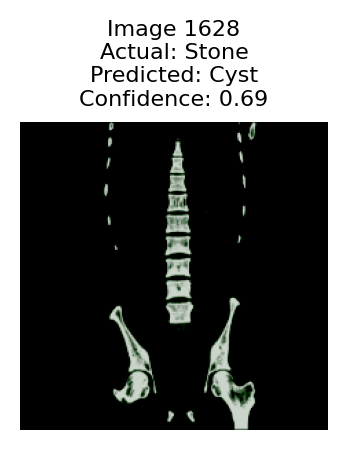

1629
Actual label: Stone
Predicted label: Stone
Confidence: 0.9917978048324585
True Prediction
1630
Actual label: Stone
Predicted label: Stone
Confidence: 0.9912296533584595
True Prediction
1631
Actual label: Stone
Predicted label: Stone
Confidence: 0.9742807745933533
True Prediction
1632
Actual label: Stone
Predicted label: Stone
Confidence: 0.9579702019691467
True Prediction


1633
Actual label: Stone
Predicted label: Cyst
Confidence: 0.7387181520462036


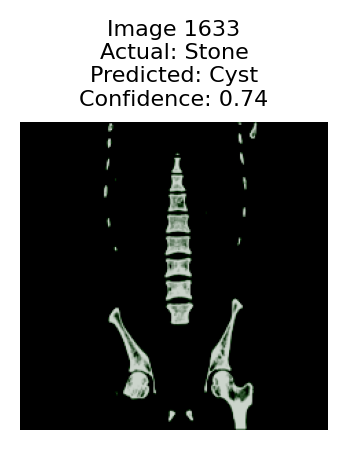

1634
Actual label: Stone
Predicted label: Stone
Confidence: 0.9878774881362915
True Prediction
1635
Actual label: Stone
Predicted label: Stone
Confidence: 0.9986217021942139
True Prediction
1636
Actual label: Stone
Predicted label: Stone
Confidence: 0.9973928928375244
True Prediction
1637
Actual label: Stone
Predicted label: Stone
Confidence: 0.9858295321464539
True Prediction
1638
Actual label: Stone
Predicted label: Stone
Confidence: 0.8505606651306152
True Prediction
1639
Actual label: Stone
Predicted label: Stone
Confidence: 0.8002684116363525
True Prediction
1640
Actual label: Stone
Predicted label: Stone
Confidence: 0.7986687421798706
True Prediction
1641
Actual label: Stone
Predicted label: Stone
Confidence: 0.9164632558822632
True Prediction
1642
Actual label: Stone
Predicted label: Stone
Confidence: 0.9741432070732117
True Prediction
1643
Actual label: Stone
Predicted label: Stone
Confidence: 0.9930790066719055
True Prediction
1644
Actual label: Stone
Predicted label: Stone
Co

1697
Actual label: Stone
Predicted label: Stone
Confidence: 0.9363179206848145
True Prediction
1698
Actual label: Stone
Predicted label: Stone
Confidence: 0.9426599144935608
True Prediction
1699
Actual label: Stone
Predicted label: Stone
Confidence: 0.9618873596191406
True Prediction
1700
Actual label: Stone
Predicted label: Stone
Confidence: 0.9704388976097107
True Prediction
1701
Actual label: Stone
Predicted label: Stone
Confidence: 0.9778982996940613
True Prediction
1702
Actual label: Stone
Predicted label: Stone
Confidence: 0.9604572653770447
True Prediction
1703
Actual label: Stone
Predicted label: Stone
Confidence: 0.9530016183853149
True Prediction
1704
Actual label: Stone
Predicted label: Stone
Confidence: 0.9680299758911133
True Prediction
1705
Actual label: Stone
Predicted label: Stone
Confidence: 0.9913376569747925
True Prediction
1706
Actual label: Stone
Predicted label: Stone
Confidence: 0.9989205598831177
True Prediction
1707
Actual label: Stone
Predicted label: Stone
Co

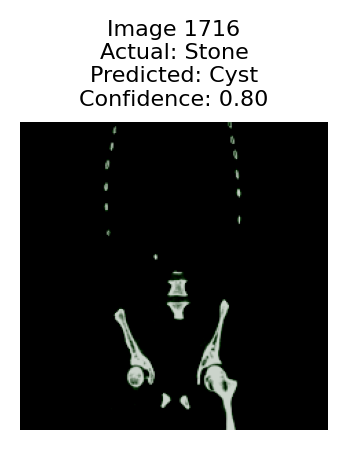

1717
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9218170642852783


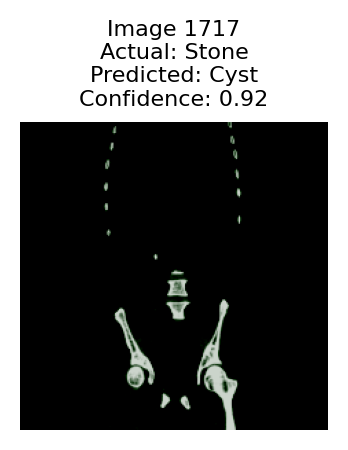

1718
Actual label: Stone
Predicted label: Cyst
Confidence: 0.7830318212509155


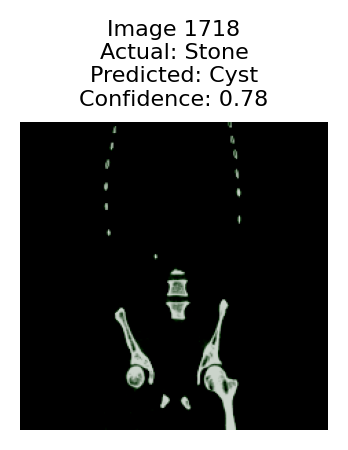

1719
Actual label: Stone
Predicted label: Cyst
Confidence: 0.8791465759277344


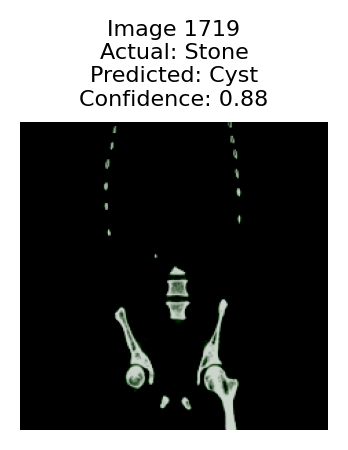

1720
Actual label: Stone
Predicted label: Cyst
Confidence: 0.6165518760681152


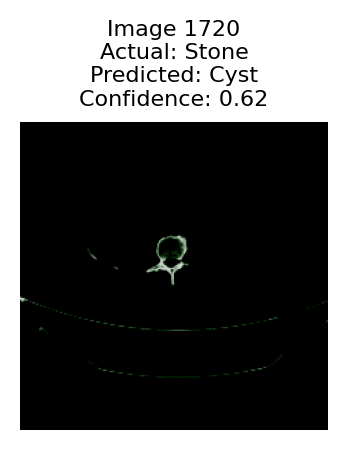

1721
Actual label: Stone
Predicted label: Stone
Confidence: 0.9982074499130249
True Prediction
1722
Actual label: Stone
Predicted label: Stone
Confidence: 0.9990746974945068
True Prediction
1723
Actual label: Stone
Predicted label: Stone
Confidence: 0.9992766976356506
True Prediction
1724
Actual label: Stone
Predicted label: Stone
Confidence: 0.9856018424034119
True Prediction
1725
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9930642247200012


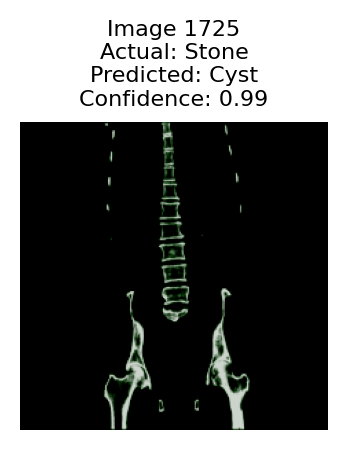

1726
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9926968216896057


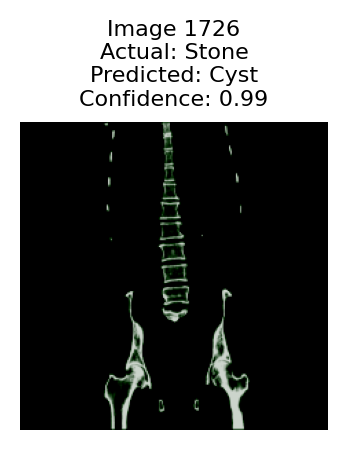

1727
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9930210709571838


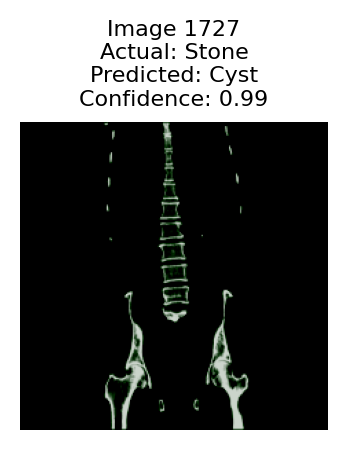

1728
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9910327792167664


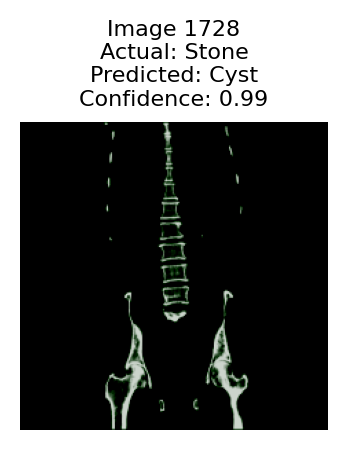

1729
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9965452551841736


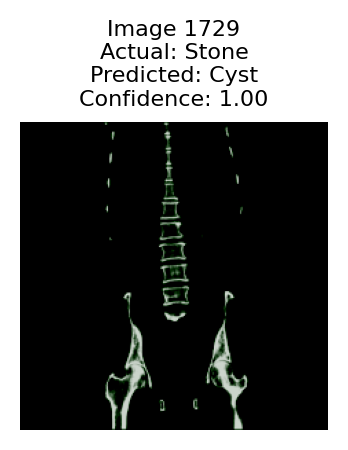

1730
Actual label: Stone
Predicted label: Stone
Confidence: 0.998429000377655
True Prediction
1731
Actual label: Stone
Predicted label: Stone
Confidence: 0.9992051720619202
True Prediction
1732
Actual label: Stone
Predicted label: Stone
Confidence: 0.9998034834861755
True Prediction
1733
Actual label: Stone
Predicted label: Stone
Confidence: 0.9998267292976379
True Prediction
1734
Actual label: Stone
Predicted label: Stone
Confidence: 0.9997835755348206
True Prediction
1735
Actual label: Stone
Predicted label: Stone
Confidence: 0.9997990727424622
True Prediction
1736
Actual label: Stone
Predicted label: Stone
Confidence: 0.9998477697372437
True Prediction
1737
Actual label: Stone
Predicted label: Stone
Confidence: 0.9997710585594177
True Prediction
1738
Actual label: Stone
Predicted label: Stone
Confidence: 0.9997138381004333
True Prediction
1739
Actual label: Stone
Predicted label: Stone
Confidence: 0.9935093522071838
True Prediction
1740
Actual label: Stone
Predicted label: Stone
Con

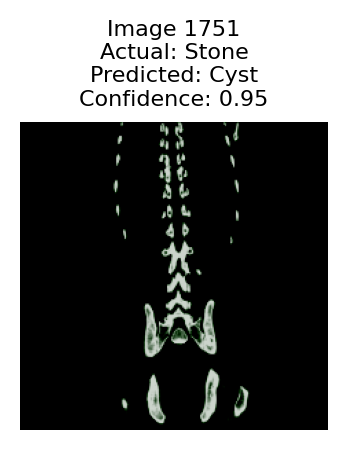

1752
Actual label: Stone
Predicted label: Stone
Confidence: 0.9746144413948059
True Prediction
1753
Actual label: Stone
Predicted label: Stone
Confidence: 0.9908803701400757
True Prediction
1754
Actual label: Stone
Predicted label: Stone
Confidence: 0.9916349649429321
True Prediction
1755
Actual label: Stone
Predicted label: Stone
Confidence: 0.790198028087616
True Prediction
1756
Actual label: Stone
Predicted label: Stone
Confidence: 0.6341179609298706
True Prediction
1757
Actual label: Stone
Predicted label: Cyst
Confidence: 0.8704537153244019


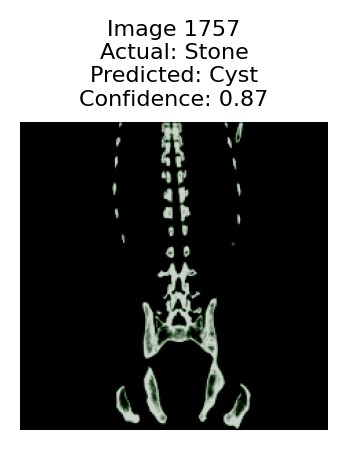

1758
Actual label: Stone
Predicted label: Stone
Confidence: 0.9298969507217407
True Prediction
1759
Actual label: Stone
Predicted label: Stone
Confidence: 0.9860910773277283
True Prediction
1760
Actual label: Stone
Predicted label: Stone
Confidence: 0.9870405793190002
True Prediction


1761
Actual label: Stone
Predicted label: Stone
Confidence: 0.9515606164932251
True Prediction
1762
Actual label: Stone
Predicted label: Stone
Confidence: 0.9951573014259338
True Prediction
1763
Actual label: Stone
Predicted label: Stone
Confidence: 0.993374764919281
True Prediction
1764
Actual label: Stone
Predicted label: Stone
Confidence: 0.9962201714515686
True Prediction
1765
Actual label: Stone
Predicted label: Stone
Confidence: 0.9956876635551453
True Prediction
1766
Actual label: Stone
Predicted label: Stone
Confidence: 0.9678177833557129
True Prediction
1767
Actual label: Stone
Predicted label: Stone
Confidence: 0.9243776798248291
True Prediction
1768
Actual label: Stone
Predicted label: Stone
Confidence: 0.9492148160934448
True Prediction
1769
Actual label: Stone
Predicted label: Stone
Confidence: 0.9549034237861633
True Prediction
1770
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9999105930328369


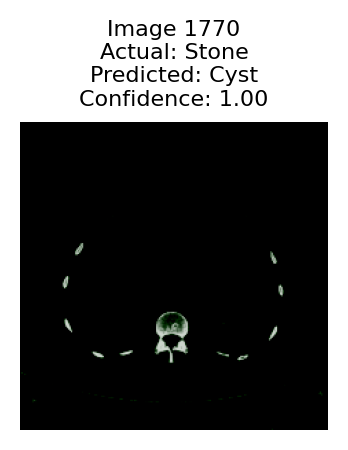

1771
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9988170862197876


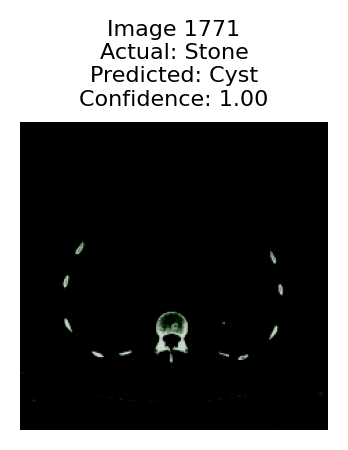

1772
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9984666109085083


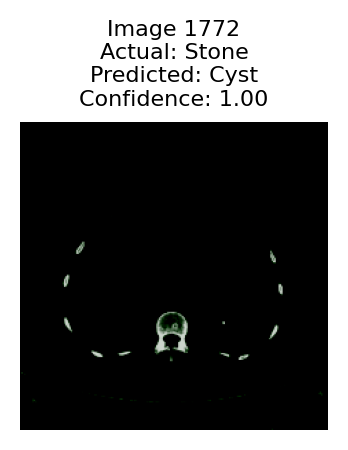

1773
Actual label: Stone
Predicted label: Cyst
Confidence:

 0.9979248046875


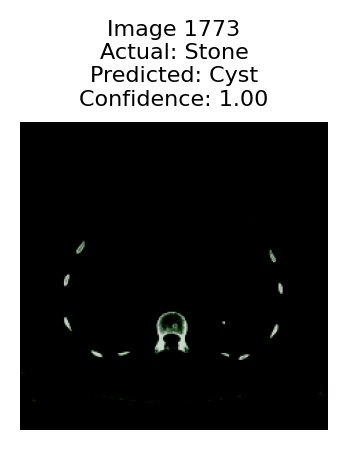

1774
Actual label: Stone
Predicted label: Cyst
Confidence: 0.997252881526947


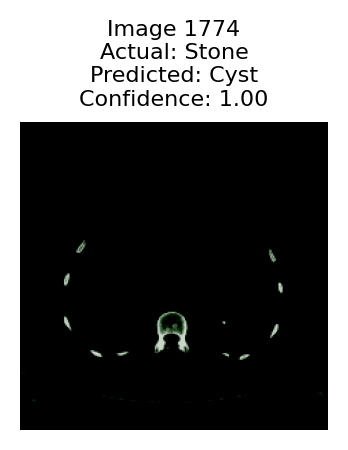

1775
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9964691400527954


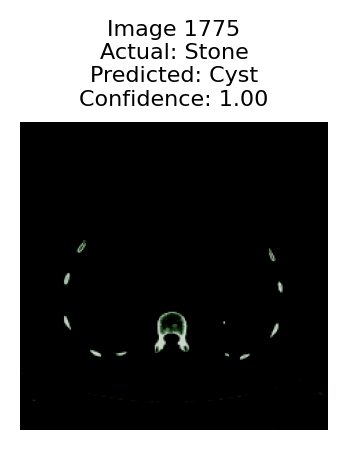

1776
Actual label: Stone
Predicted label: Cyst


Confidence: 0.9986975193023682


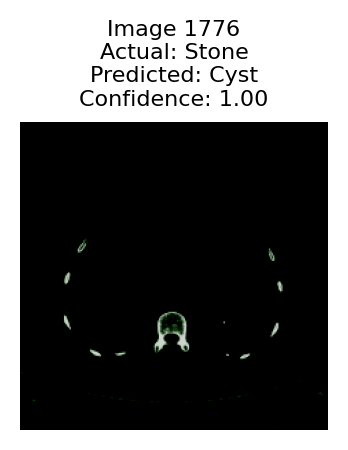

1777
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9998970031738281


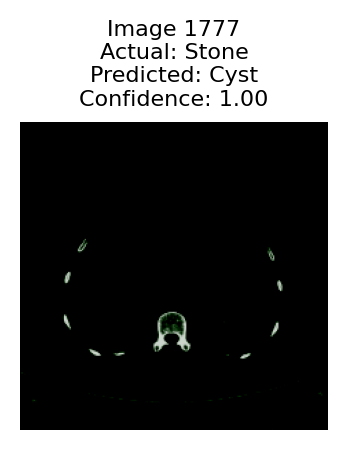

1778
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9998838901519775


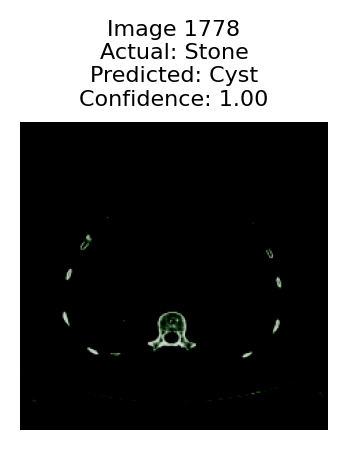

1779
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9998103976249695


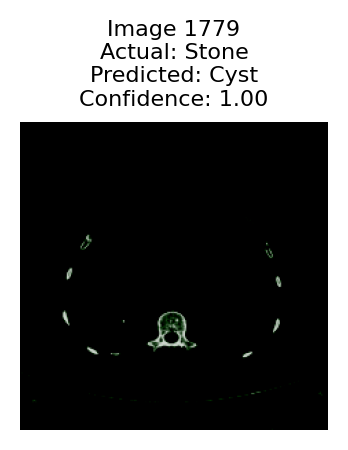

1780
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9996954202651978


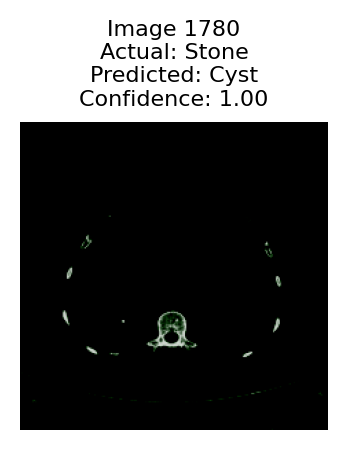

1781
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9997159838676453


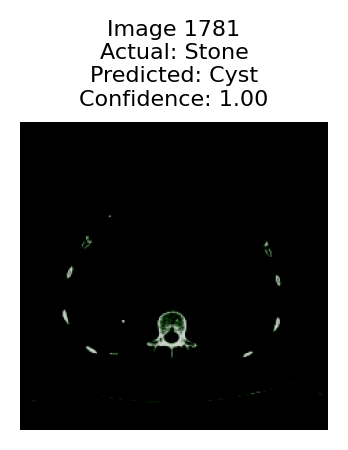

1782
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9998382329940796


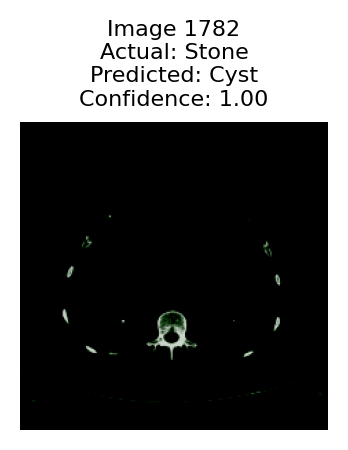

1783
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9999051094055176


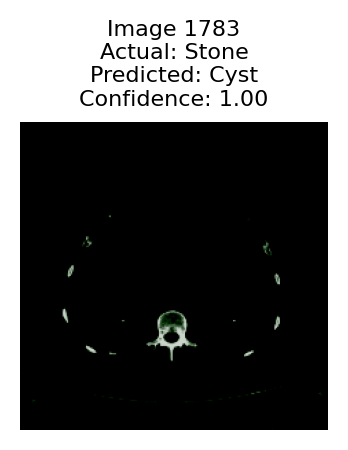

1784
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9999270439147949


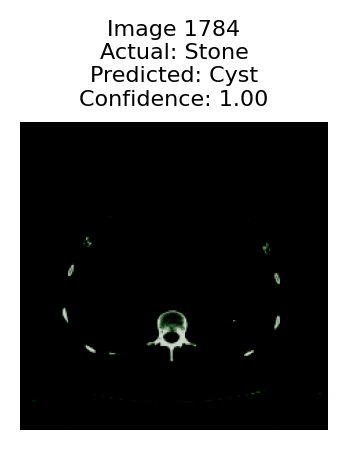

1785
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9999465942382812


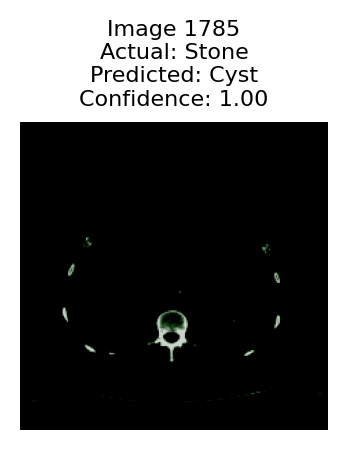

1786
Actual label: Stone
Predicted label: Cyst
Confidence: 0.8624139428138733


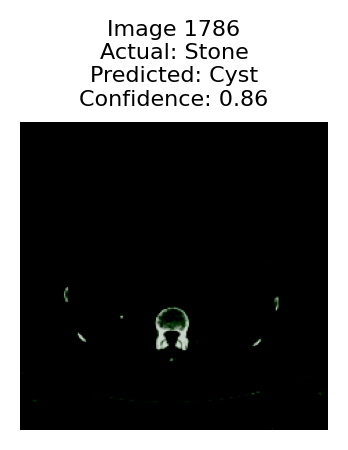

1787
Actual label: Stone
Predicted label: Cyst


Confidence: 0.832850456237793


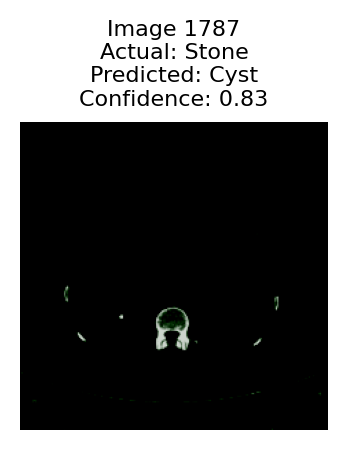

1788
Actual label: Stone
Predicted label: Cyst
Confidence: 0.8473541736602783


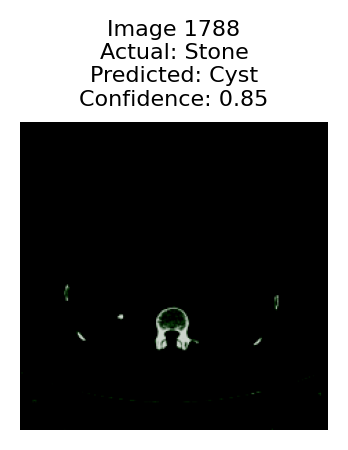

1789
Actual label: 

Stone
Predicted label: Cyst
Confidence: 0.9040369987487793


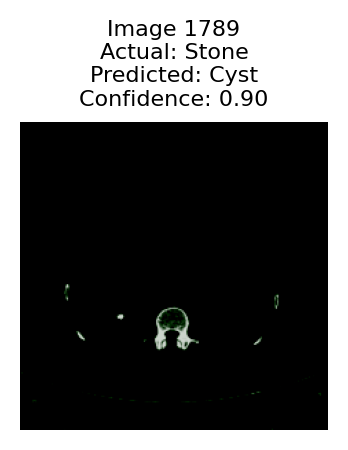

1790
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9524223804473877


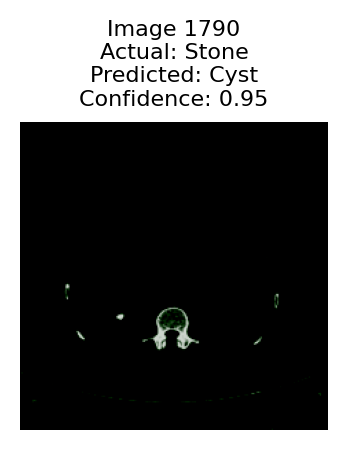

1791
Actual label: Stone


Predicted label: Cyst
Confidence: 0.949109673500061


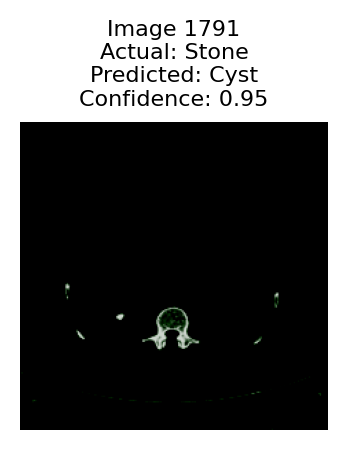

1792


Actual label: Stone
Predicted label: Cyst
Confidence: 0.8801657557487488


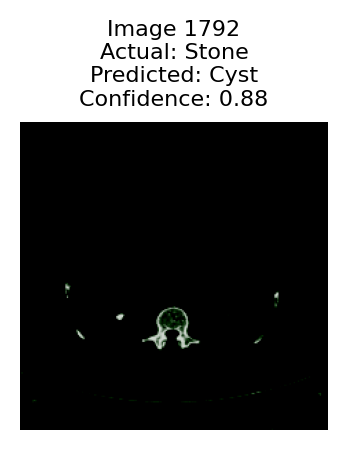

1793
Actual label: Stone
Predicted label: Cyst
Confidence: 0.8488654494285583


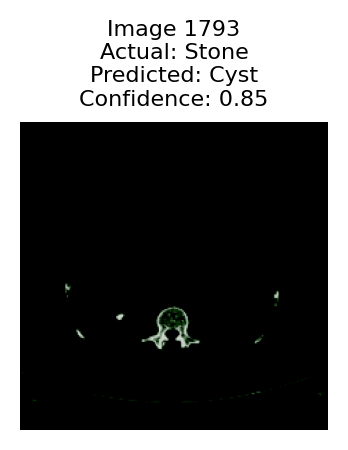

1794
Actual label: Stone
Predicted label: Cyst
Confidence: 0.8493871092796326


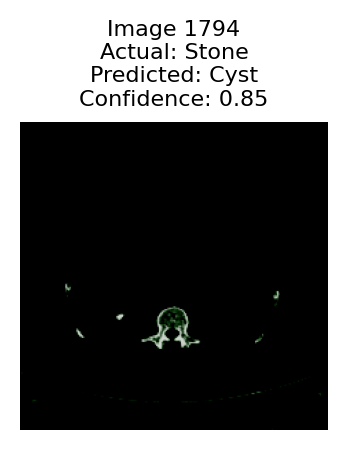

1795
Actual label: Stone
Predicted label: Cyst
Confidence: 0.7662286758422852


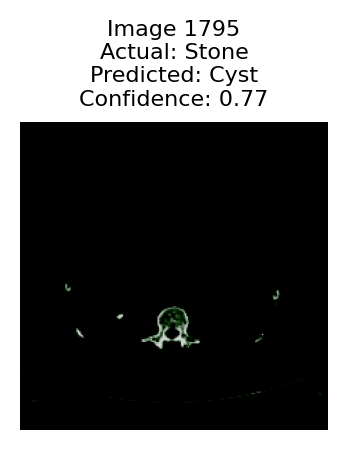

1796


Actual label: Stone
Predicted label: Cyst
Confidence: 0.8089004158973694


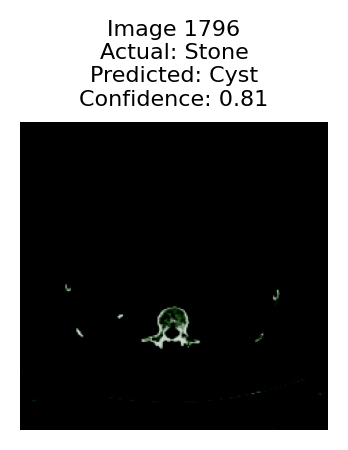

1797
Actual label: Stone
Predicted label: Cyst
Confidence: 0.7847219109535217


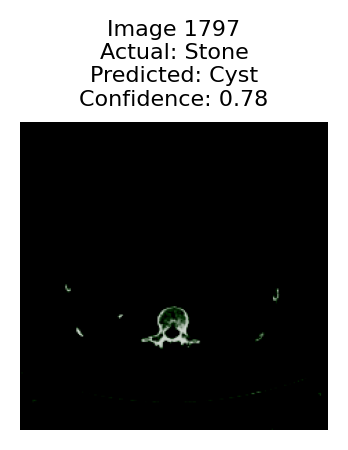

1798
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9895137548446655


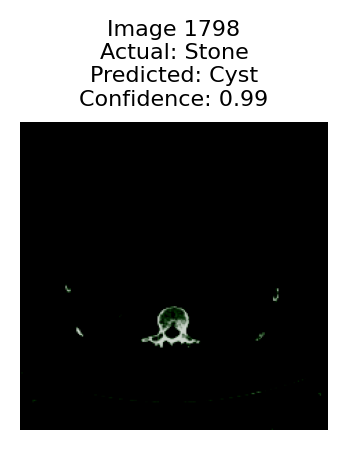

1799
Actual label: Stone
Predicted label: Stone
Confidence: 0.998900294303894
True Prediction
1800
Actual label: Stone
Predicted label: Stone
Confidence: 0.9984707236289978
True Prediction
1801
Actual label: Stone
Predicted label: Stone
Confidence: 0.9966312050819397
True Prediction
1802
Actual label: Stone
Predicted label: Stone
Confidence: 0.9951818585395813
True Prediction
1803
Actual label: Stone
Predicted label: Stone
Confidence: 0.9962791800498962
True Prediction
1804
Actual label: Stone
Predicted label: Stone
Confidence: 0.9976434111595154
True Prediction
1805
Actual label: Stone
Predicted label: Stone
Confidence: 0.9979273080825806
True Prediction
1806
Actual label: Stone
Predicted label: Stone
Confidence: 0.9940223097801208
True Prediction
1807
Actual label: Stone
Predicted label: Stone
Confidence: 0.9970736503601074
True Prediction
1808
Actual label: Stone
Predicted label: Stone
Confidence: 0.9975503087043762
True Prediction
1809
Actual label: Stone
Predicted label: Stone
Con

1825
Actual label: Stone
Predicted label: Stone
Confidence: 0.9972890615463257
True Prediction
1826
Actual label: Stone
Predicted label: Stone
Confidence: 0.9926151037216187
True Prediction
1827
Actual label: Stone
Predicted label: Stone
Confidence: 0.9932835102081299
True Prediction
1828
Actual label: Stone
Predicted label: Stone
Confidence: 0.994851291179657
True Prediction
1829
Actual label: Stone
Predicted label: Stone
Confidence: 0.9930169582366943
True Prediction
1830
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9804276823997498


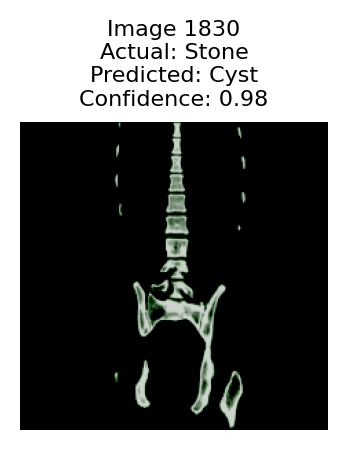

1831
Actual label: Stone
Predicted label: Stone
Confidence: 0.9995580315589905
True Prediction
1832
Actual label: Stone
Predicted label: Stone
Confidence: 0.9998835325241089
True Prediction
1833
Actual label: Stone
Predicted label: Stone
Confidence: 0.9998759031295776
True Prediction
1834
Actual label: Stone
Predicted label: Stone
Confidence: 0.9998996257781982
True Prediction
1835
Actual label: Stone
Predicted label: Stone
Confidence: 0.9999078512191772
True Prediction
1836
Actual label: Stone
Predicted label: Stone
Confidence: 0.9998965263366699
True Prediction
1837
Actual label: Stone
Predicted label: Stone
Confidence: 0.9998816251754761
True Prediction
1838
Actual label: Stone
Predicted label: Stone
Confidence: 0.9998748302459717
True Prediction
1839
Actual label: Stone
Predicted label: Stone
Confidence: 0.999882698059082
True Prediction
1840
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9880779385566711


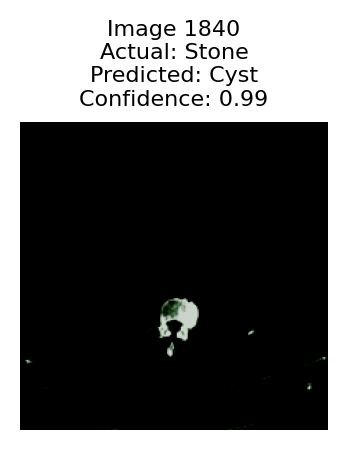

1841
Actual label: Stone
Predicted label: Cyst
Confidence: 0.7118185758590698


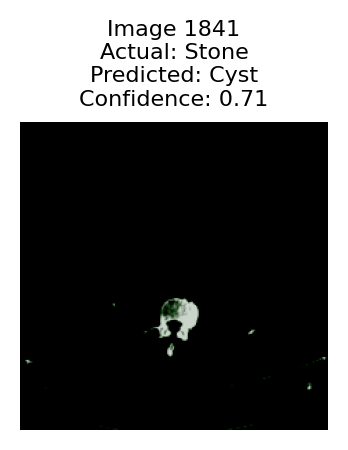

1842
Actual label: Stone
Predicted label: Cyst
Confidence: 0.8533627390861511


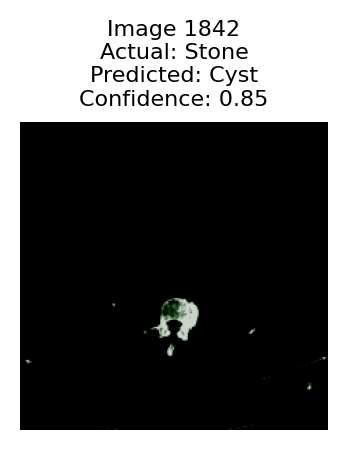

1843
Actual label: Stone
Predicted label: Cyst
Confidence: 0.8876119256019592


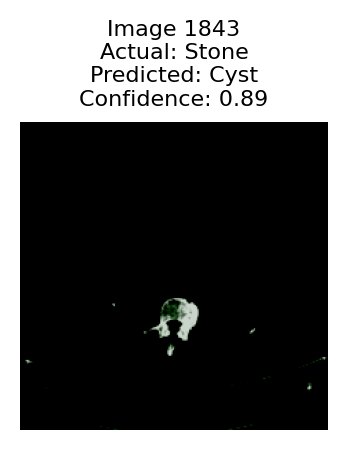

1844
Actual label: Stone
Predicted label: Cyst
Confidence: 0.843816876411438


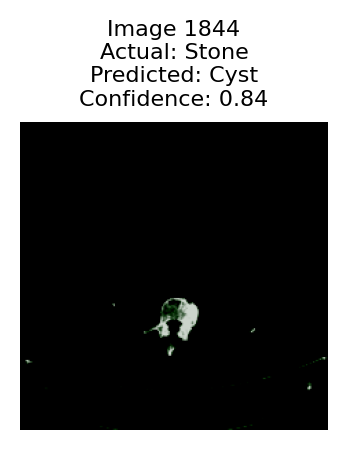

1845
Actual label: Stone
Predicted label: Cyst
Confidence: 0.8800251483917236


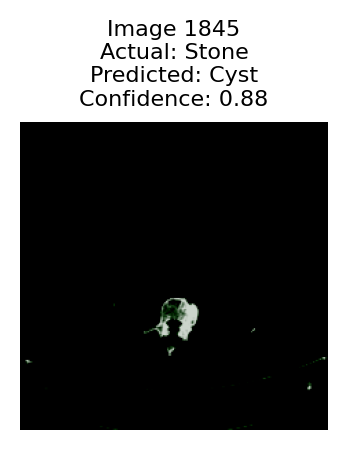

1846
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9997511506080627


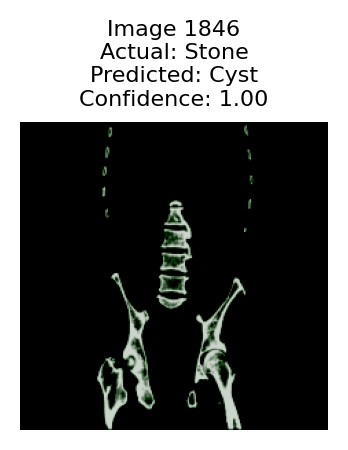

1847
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9992983341217041


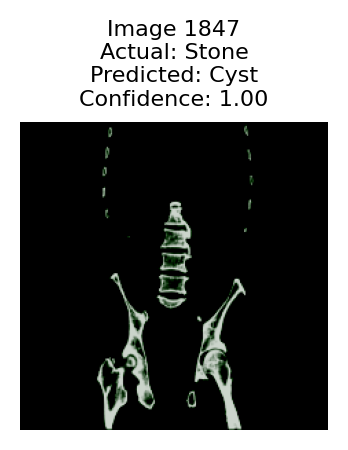

1848
Actual label: Stone
Predicted label: Cyst
Confidence: 0.998259961605072


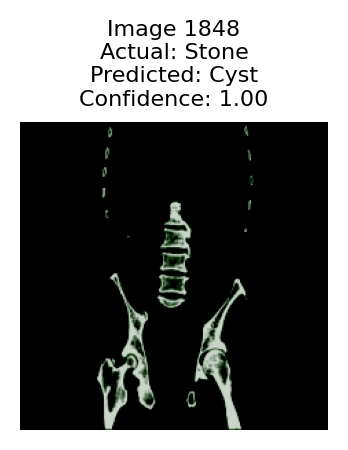

1849
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9991636276245117


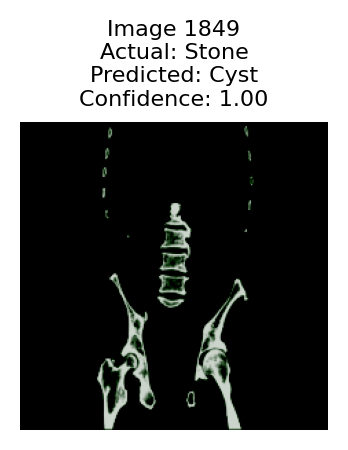

1850
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9993010759353638


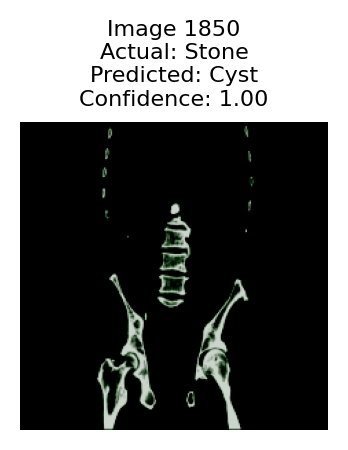

1851
Actual label: Stone
Predicted label: Cyst
Confidence: 0.9994199275970459


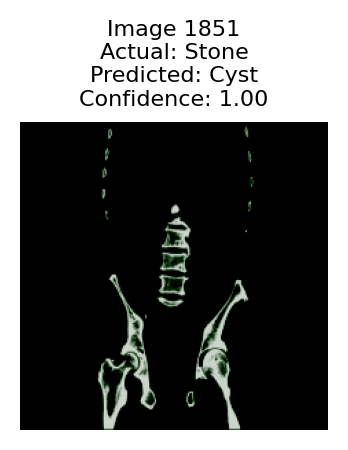

1852
Actual label: Stone
Predicted label: Stone
Confidence: 0.9954817295074463
True Prediction
1853
Actual label: Stone
Predicted label: Stone
Confidence: 0.9986910223960876
True Prediction
1854
Actual label: Stone
Predicted label: Stone
Confidence: 0.9983211159706116
True Prediction
1855
Actual label: Stone
Predicted label: Stone
Confidence: 0.9965910911560059
True Prediction
1856
Actual label: Stone
Predicted label: Stone
Confidence: 0.9972819089889526
True Prediction


1857
Actual label: Stone
Predicted label: Stone
Confidence: 0.9966281056404114
True Prediction
1858
Actual label: Stone
Predicted label: Stone
Confidence: 0.9966281056404114
True Prediction
1859
Actual label: Stone
Predicted label: Stone
Confidence: 0.9986675977706909
True Prediction
1860
Actual label: Stone
Predicted label: Stone
Confidence: 0.9991430044174194
True Prediction
1861
Actual label: Stone
Predicted label: Stone
Confidence: 0.999316930770874
True Prediction
1862
Actual label: Stone
Predicted label: Stone
Confidence: 0.999366819858551
True Prediction
1863
Actual label: Stone
Predicted label: Stone
Confidence: 0.9991655349731445
True Prediction
1864
Actual label: Tumor
Predicted label: Normal
Confidence: 0.7021132707595825


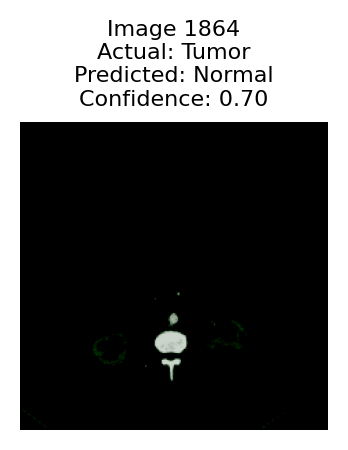

1865
Actual label: Tumor
Predicted label: Normal
Confidence: 0.7165319323539734


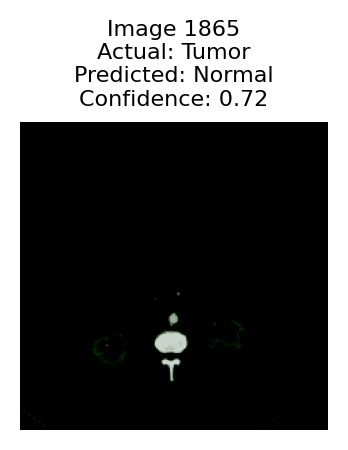

1866
Actual label: Tumor
Predicted label: Normal
Confidence: 0.6628453135490417


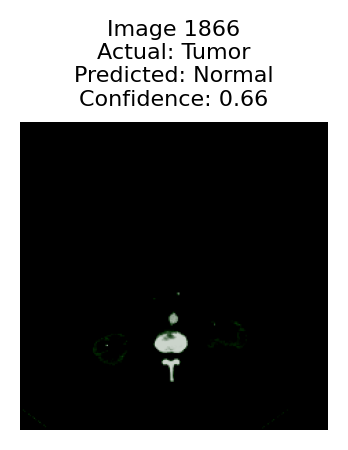

1867
Actual label: Tumor
Predicted label: Normal
Confidence: 0.6847251057624817


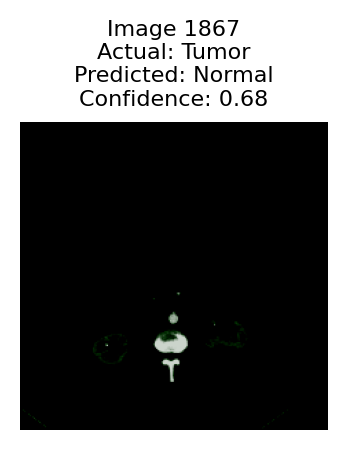

1868
Actual label: Tumor
Predicted label: Stone
Confidence: 0.49800077080726624


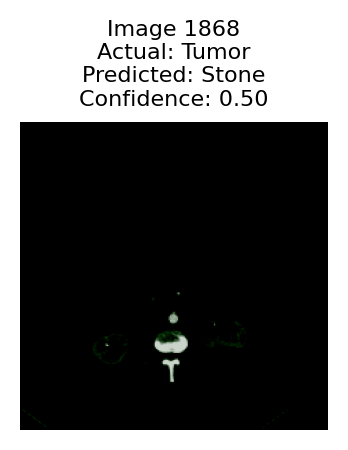

1869
Actual label: Tumor
Predicted label: Normal
Confidence: 0.6921511888504028


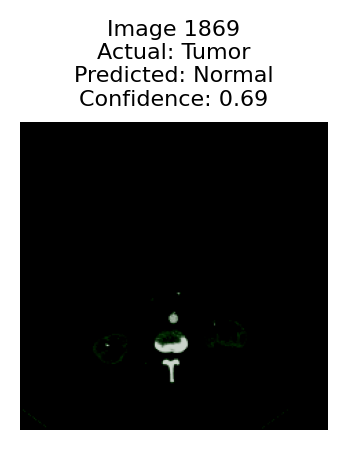

1870
Actual label: Tumor
Predicted label: Normal
Confidence: 0.7800033092498779


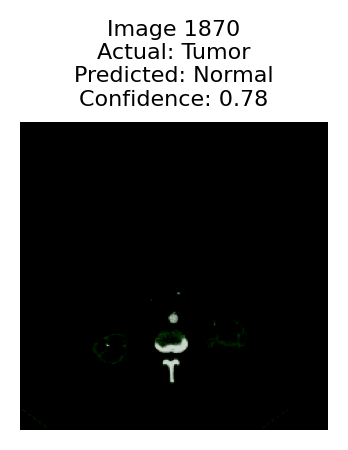

1871
Actual label: Tumor
Predicted label: Normal
Confidence: 0.838803768157959


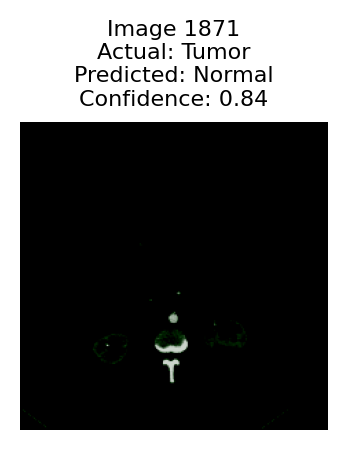

1872
Actual label: Tumor
Predicted label: Normal
Confidence: 0.8102052807807922


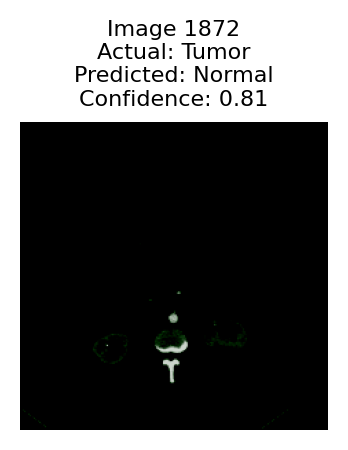

1873
Actual label: Tumor
Predicted label: Normal
Confidence: 0.8179325461387634


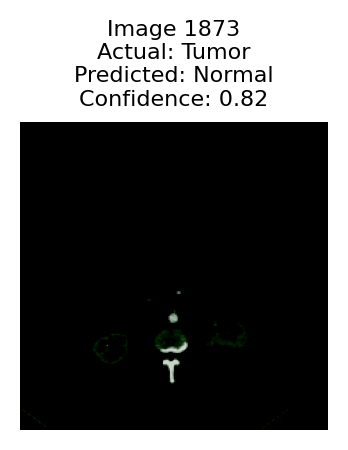

1874
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9630631804466248


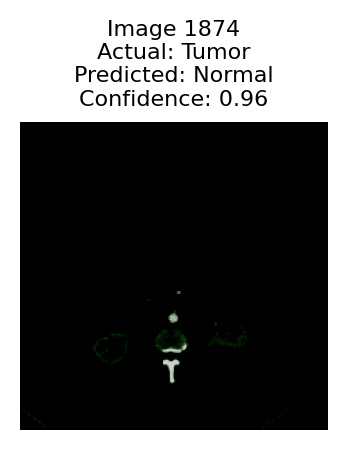

1875
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9770086407661438


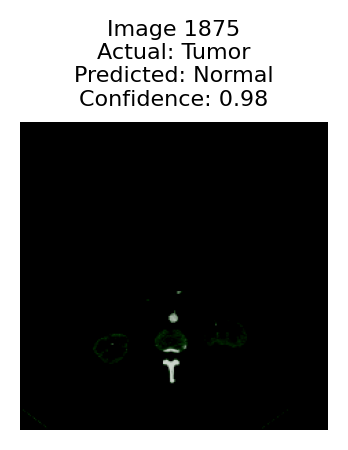

1876
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9718406796455383


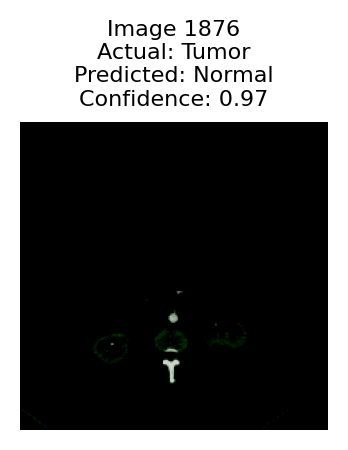

1877
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9599938988685608


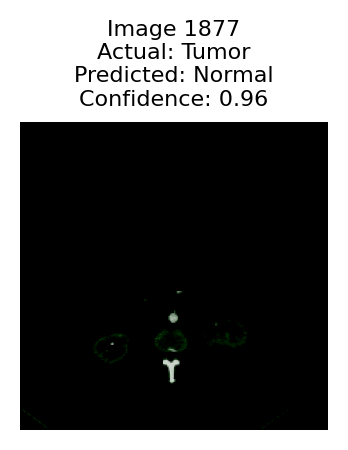

1878
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9603253602981567


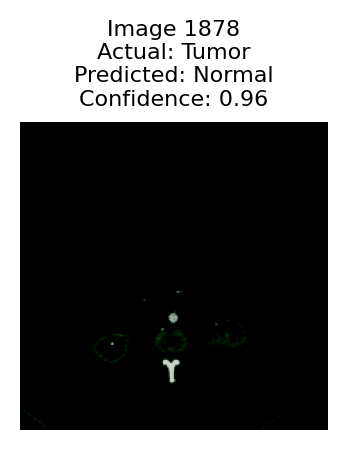

1879
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9646771550178528


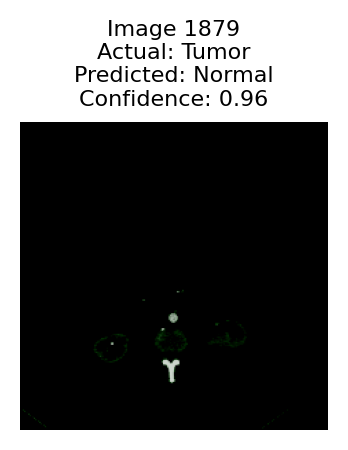

1880
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9664856195449829


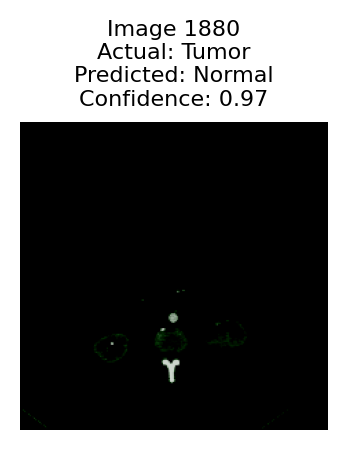

1881
Actual label: Tumor
Predicted label: Normal
Confidence: 0.8354119062423706


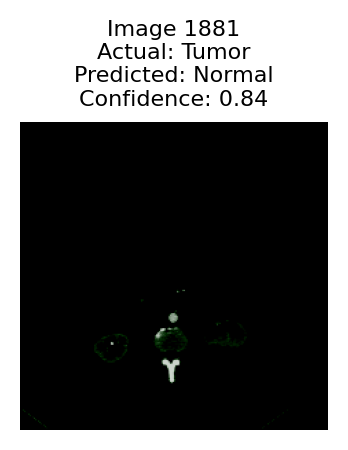

1882
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9418686628341675


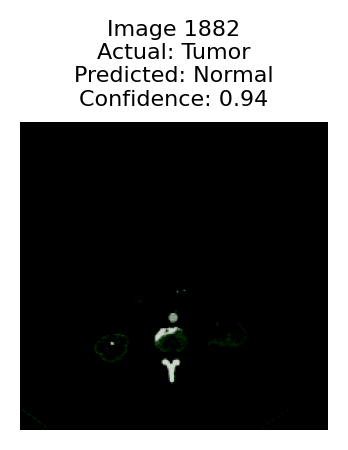

1883
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9432442784309387


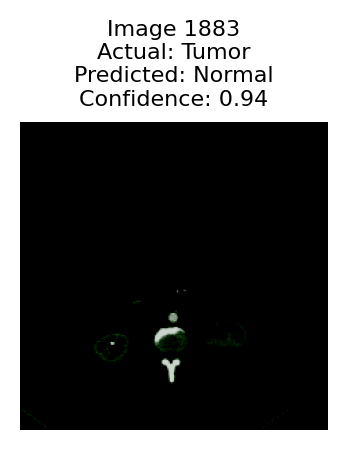

1884
Actual label: Tumor
Predicted label: Normal
Confidence: 0.963625967502594


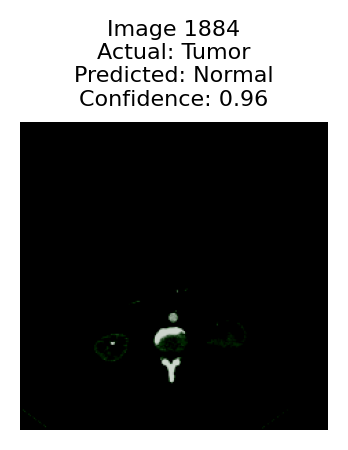

1885
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9685165882110596


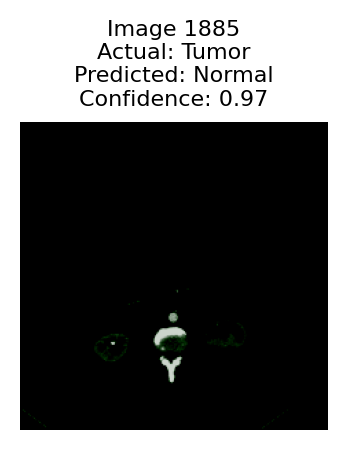

1886
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9709324836730957


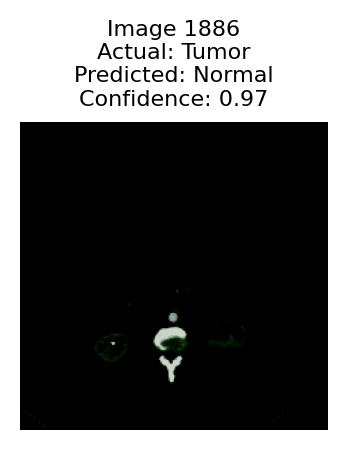

1887
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9842931628227234


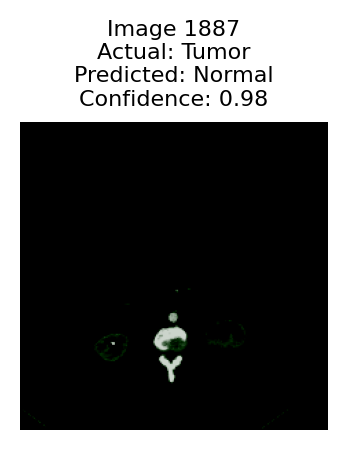

1888
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9630802273750305


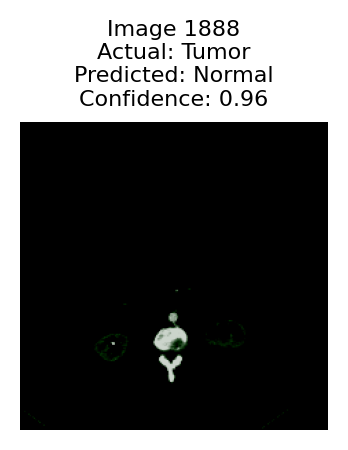

1889
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9432936906814575


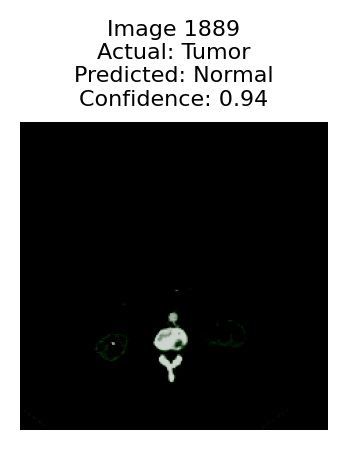

1890
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9640915989875793


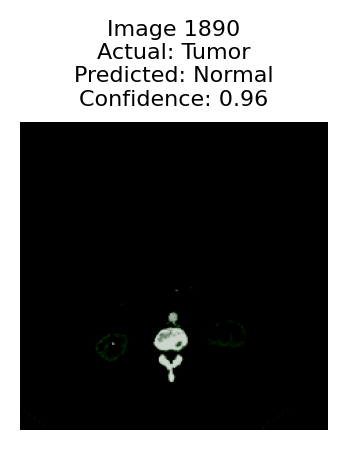

1891
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9135997295379639


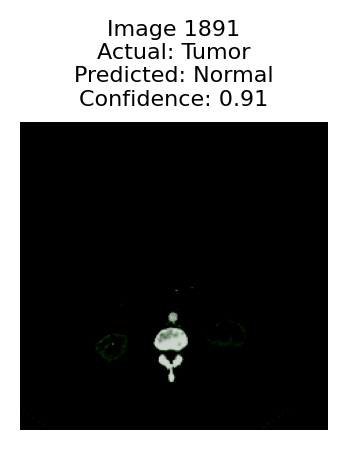

1892
Actual label: Tumor
Predicted label: Cyst
Confidence: 0.5983336567878723


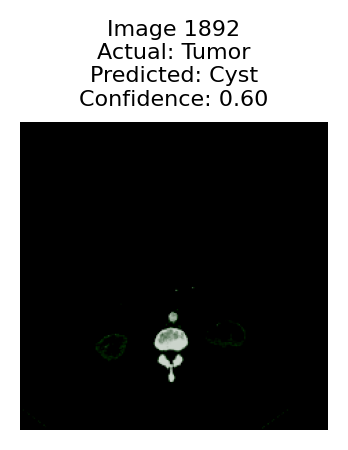

1893
Actual label: Tumor
Predicted label: Cyst
Confidence: 0.5113537311553955


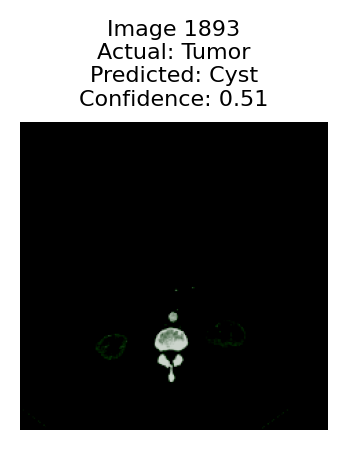

1894
Actual label: Tumor
Predicted label: Normal
Confidence: 0.745883584022522


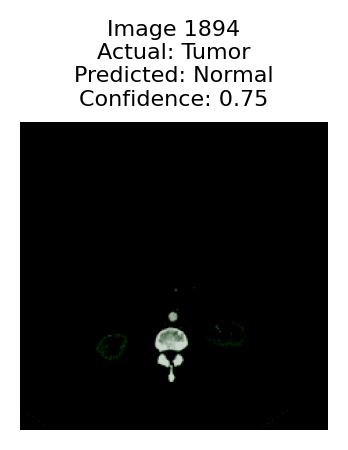

1895
Actual label: Tumor
Predicted label: Normal
Confidence: 0.7932319045066833


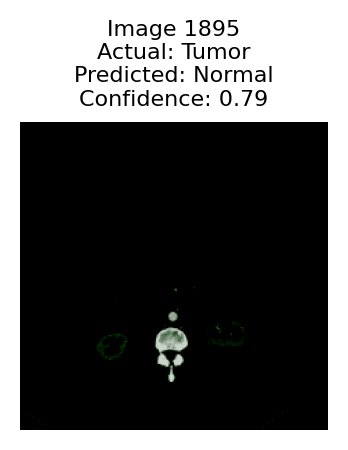

1896
Actual label: Tumor
Predicted label: Cyst
Confidence: 0.6575701832771301


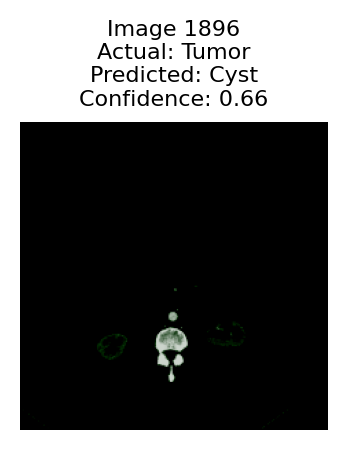

1897
Actual label: Tumor
Predicted label: Cyst
Confidence: 0.8680658936500549


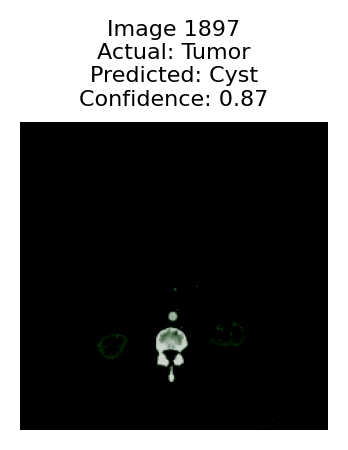

1898
Actual label: Tumor
Predicted label: Cyst
Confidence: 0.7524524927139282


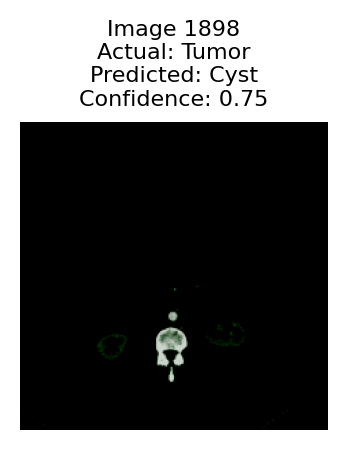

1899
Actual label: Tumor
Predicted label: Normal
Confidence: 0.683347761631012


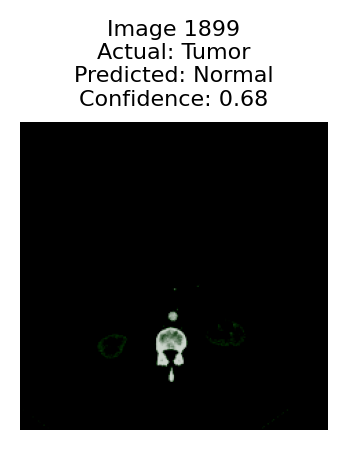

1900
Actual label: Tumor
Predicted label: Normal
Confidence: 0.6787015795707703


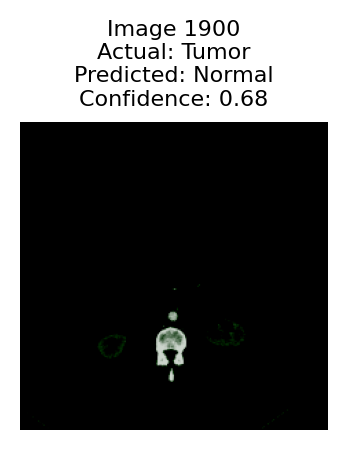

1901
Actual label: Tumor
Predicted label: Normal
Confidence: 0.758572518825531


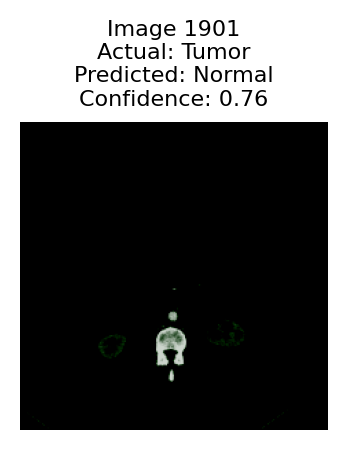

1902
Actual label: Tumor
Predicted label: Normal
Confidence: 0.8079525828361511


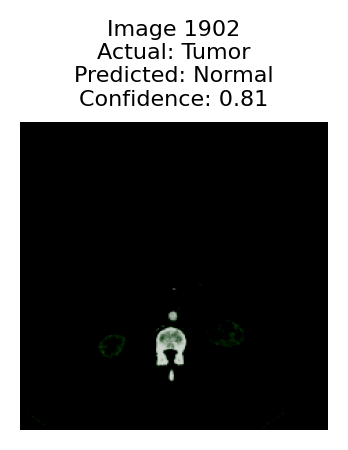

1903
Actual label: Tumor
Predicted label: Normal
Confidence: 0.7770724892616272


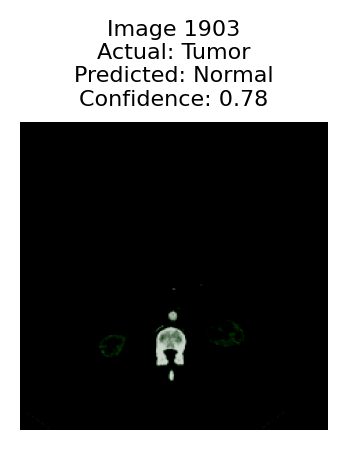

1904
Actual label: Tumor
Predicted label: Normal
Confidence: 0.8731012940406799


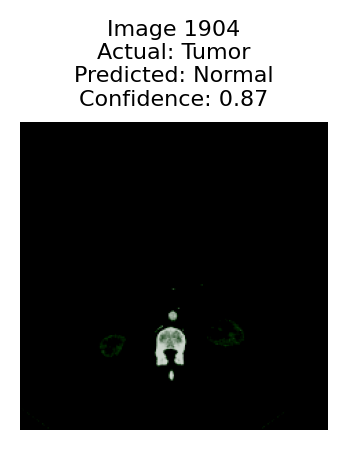

1905
Actual label: Tumor
Predicted label: Normal
Confidence: 0.7232816219329834


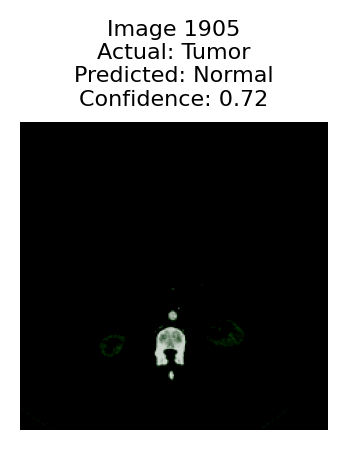

1906
Actual label: Tumor
Predicted label: Normal
Confidence: 0.47270315885543823


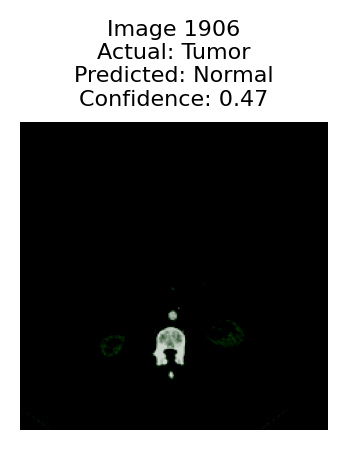

1907
Actual label: Tumor
Predicted label: Normal
Confidence: 0.6909472942352295


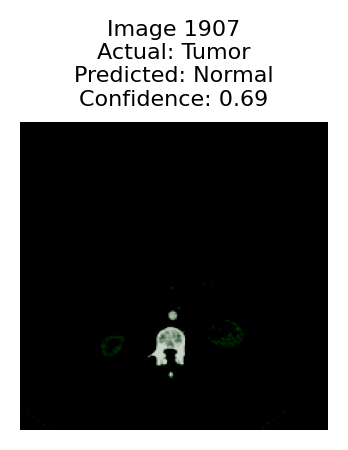

1908
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9998574256896973
True Prediction
1909
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9998999834060669
True Prediction
1910
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.999909520149231
True Prediction
1911
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.999901294708252
True Prediction
1912
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9998668432235718
True Prediction
1913
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9998493194580078
True Prediction
1914
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.999883770942688
True Prediction
1915
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9998875856399536
True Prediction
1916
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9998929500579834
True Prediction
1917
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9998962879180908
True Prediction
1918
Actual label: Tumor
Predicted label: Tumor
Confi

2145
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9998821020126343
True Prediction
2146
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9998610019683838
True Prediction
2147
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9998613595962524
True Prediction
2148
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9998273849487305
True Prediction
2149
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9996776580810547
True Prediction
2150
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.998897910118103
True Prediction
2151
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9946271777153015
True Prediction
2152
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.993878960609436
True Prediction
2153
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9907302260398865
True Prediction
2154
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9676666259765625
True Prediction
2155
Actual label: Tumor
Predicted label: Tumor
Conf

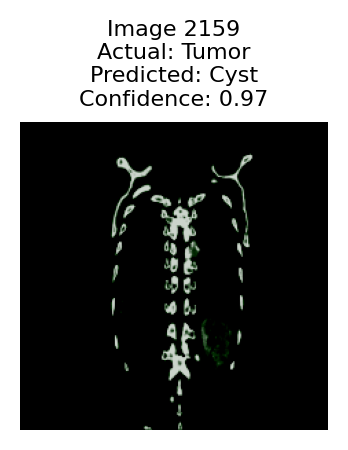

2160
Actual label: Tumor
Predicted label: Cyst
Confidence: 0.94551020860672


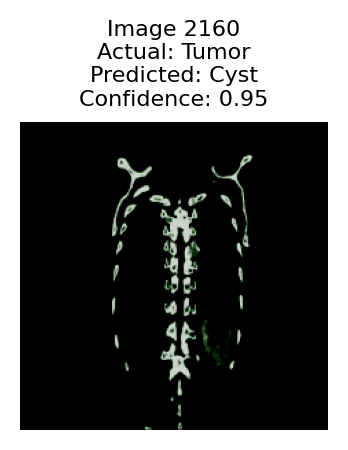

2161
Actual label: Tumor
Predicted label: Cyst
Confidence: 0.952166736125946


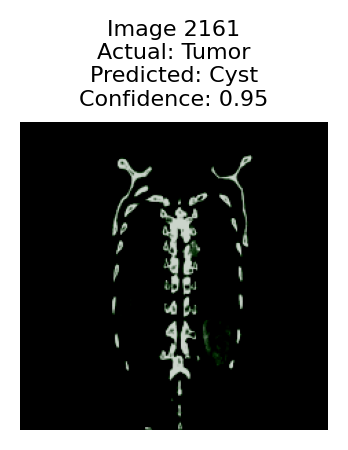

2162
Actual label: Tumor
Predicted label: Cyst
Confidence: 0.9793931245803833


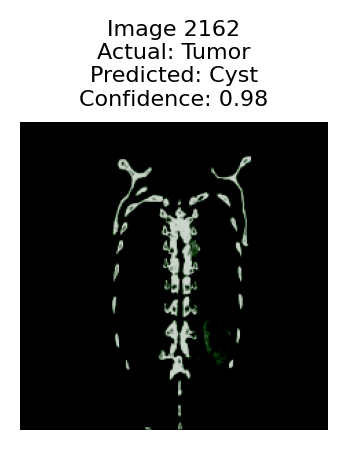

2163
Actual label: Tumor
Predicted label: Cyst
Confidence: 0.9952867031097412


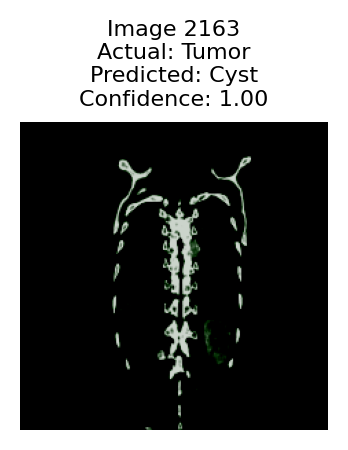

2164
Actual label: Tumor
Predicted label: Cyst
Confidence: 0.9971422553062439


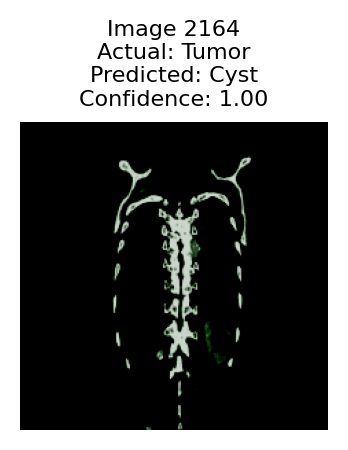

2165
Actual label: Tumor
Predicted label: Cyst
Confidence: 0.9988080263137817


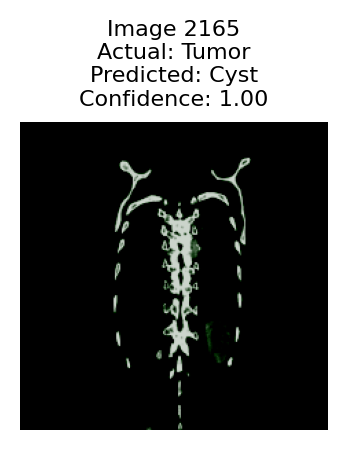

2166
Actual label: Tumor
Predicted label: Cyst
Confidence: 0.9991284012794495


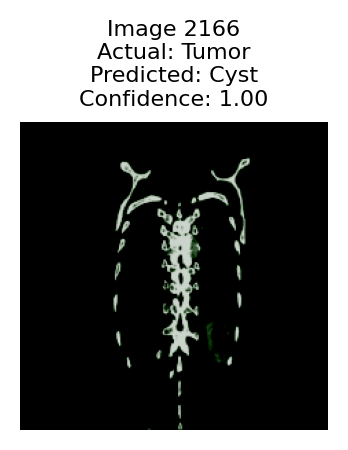

2167
Actual label: Tumor
Predicted label: Cyst
Confidence: 0.9971104860305786


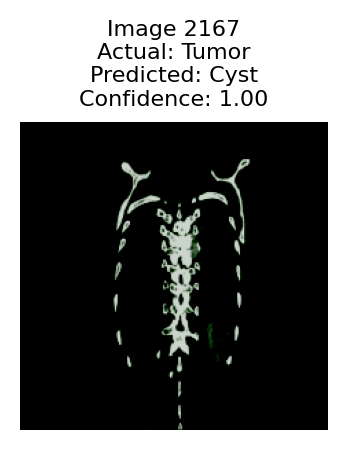

2168
Actual label: Tumor
Predicted label: Cyst
Confidence: 0.9973536729812622


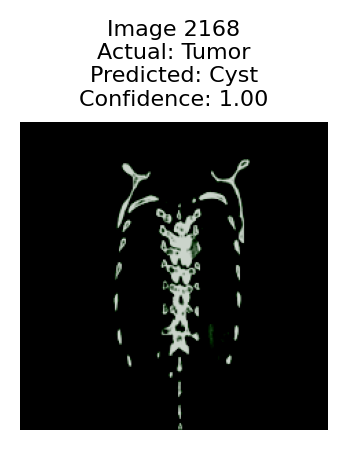

2169
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9999512434005737
True Prediction
2170
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9999614953994751
True Prediction
2171
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9999531507492065
True Prediction
2172
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9999440908432007
True Prediction
2173
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9999289512634277
True Prediction
2174
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9999121427536011
True Prediction
2175
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9998636245727539
True Prediction
2176
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9998403787612915
True Prediction
2177
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9998666048049927
True Prediction
2178
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9999021291732788
True Prediction
2179
Actual label: Tumor
Predicted label: Tumor
Co

2273
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9999631643295288
True Prediction
2274
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9999679327011108
True Prediction
2275
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9999680519104004
True Prediction
2276
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.999957799911499
True Prediction
2277
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9999302625656128
True Prediction
2278
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9998973608016968
True Prediction
2279
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9998904466629028
True Prediction
2280
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9998096823692322
True Prediction
2281
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.999804675579071
True Prediction
2282
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9997647404670715
True Prediction
2283
Actual label: Tumor
Predicted label: Tumor
Conf

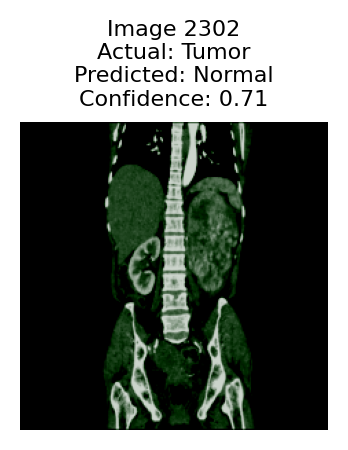

2303
Actual label: Tumor
Predicted label: Normal
Confidence: 0.67938232421875


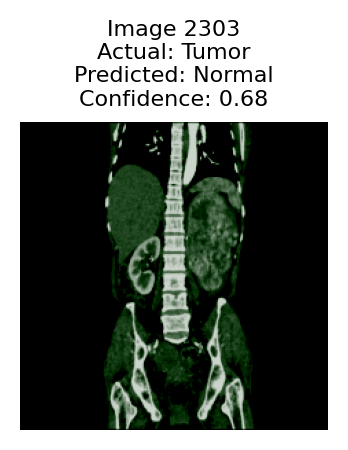

2304
Actual label: Tumor
Predicted label: Normal
Confidence: 0.5158090591430664


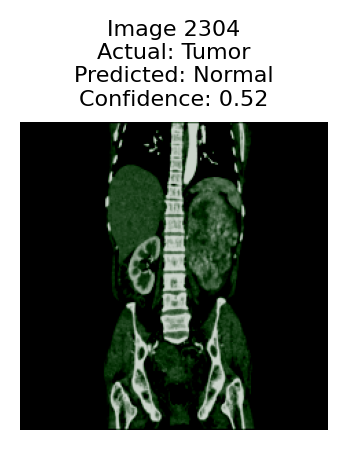

2305
Actual label: Tumor
Predicted label: Normal
Confidence: 0.5778529047966003


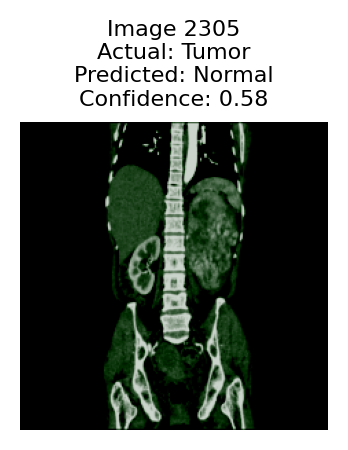

2306
Actual label: Tumor
Predicted label: Normal
Confidence: 0.6600315570831299


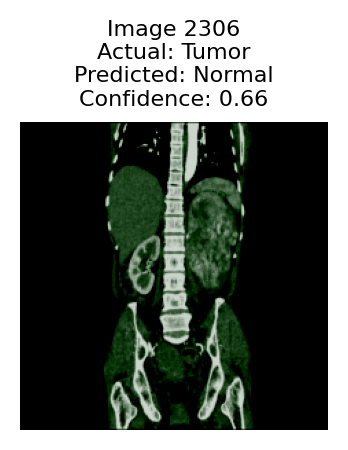

2307
Actual label: Tumor
Predicted label: Normal
Confidence: 0.8247880339622498


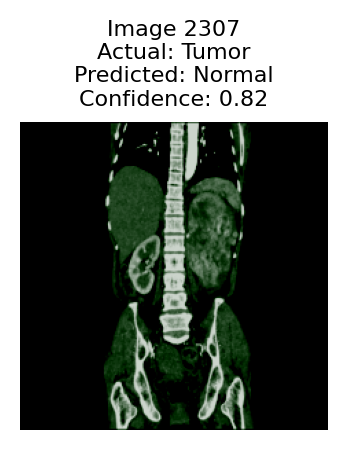

2308
Actual label: Tumor
Predicted label: Normal
Confidence: 0.8461298942565918


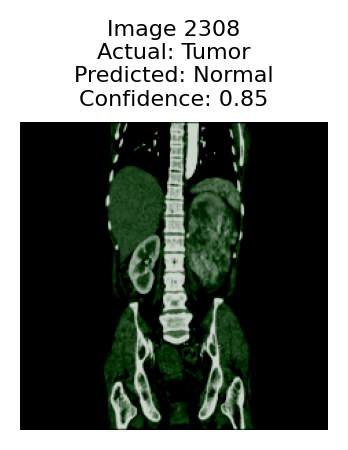

2309
Actual label: Tumor
Predicted label: Normal
Confidence: 0.589078426361084


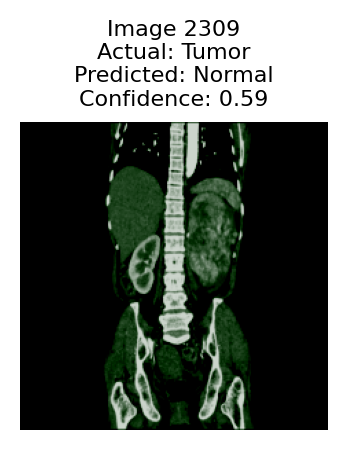

2310
Actual label: Tumor
Predicted label: Normal
Confidence: 0.7597641944885254


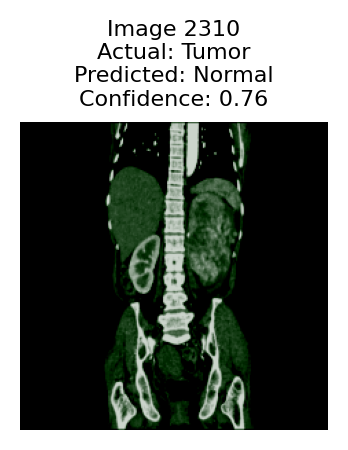

2311
Actual label: Tumor
Predicted label: Normal
Confidence: 0.7292402386665344


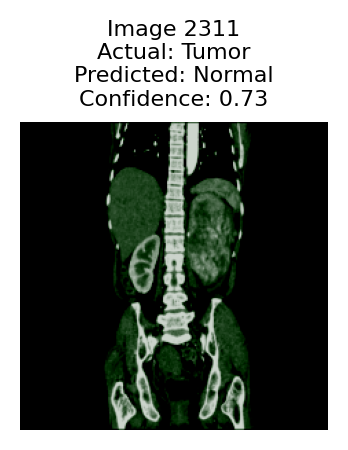

2312
Actual label: Tumor
Predicted label: Normal
Confidence: 0.7345010042190552


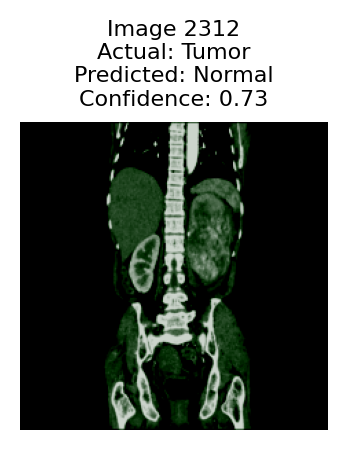

2313
Actual label: Tumor
Predicted label: Normal
Confidence: 0.7297006845474243


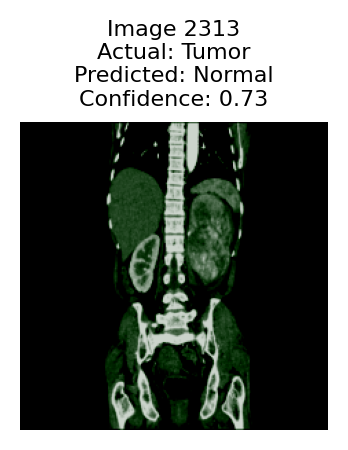

2314
Actual label: Tumor
Predicted label: Normal
Confidence: 0.835353672504425


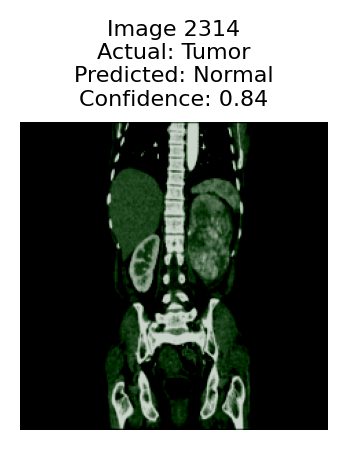

2315
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9572432637214661


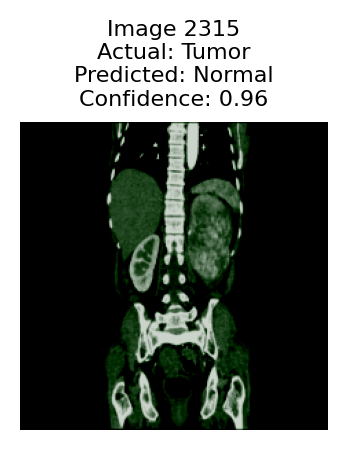

2316
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9844573140144348


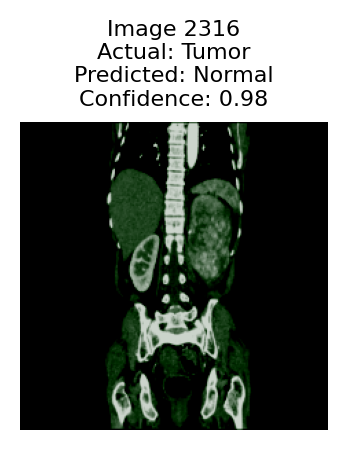

2317
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9845277667045593


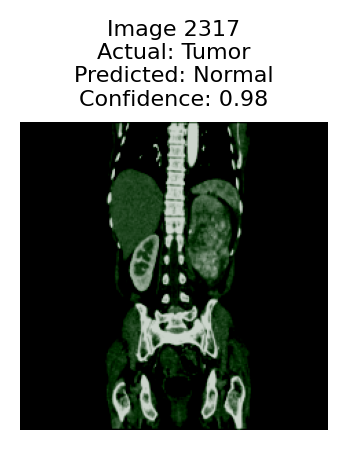

2318
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9958017468452454


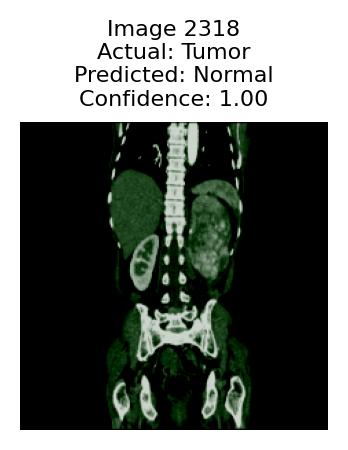

2319
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9964848756790161


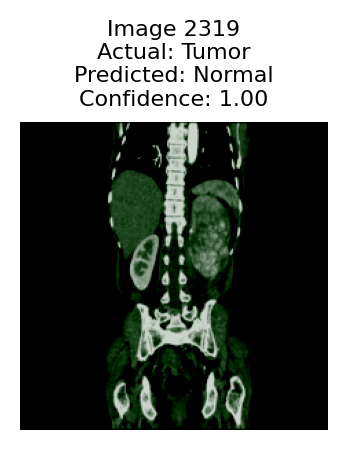

2320
Actual label: Tumor
Predicted label: Normal
Confidence: 0.992318868637085


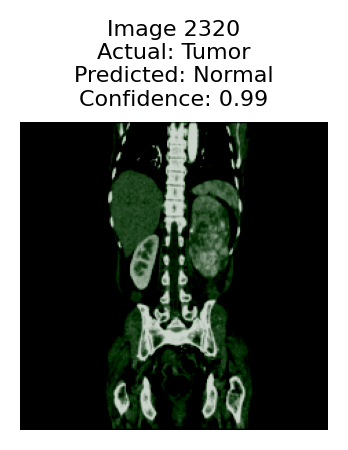

2321
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9956690073013306


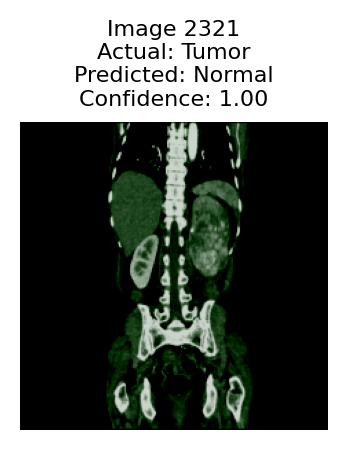

2322
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9972979426383972


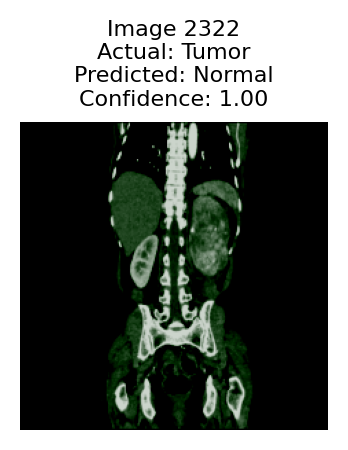

2323
Actual label: Tumor
Predicted label: Normal
Confidence: 0.998792290687561


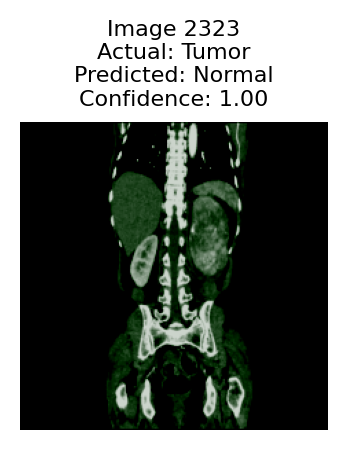

2324
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9989131689071655


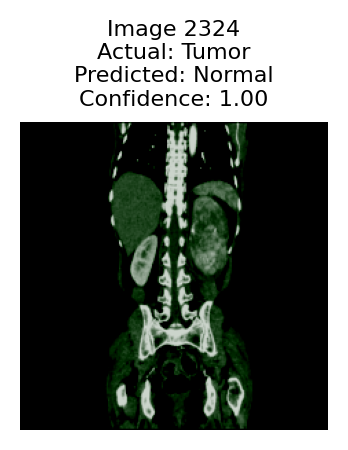

2325
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9980292916297913


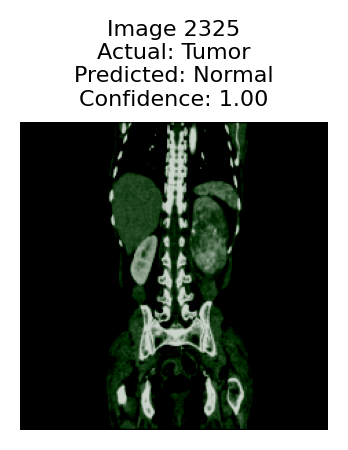

2326
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9983986020088196


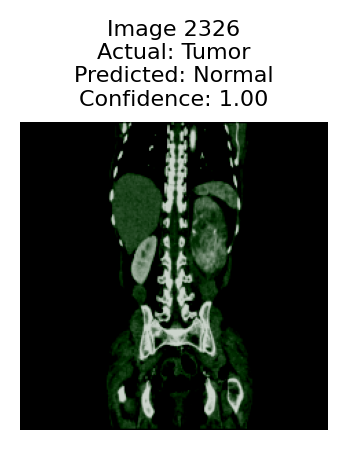

2327
Actual label: Tumor
Predicted label: Normal
Confidence: 0.999373733997345


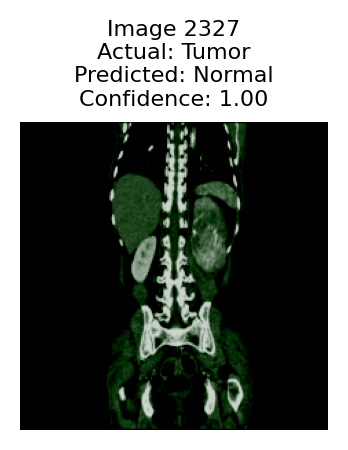

2328
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9990392923355103


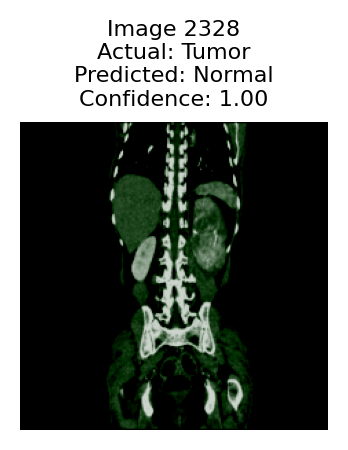

2329
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9972327351570129


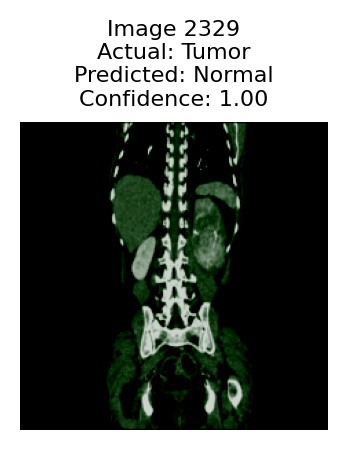

2330
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9937973022460938


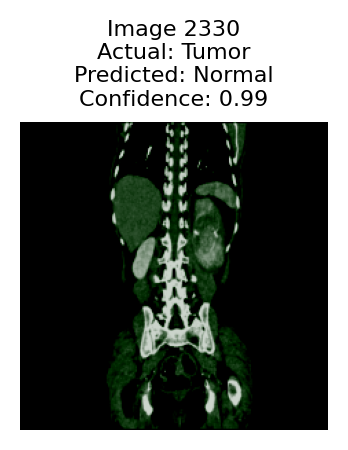

2331
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9926202297210693


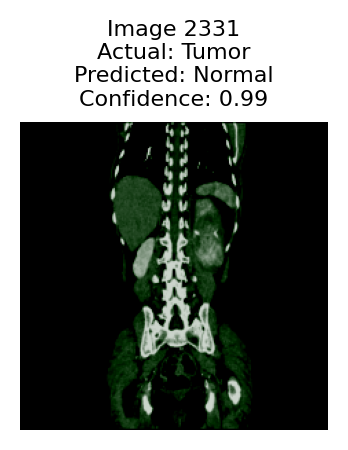

2332
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9973751306533813


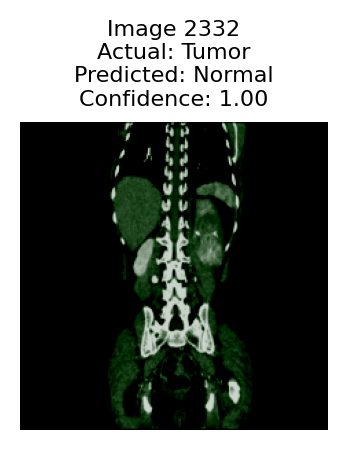

2333
Actual label: Tumor
Predicted label: Normal
Confidence: 0.998629093170166


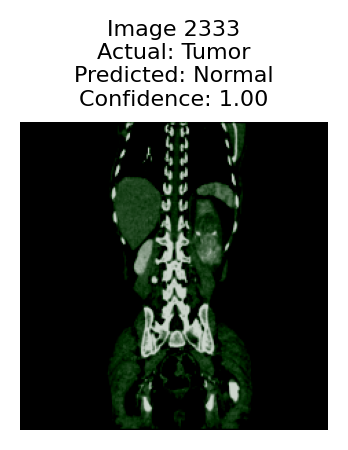

2334
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9982609152793884


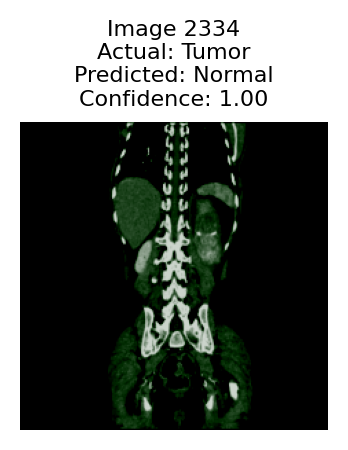

2335
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9980504512786865


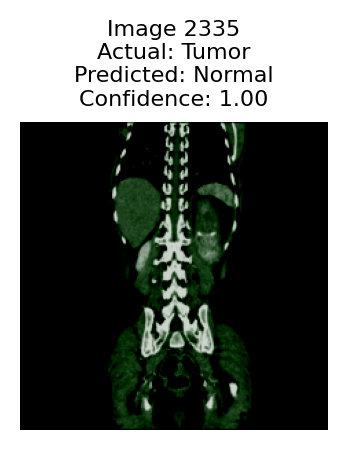

2336
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9845786094665527


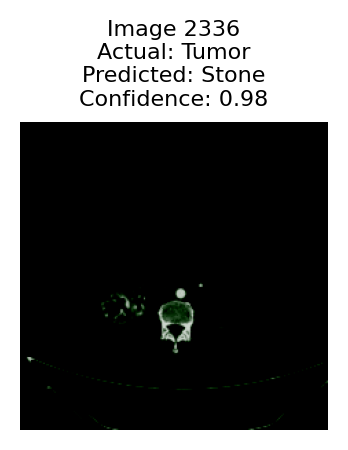

2337
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9852659106254578


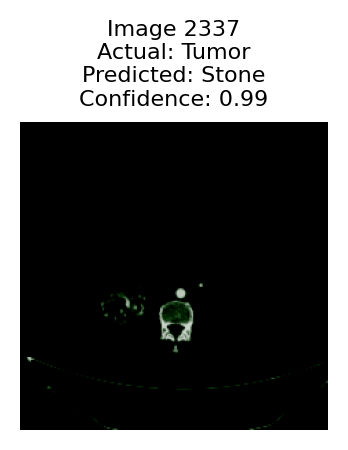

2338
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9906997084617615


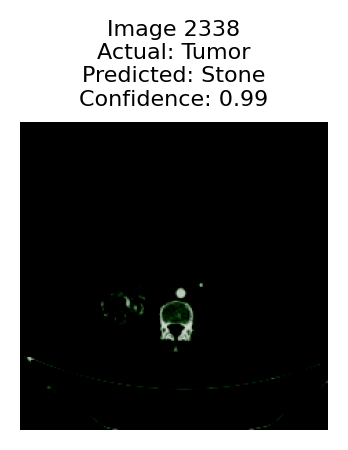

2339
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9540969133377075


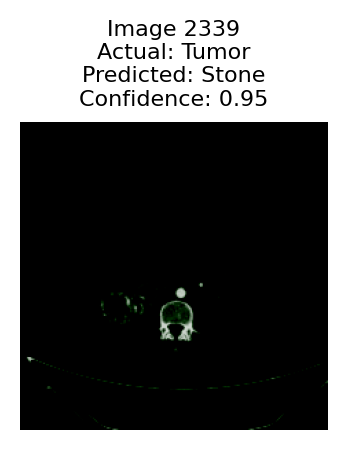

2340
Actual label: Tumor
Predicted label: Stone
Confidence: 0.518783450126648


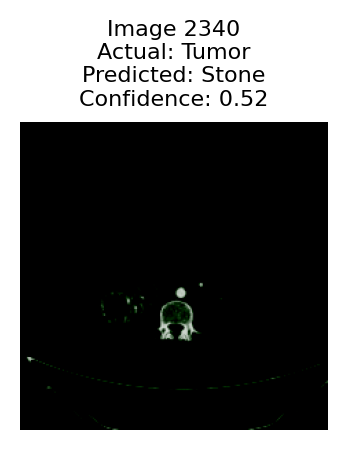

2341
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.8329237103462219
True Prediction
2342
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.873872697353363
True Prediction
2343
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9611078500747681
True Prediction
2344
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.7603890299797058
True Prediction
2345
Actual label: Tumor
Predicted label: Stone
Confidence: 0.5794249773025513


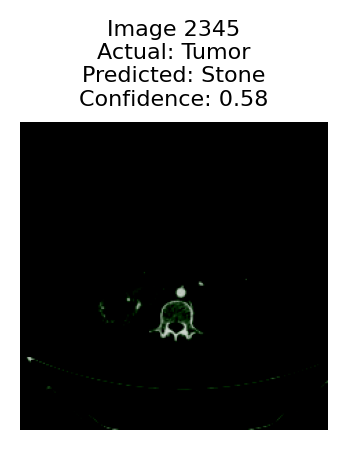

2346
Actual label: Tumor
Predicted label: Stone
Confidence: 0.7804093360900879


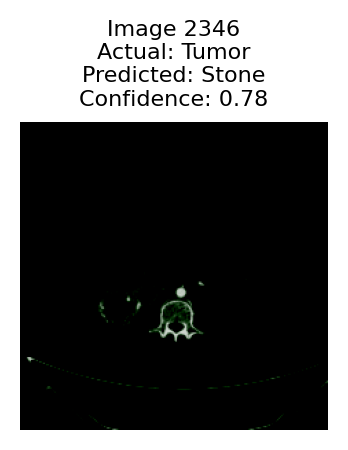

2347
Actual label: Tumor
Predicted label: Stone
Confidence: 0.7816882729530334


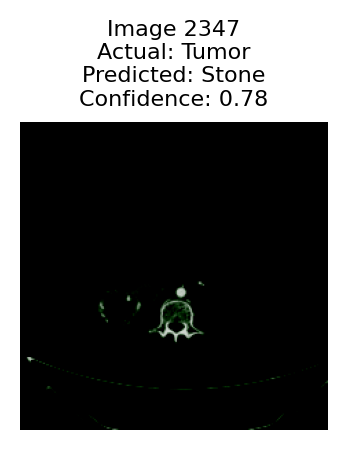

2348
Actual label: Tumor
Predicted label: Stone
Confidence: 0.6579799056053162


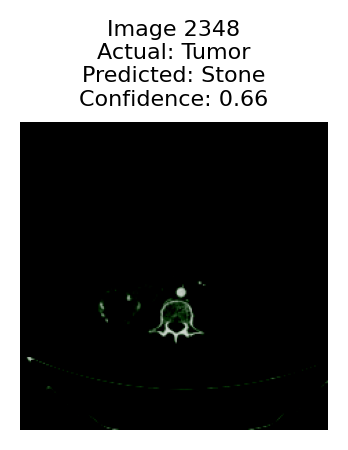

2349
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9390885233879089


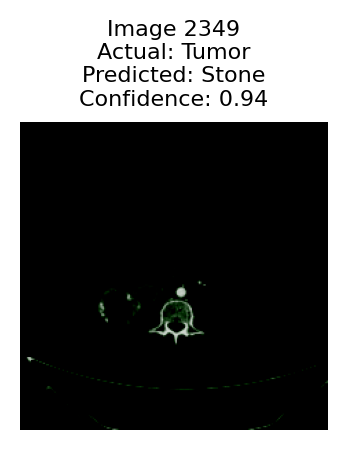

2350
Actual label: Tumor
Predicted label: Stone
Confidence: 0.8581475615501404


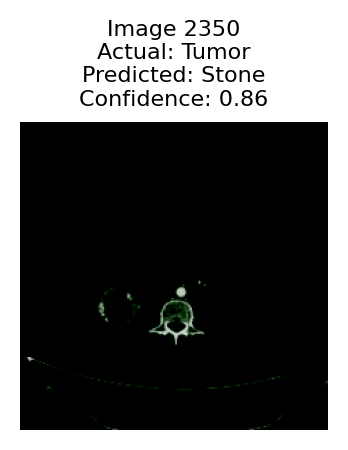

2351
Actual label: Tumor
Predicted label: Stone
Confidence: 0.5651603937149048


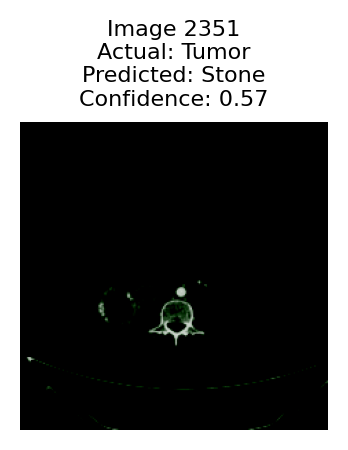

2352
Actual label: Tumor
Predicted label: Stone
Confidence: 0.6753070950508118


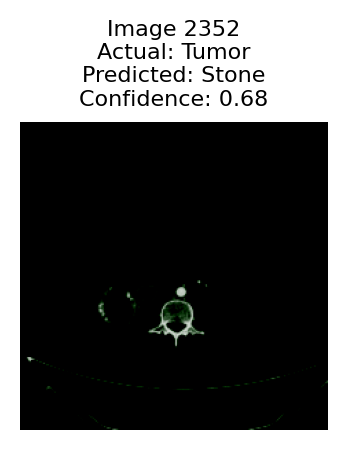

2353
Actual label: Tumor
Predicted label: Stone
Confidence: 0.5765167474746704


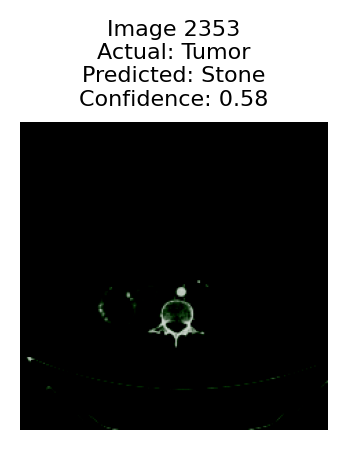

2354
Actual label: Tumor
Predicted label: Stone
Confidence: 0.694250226020813


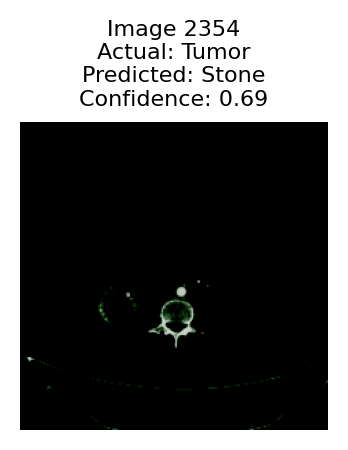

2355
Actual label: Tumor
Predicted label: Stone
Confidence: 0.5670921802520752


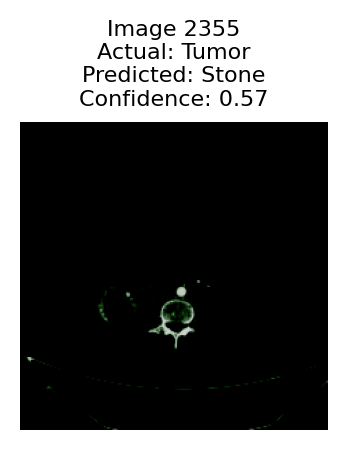

2356
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.764639675617218
True Prediction
2357
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9213408827781677


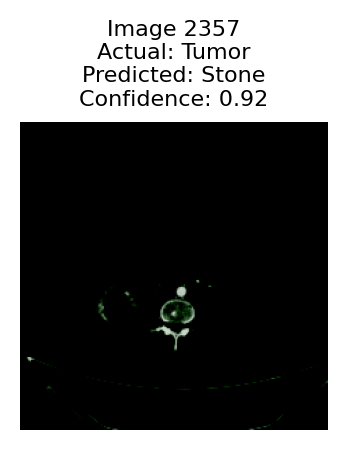

2358
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9854674935340881


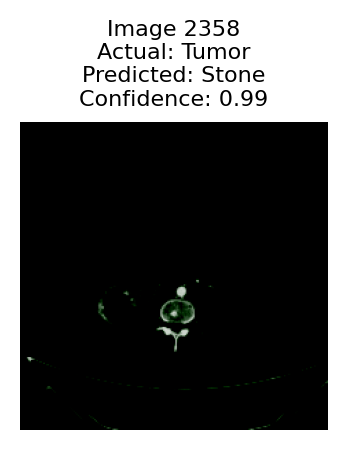

2359
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9965652823448181


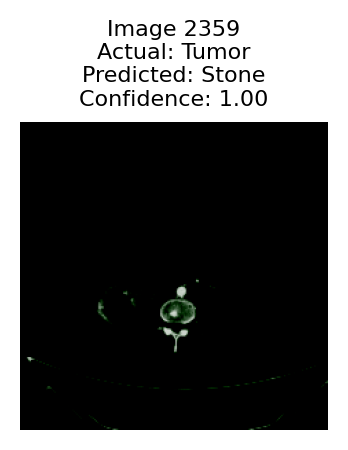

2360
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9770723581314087


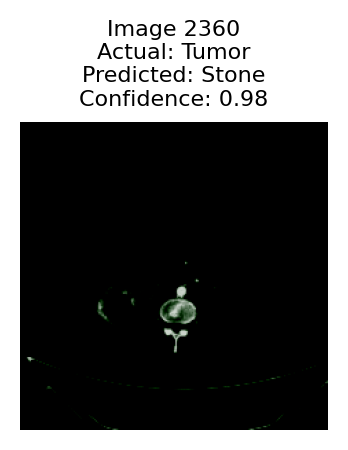

2361
Actual label: Tumor
Predicted label: Stone
Confidence: 0.8314003348350525


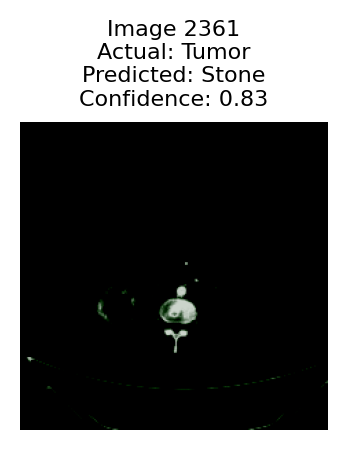

2362
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9396167397499084


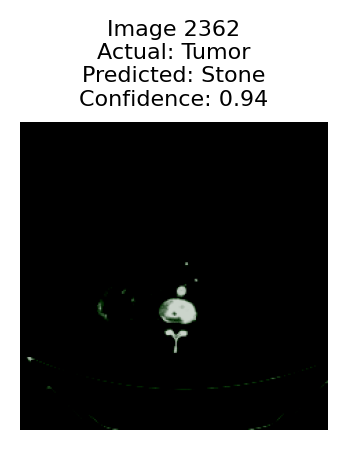

2363
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9941330552101135


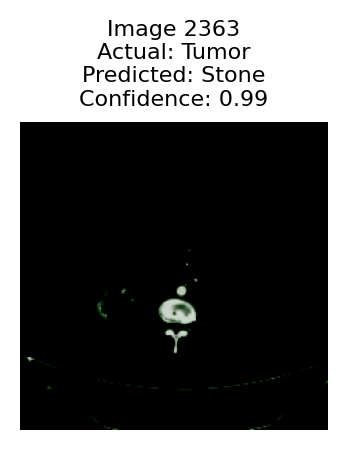

2364
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9994484782218933


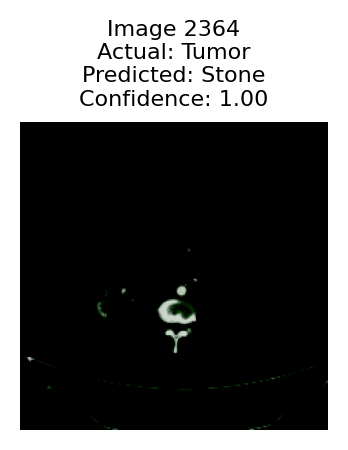

2365
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9982751607894897


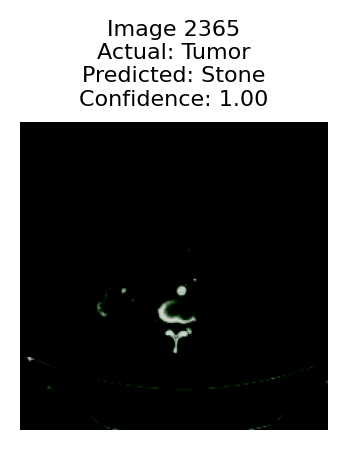

2366
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9982771873474121


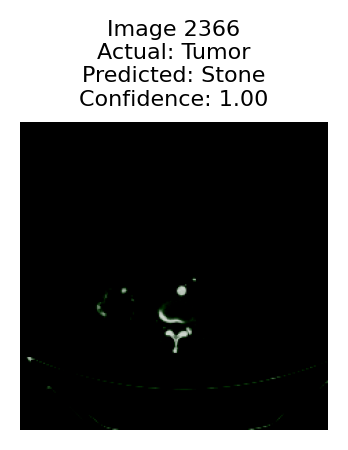

2367
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9968029260635376


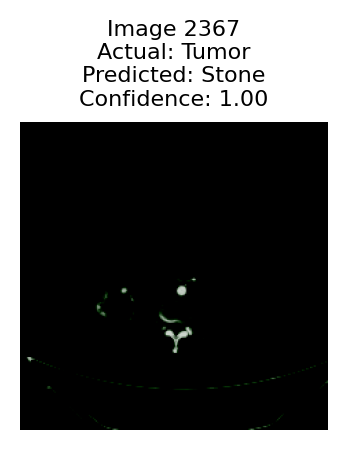

2368
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9959312081336975


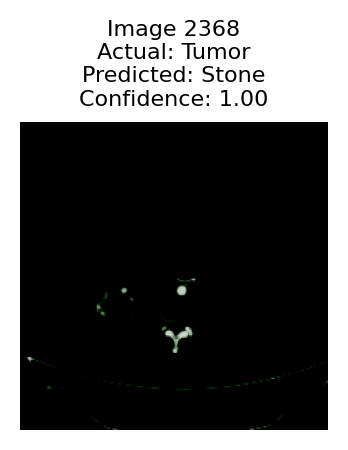

2369
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9991753697395325


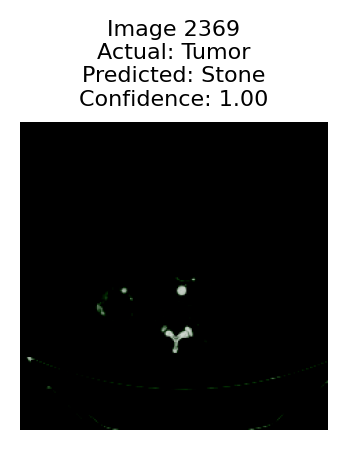

2370
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9995274543762207

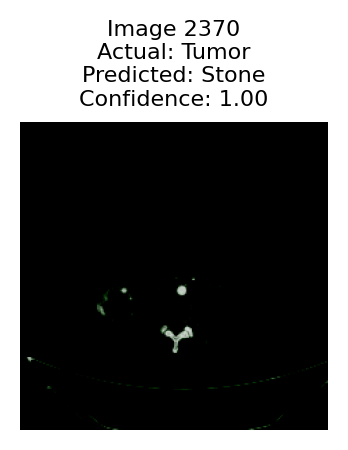

2371
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9993775486946106


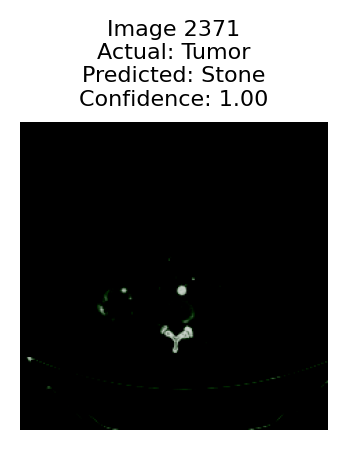

2372
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9991959929466248


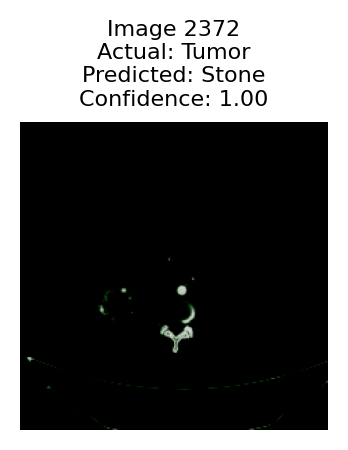

2373
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9991323351860046


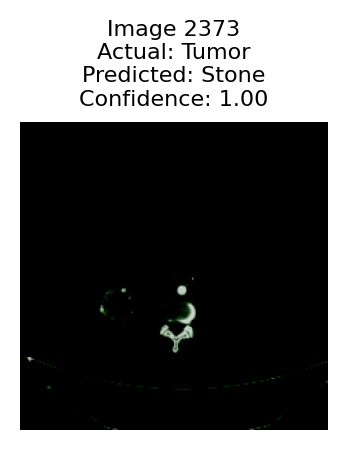

2374
Actual label: Tumor
Predicted label:

 Stone
Confidence: 0.9973753690719604


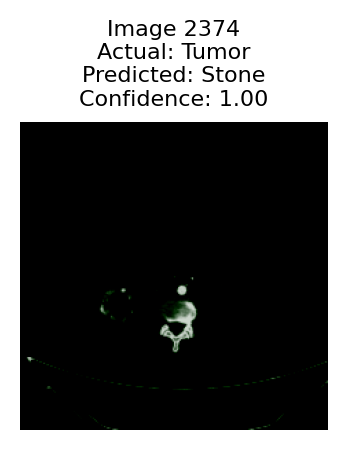

2375
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9973711967468262


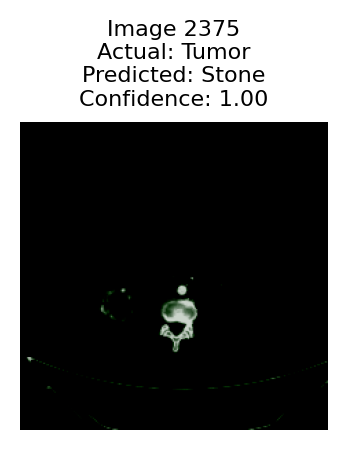

2376
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9981728792190552


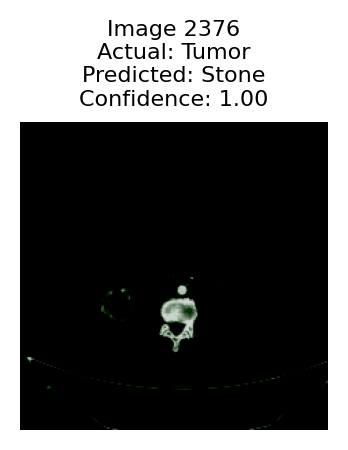

2377
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9978644251823425


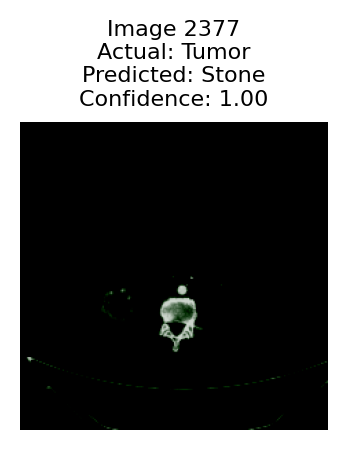

2378
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9977297186851501


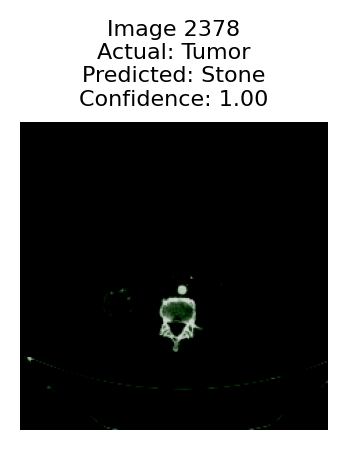

2379
Actual label: Tumor
Predicted label:

 Stone
Confidence: 0.9967148303985596


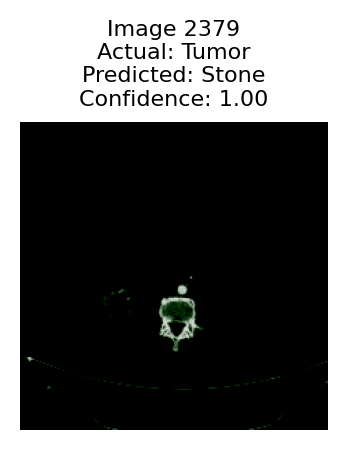

2380
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9958029389381409


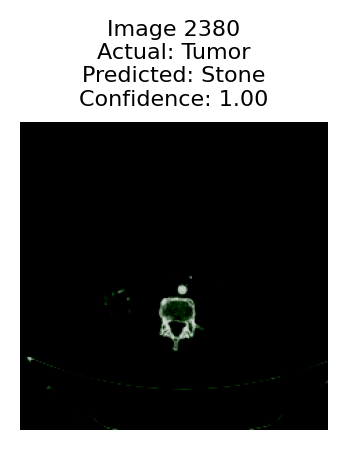

2381
Actual label: Tumor
Predicted label: Stone
Confidence:

 0.9914695620536804


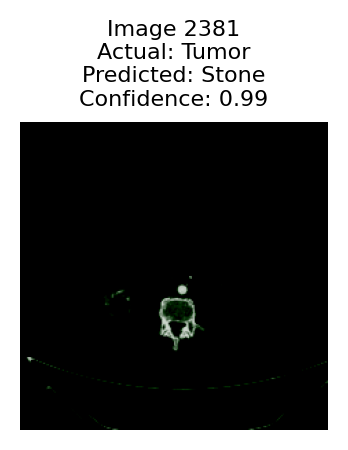

2382
Actual label: Tumor
Predicted label: Stone
Confidence: 0.7985320687294006


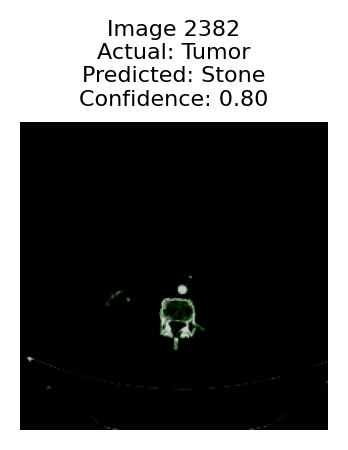

2383
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.6470430493354797
True Prediction
2384
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.999036431312561
True Prediction
2385
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9991996884346008
True Prediction
2386
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.998916506767273
True Prediction
2387
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9992144107818604
True Prediction
2388
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9983556866645813
True Prediction
2389
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9872245788574219
True Prediction
2390
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9593570828437805
True Prediction
2391
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9915492534637451
True Prediction
2392
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9921385645866394
True Prediction
2393
Actual label: Tumor
Predicted label: Tumor
Conf

2401
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.997249186038971
True Prediction
2402
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9939485788345337
True Prediction
2403
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9842292070388794
True Prediction
2404
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9707821607589722
True Prediction
2405
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.873054027557373
True Prediction
2406
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9140229225158691
True Prediction
2407
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9490775465965271
True Prediction
2408
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9756082892417908
True Prediction
2409
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9933590292930603
True Prediction
2410
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.9980881810188293
True Prediction
2411
Actual label: Tumor
Predicted label: Tumor
Conf

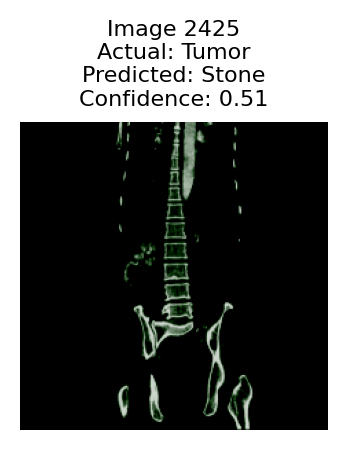

2426
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.6423047780990601
True Prediction
2427
Actual label: Tumor
Predicted label: Stone
Confidence: 0.5947737097740173


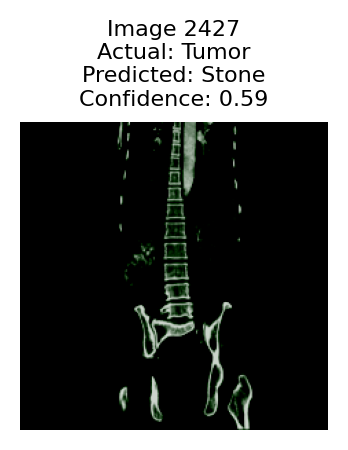

2428
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9328864216804504


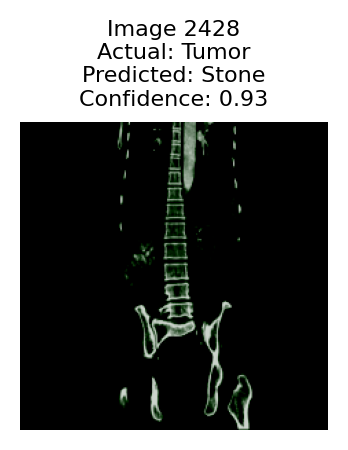

2429
Actual label: Tumor
Predicted label: Stone
Confidence: 0.9607849717140198


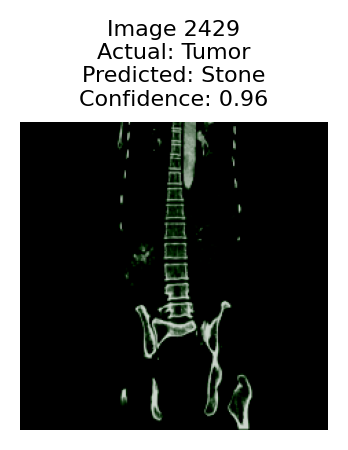

2430
Actual label: Tumor
Predicted label: Stone
Confidence: 0.849866509437561


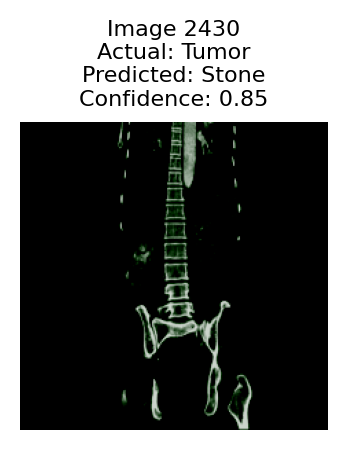

2431
Actual label: Tumor
Predicted label: Stone
Confidence: 0.4120922386646271


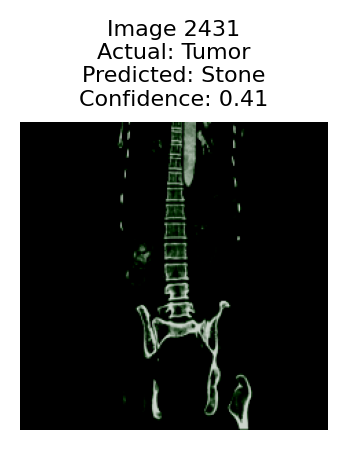

2432
Actual label: Tumor
Predicted label: Normal
Confidence: 0.5493255257606506


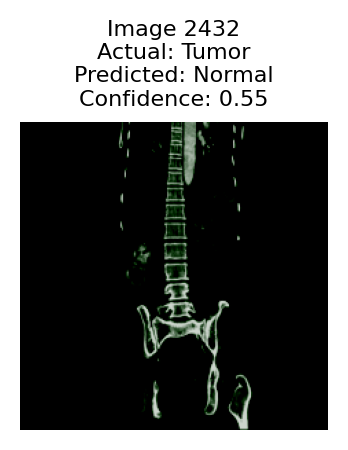

2433
Actual label: Tumor
Predicted label: Normal
Confidence: 0.5821448564529419


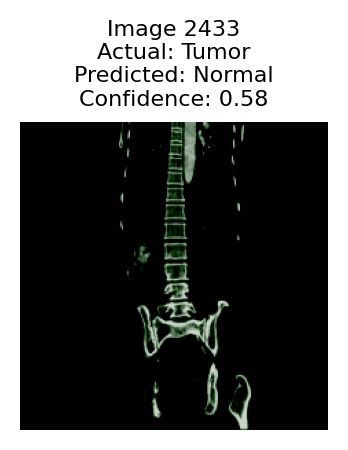

2434
Actual label: Tumor
Predicted label: Normal
Confidence: 0.5762497186660767


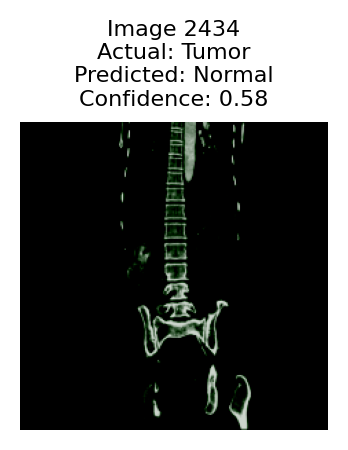

2435
Actual label: Tumor
Predicted label: Normal
Confidence: 0.7520058155059814


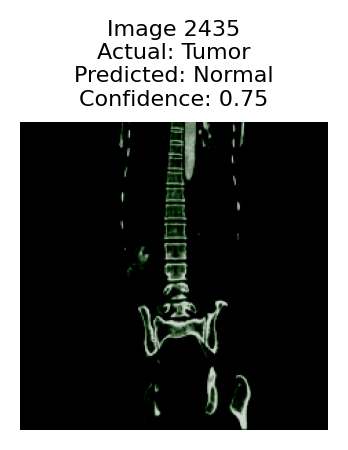

2436
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9790349006652832


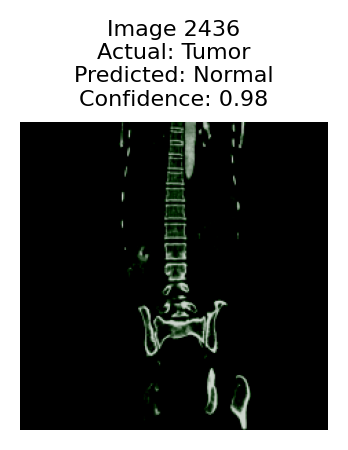

2437
Actual label: Tumor
Predicted label: Normal
Confidence: 0.9854970574378967


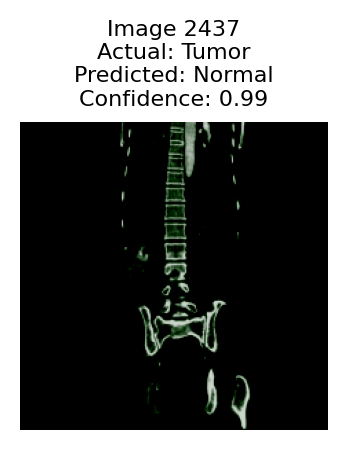

2438
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.547243058681488
True Prediction
2439
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.5731772780418396
True Prediction
2440
Actual label: Tumor
Predicted label: Normal
Confidence: 0.689487636089325


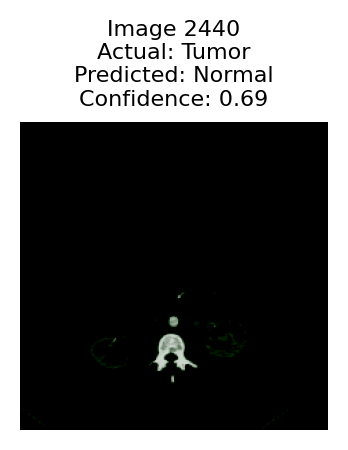

2441
Actual label: Tumor
Predicted label: Normal
Confidence: 0.7900240421295166


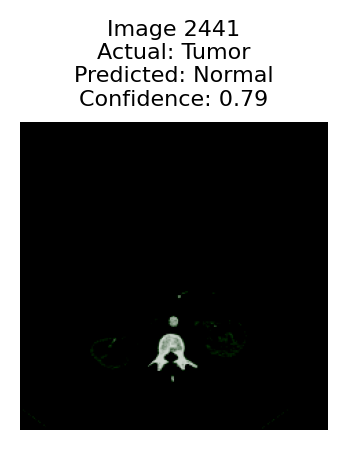

2442


Actual label: Tumor
Predicted label: Normal
Confidence: 0.6505251526832581


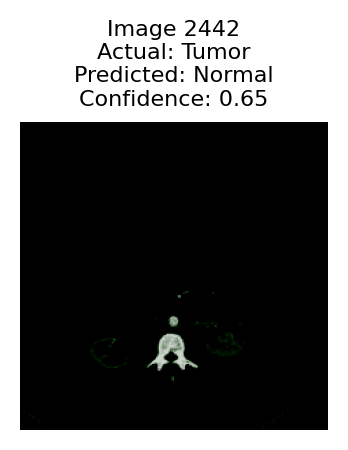

2443
Actual label: Tumor
Predicted label: Normal
Confidence: 0.41803449392318726


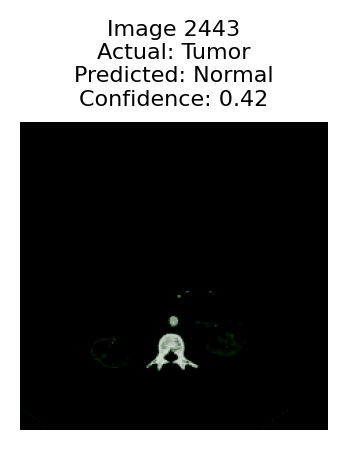

2444
Actual label: 

Tumor
Predicted label: Stone
Confidence: 0.382945716381073


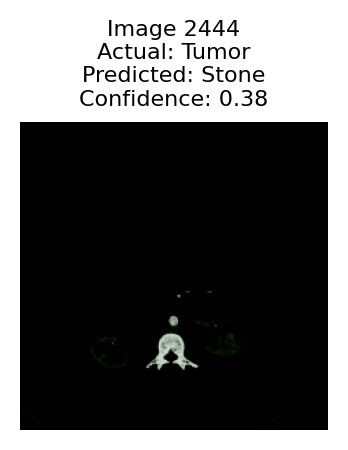

2445
Actual label: Tumor
Predicted label: Cyst
Confidence: 0.3799396753311157


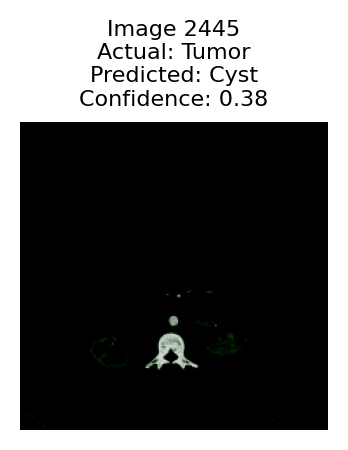

2446
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.46311625838279724
True Prediction
2447
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.5218777656555176
True Prediction
2448
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.33463943004608154
True Prediction
2449
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.45048436522483826
True Prediction
2450
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.6070585250854492
True Prediction
2451
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.6788628697395325
True Prediction
2452
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.6716968417167664
True Prediction
2453
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.8580546379089355
True Prediction
2454
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.7301928400993347
True Prediction
2455
Actual label: Tumor
Predicted label: Tumor
Confidence: 0.7663896083831787
True Prediction
2456
Actual label: Tumor
Predicted label: Tumor

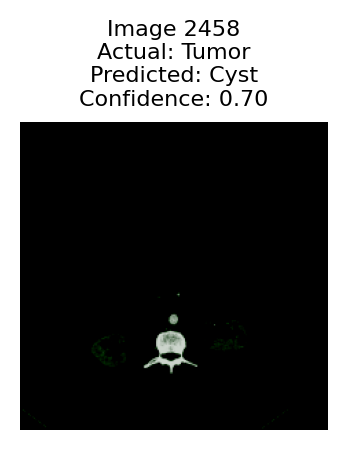

2459
Actual label: Tumor
Predicted label: Cyst
Confidence:

 0.9011645913124084


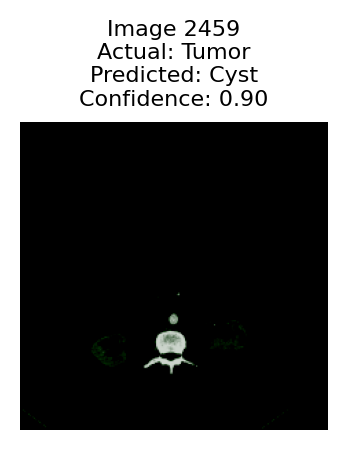

2460
Actual label: Tumor
Predicted label: Cyst
Confidence: 0.9287461638450623


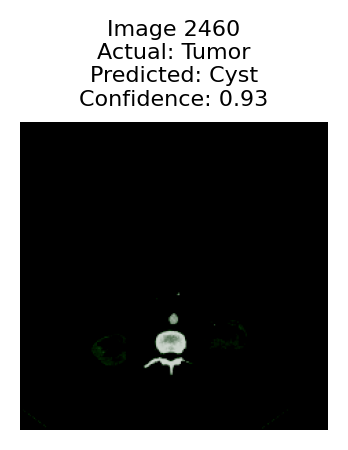

2461
Actual label: Tumor
Predicted label: Cyst
Confidence: 0.7804439663887024


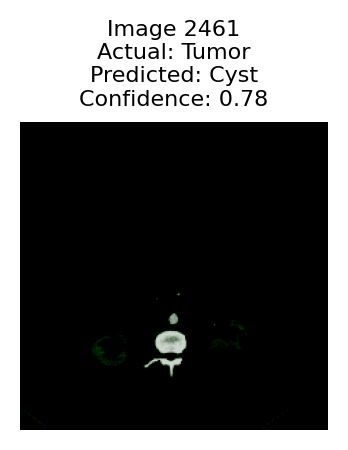

2462
Actual label: Tumor
Predicted label: Normal
Confidence: 0.4155158996582031


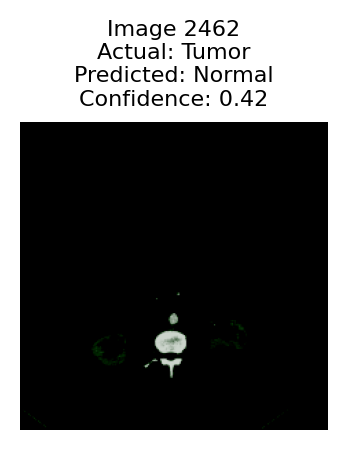

2463
Actual label: Tumor
Predicted label: Normal
Confidence: 0.6740716099739075


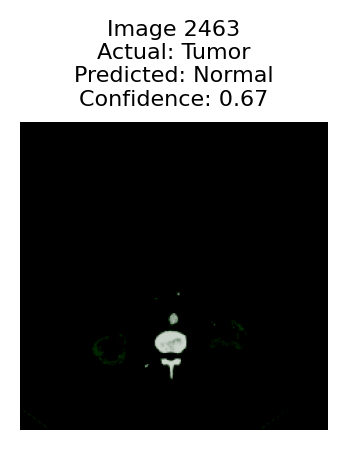

In [ ]:
import torch.nn.functional as F
import matplotlib.pyplot as plt

class_names = test_dataset.classes
actual = []
predicted = []
imageName = []
conf = []


# Function to display an image along with its labels
def show_image(img, actual_label, predicted_label, confidence, idx):
    img = img.permute(1, 2, 0).cpu().numpy()  # Convert tensor to numpy array and permute dimensions

    # Create a figure with high resolution but small size
    plt.figure(figsize=(2, 2), dpi=200)  # Small figure size with high dpi for clarity
    plt.imshow(img)
    plt.xlabel('X-axis (Pixels)')
    plt.ylabel('Y-axis (Pixels)')
    plt.title(f"Image {idx}\nActual: {actual_label}\nPredicted: {predicted_label}\nConfidence: {confidence:.2f}", fontsize=8)
    plt.axis('off')
    plt.show()

j = 1
for images, labels in test_dataloader:
    images = images.to(device)
    with torch.no_grad():
        outputs = model(images)

    predicted_labels = torch.argmax(outputs.logits, dim=1)

    # Map predicted labels to class names
    predicted_class_names = [class_names[label] for label in predicted_labels]
    predicted_probs = F.softmax(outputs.logits, dim=1)
    confidences = torch.max(predicted_probs, dim=1).values

    # Convert actual labels to class names
    actual_class_names = [class_names[label] for label in labels.tolist()]

    for i in range(len(images)):
        print(j)
        print("Actual label:", actual_class_names[i])
        actual.append(actual_class_names[i])
        print("Predicted label:", predicted_class_names[i])
        predicted.append(predicted_class_names[i])
        imageName.append(j)
        print("Confidence:", confidences[i].item())
        conf.append(confidences[i].item())

        # Display the image with labels and confidence
        if(predicted_class_names[i] != actual_class_names[i]):
            show_image(images[i], actual_class_names[i], predicted_class_names[i], confidences[i].item(), j)
        else:
            print("True Prediction")


        j += 1


In [ ]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(actual, predicted)

In [ ]:
cm

array([[454,   0, 146,   0],
       [  0, 584,   0,  79],
       [ 90,   4, 503,   3],
       [ 20,  84,  50, 446]])

In [ ]:
from sklearn.metrics import classification_report


In [ ]:
print(classification_report(actual, predicted))

              precision    recall  f1-score   support

        Cyst       0.80      0.76      0.78       600
      Normal       0.87      0.88      0.87       663
       Stone       0.72      0.84      0.77       600
       Tumor       0.84      0.74      0.79       600

    accuracy                           0.81      2463
   macro avg       0.81      0.80      0.81      2463
weighted avg       0.81      0.81      0.81      2463



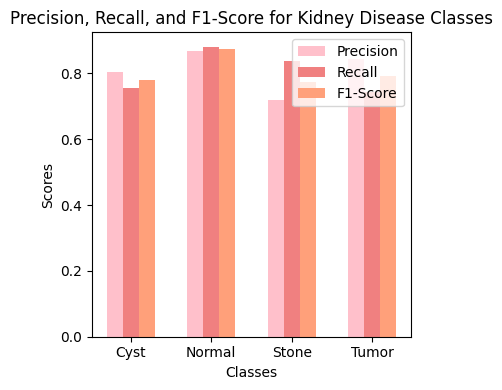

In [ ]:
import numpy as np
rpt = classification_report(actual, predicted, target_names=['Cyst', 'Normal', 'Stone', 'Tumor'], output_dict=True)

# Extract precision, recall, and f1-score for each class
labels = ['Cyst', 'Normal', 'Stone', 'Tumor']
precision = [rpt['Cyst']['precision'], rpt['Normal']['precision'], rpt['Stone']['precision'], rpt['Tumor']['precision']]
recall = [rpt['Cyst']['recall'], rpt['Normal']['recall'], rpt['Stone']['recall'], rpt['Tumor']['recall']]
f1_score = [rpt['Cyst']['f1-score'], rpt['Normal']['f1-score'], rpt['Stone']['f1-score'], rpt['Tumor']['f1-score']]

# Set up bar positions and width
x = np.arange(len(labels))
width = 0.2  # Width of bars

# Plotting precision, recall, and f1-score
fig, ax = plt.subplots(figsize=(4, 4))

# Bar plots
ax.bar(x - width, precision, width, label='Precision', color='pink')
ax.bar(x, recall, width, label='Recall', color='lightcoral')
ax.bar(x + width, f1_score, width, label='F1-Score', color='lightsalmon')

# Add labels, title, and custom ticks
ax.set_xlabel('Classes')
ax.set_ylabel('Scores')
ax.set_title('Precision, Recall, and F1-Score for Kidney Disease Classes')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()

# Show plot
plt.tight_layout()
plt.show()

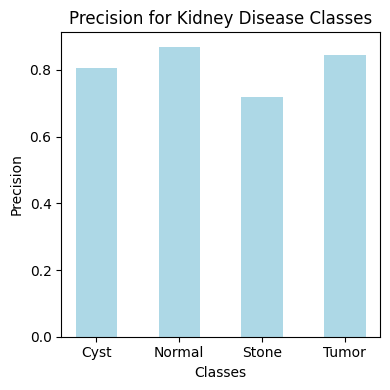

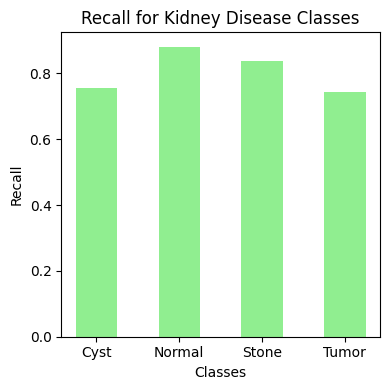

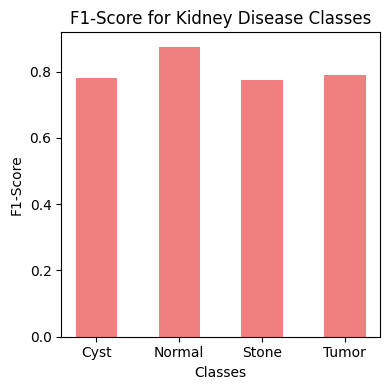

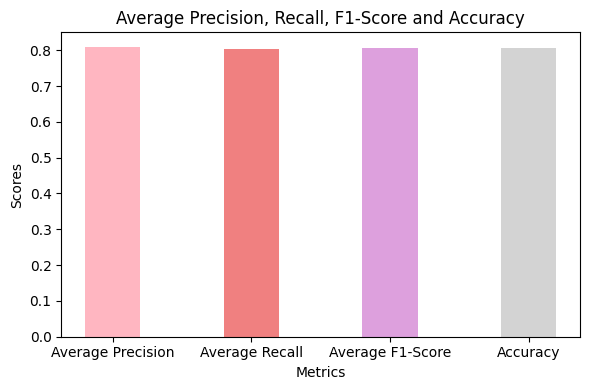

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, accuracy_score

# Assume `actual` and `predicted` are already defined
rpt = classification_report(actual, predicted, target_names=['Cyst', 'Normal', 'Stone', 'Tumor'], output_dict=True)

# Extract precision, recall, and f1-score for each class
labels = ['Cyst', 'Normal', 'Stone', 'Tumor']
precision = [rpt['Cyst']['precision'], rpt['Normal']['precision'], rpt['Stone']['precision'], rpt['Tumor']['precision']]
recall = [rpt['Cyst']['recall'], rpt['Normal']['recall'], rpt['Stone']['recall'], rpt['Tumor']['recall']]
f1_score = [rpt['Cyst']['f1-score'], rpt['Normal']['f1-score'], rpt['Stone']['f1-score'], rpt['Tumor']['f1-score']]

# Calculate average and accuracy
avg_precision = rpt['macro avg']['precision']
avg_recall = rpt['macro avg']['recall']
avg_f1_score = rpt['macro avg']['f1-score']
overall_accuracy = accuracy_score(actual, predicted)

# X positions for bar plots
x = np.arange(len(labels))
width = 0.5  # Width of bars

# Function to create separate bar graphs
def create_bar_plot(metric, values, title, color):
    fig, ax = plt.subplots(figsize=(4, 4))
    ax.bar(x, values, width, label=metric, color=color)

    # Add labels, title, and custom ticks
    ax.set_xlabel('Classes')
    ax.set_ylabel(metric)
    ax.set_title(f'{title} for Kidney Disease Classes')
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    plt.tight_layout()
    plt.show()

# Precision plot
create_bar_plot('Precision', precision, 'Precision', 'lightblue')

# Recall plot
create_bar_plot('Recall', recall, 'Recall', 'lightgreen')

# F1-Score plot
create_bar_plot('F1-Score', f1_score, 'F1-Score', 'lightcoral')

# Overall average precision, recall, f1-score, and accuracy
metrics = ['Average Precision', 'Average Recall', 'Average F1-Score', 'Accuracy']
values = [avg_precision, avg_recall, avg_f1_score, overall_accuracy]
colors = ['lightpink', 'lightcoral', 'plum', 'lightgray']

# Average and accuracy plot
fig, ax = plt.subplots(figsize=(6, 4))
ax.bar(metrics, values, width=0.4, color=colors)

# Add labels, title
ax.set_xlabel('Metrics')
ax.set_ylabel('Scores')
ax.set_title('Average Precision, Recall, F1-Score and Accuracy')
plt.tight_layout()
plt.show()


In [ ]:
print(classification_report(actual, predicted))

              precision    recall  f1-score   support

        Cyst       0.80      0.76      0.78       600
      Normal       0.87      0.88      0.87       663
       Stone       0.72      0.84      0.77       600
       Tumor       0.84      0.74      0.79       600

    accuracy                           0.81      2463
   macro avg       0.81      0.80      0.81      2463
weighted avg       0.81      0.81      0.81      2463



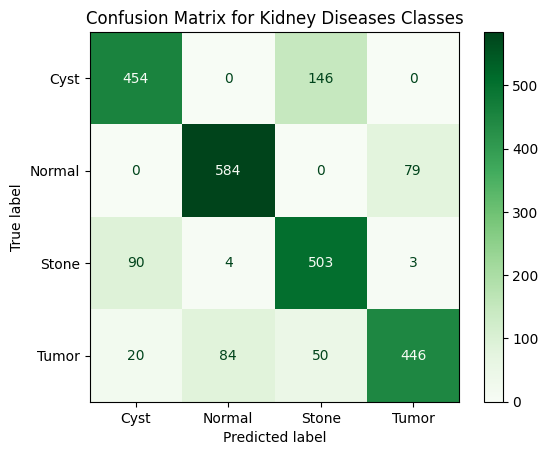

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Convert lists to numpy arrays
npredicted_classes = np.array(actual)
nactual_classes = np.array(predicted)

# Get unique class names from actual_classes
class_names = np.unique(actual)

# Compute confusion matrix
cm = confusion_matrix(actual, predicted, labels=class_names)

# Display confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Greens, values_format='d')  # Use 'd' to display integer values
plt.title('Confusion Matrix for Kidney Diseases Classes')
plt.show()


Confusion Matrix:
 [[454   0 146   0]
 [  0 584   0  79]
 [ 90   4 503   3]
 [ 20  84  50 446]]


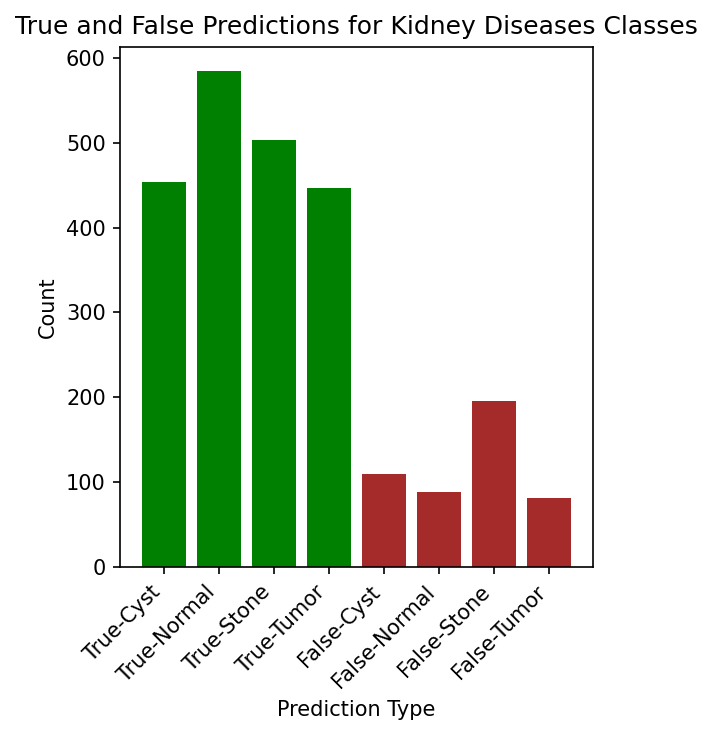

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

# Assume test_true and test_preds are the true labels and predicted labels respectively
# Define class names based on the labels present in test_true and test_preds
class_names = np.unique(np.concatenate((actual, predicted)))

# Compute confusion matrix
cm = confusion_matrix(actual, predicted, labels=class_names)
print("Confusion Matrix:\n", cm)

# Extract counts from confusion matrix
true_positives = np.diag(cm)
false_positives = cm.sum(axis=0) - true_positives
false_negatives = cm.sum(axis=1) - true_positives

# Prepare data for bar graph
labels = [f'True-{cls}' for cls in class_names] + [f'False-{cls}' for cls in class_names]
counts = list(true_positives) + list(false_positives)

# Plot bar graph
plt.figure(figsize=(4, 5), dpi=150)
bars = plt.bar(labels, counts, color=['green']*len(class_names) + ['brown']*len(class_names))
plt.title('True and False Predictions for Kidney Diseases Classes')
plt.xlabel('Prediction Type')
plt.ylabel('Count')

# Add value labels on bars
for bar in bars:
    yval = bar.get_height()
    #plt.text(bar.get_x() + bar.get_width()/2.0, yval, int(yval), va='bottom')

plt.xticks(rotation=45, ha='right')
plt.tight_layout()
#plt.savefig('prediction_counts.png')
plt.show()

In [ ]:
import numpy as np

# Define the mapping
label_mapping = {'Cyst':0, 'Normal':1, 'Stone':2, 'Tumor':3}
['Cyst', 'Normal', 'Stone', 'Tumor']
nactual = np.array([label_mapping[label] for label in actual])
npredicted = np.array([label_mapping[label] for label in predicted])

In [ ]:
npredicted

array([0, 0, 0, ..., 3, 3, 3])

In [ ]:
import numpy as np
from sklearn.metrics import mean_absolute_error

# Convert lists to numpy arrays
nnactual_classes = np.array(nactual)
nnpredicted_classes = np.array(npredicted)

# Compute Mean Absolute Error
mae = mean_absolute_error(nnactual_classes, nnpredicted_classes)

print(f"Mean Absolute Error (MAE): {mae:.4f}")

Mean Absolute Error (MAE): 0.3715


In [ ]:
import numpy as np
from sklearn.metrics import matthews_corrcoef



# Compute Matthews Correlation Coefficient
mcc = matthews_corrcoef(actual, predicted)

print(f"Matthews Correlation Coefficient (MCC): {mcc:.4f}")

Matthews Correlation Coefficient (MCC): 0.7435


In [ ]:
#6. Cohen’s Kappa
#ECohen’s Kappa measures the agreement between observed and predicted classifications while accounting for chance.
from sklearn.metrics import cohen_kappa_score

kappa = cohen_kappa_score(actual, predicted)
print(f"Cohen’s Kappa: {kappa:.4f}")

Cohen’s Kappa: 0.7421


In [ ]:
#9. Hamming Loss
#Hamming Loss measures the fraction of labels that are incorrectly predicted.
from sklearn.metrics import hamming_loss

hamming = hamming_loss(actual, predicted)
print(f"Hamming Loss: {hamming:.4f}")


Hamming Loss: 0.1933


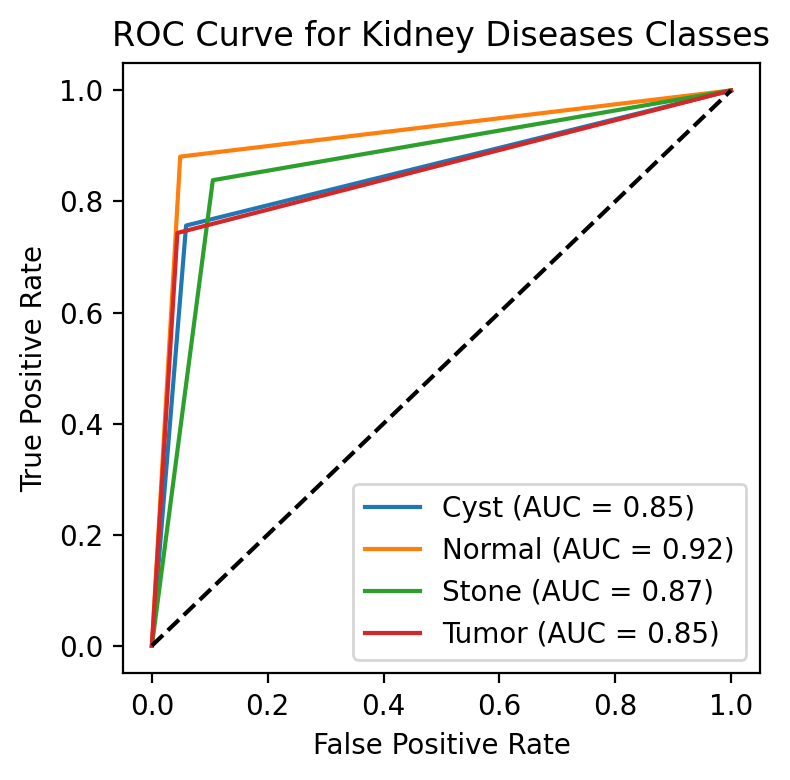

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from sklearn.metrics import RocCurveDisplay


# Define the classes
classes = ['Cyst', 'Normal', 'Stone', 'Tumor']

# Binarize the actual and predicted labels
y_actual = label_binarize(actual, classes=classes)
y_pred = label_binarize(predicted, classes=classes)

# Initialize a figure for the ROC curve
plt.figure(figsize=(4, 4), dpi=200)

# Compute ROC curve and AUC for each class
for i in range(len(classes)):
    fpr, tpr, _ = roc_curve(y_actual[:, i], y_pred[:, i])
    roc_auc = auc(fpr, tpr)

    # Plot ROC curve for each class
    plt.plot(fpr, tpr, label=f'{classes[i]} (AUC = {roc_auc:.2f})')

# Plot the diagonal line for a random classifier
plt.plot([0, 1], [0, 1], 'k--')

# Add labels, title, and legend
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Kidney Diseases Classes')
plt.legend(loc='lower right')

# Show plot
plt.tight_layout()
plt.show()


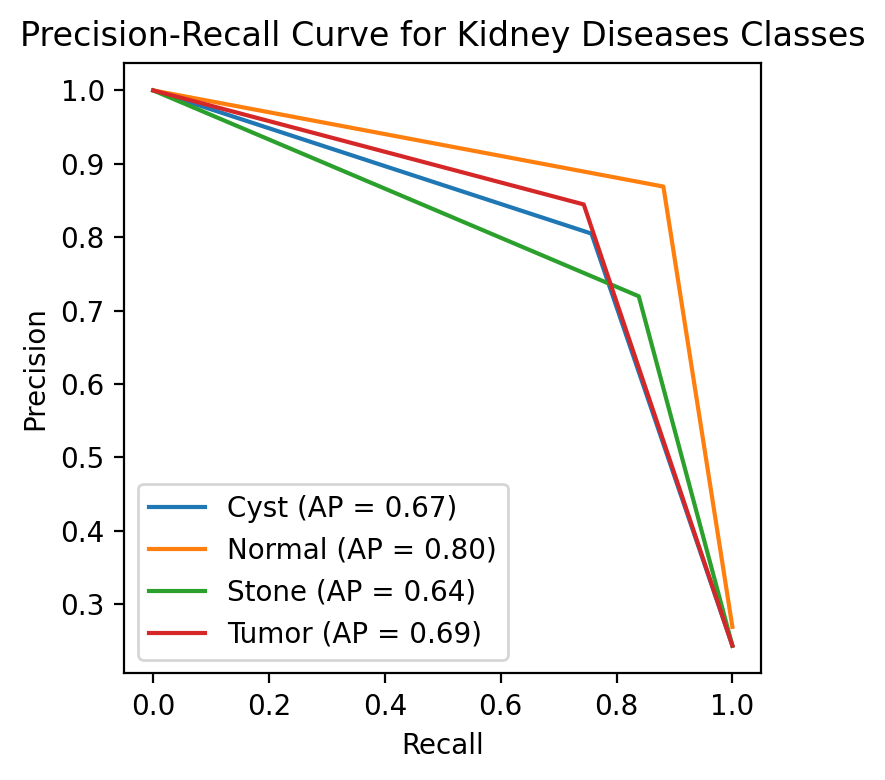

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.preprocessing import label_binarize


# Define the classes
classes = ['Cyst', 'Normal', 'Stone', 'Tumor']

# Binarize the actual and predicted labels
y_actual = label_binarize(actual, classes=classes)
y_pred = label_binarize(predicted, classes=classes)

# Initialize a figure for the Precision-Recall curve
plt.figure(figsize=(4, 4),dpi=200)

# Compute Precision-Recall curve and average precision for each class
for i in range(len(classes)):
    precision, recall, _ = precision_recall_curve(y_actual[:, i], y_pred[:, i])
    avg_precision = average_precision_score(y_actual[:, i], y_pred[:, i])

    # Plot Precision-Recall curve for each class
    plt.plot(recall, precision, label=f'{classes[i]} (AP = {avg_precision:.2f})')

# Add labels, title, and legend
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve for Kidney Diseases Classes')
plt.legend(loc='lower left')

# Show plot
plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
df1 = pd.DataFrame({
    'ImageName': imageName,
    'ActualClass': actual,
    'PredictedClass': predicted
})

# Save the DataFrame to CSV
df1.to_csv('/content/drive/MyDrive/braintumer/output/results4Classes.csv', index=False)

print("CSV file saved as 'results.csv'")


CSV file saved as 'results.csv'


In [ ]:
cm

array([[454,   0, 146,   0],
       [  0, 584,   0,  79],
       [ 90,   4, 503,   3],
       [ 20,  84,  50, 446]])